# World Data League 2023

## Notebook Submission

## Table of contents:
Below are some hyperlinks for specific interesting sections, however in each section more information will be provided as you scroll down
1. [Challenge](#challenge):
  *   [Goal](#goal)
  *   [Outcome](#outcome)
2. [Team info](#team_info)
3. [Proposed product](#proposed_product)
4. [Development](#development):
  * [Define parameters](#define_parameters)
  * [Define helper functions](#define_helpers)
  * [Load data](#load_data)
  * [Data wrangling](#data_wrangling):
    * [Joining datasets](#joining_data)
    * [Handling nulls](#handling_nulls)
    * [Engineering additonal features](#additional_features)
  * [Exploratory data analysis](#exploratory_data_analysis):
    * [Geo Plots](#geo_plots)
    * [Energy production by population](#production_by_population)
    * [Interactive plots](#interactive_plots)
  * [Feature selection](#feature_selection):
    * [PCA](#pca)
    * [Factor loadings and correlation](#correlation)
    * [Feature selection reasoning](#feature_reasoning)
  * [Modelling](#modelling)
    * [Rules + spatial clustering](#rules_spatial)
    * [Spatial optimisation](#spatial_optimisation)
    * [Reinforcement Learning](reinforcement_learning)
  * [Interpretability](#interpretability)
  * [Fairness](#fairness)
5. [Visualisations](#visualisations)
6. [References](#references)
7. [Appendix](#appendix)




## 🎯 Challenge <a name ='challenge'></a>
**Phase 3 - Energy communities inclusive of residents vulnerable to energy poverty**

[Challenge Brief](https://docs.google.com/document/d/1ItCr9eTsoFZ5pmeasO2F6NJGkAzRkj5uQhIEooYHw9s/edit)

### 🥅 Goal <a name ='goal'></a>

The goal of this challenge is to leverage the existing data to propose how energy communities could be formed in the city of Ghent with a special focus on including residents vulnerable to energy poverty.

### ✅ Outcome <a name ='outcome'></a>

Create an optimization algorithm that proposes potential energy communities in the city of Ghent. The algorithm needs to take into consideration potential and existing sites for renewable energy production, energy consumption and inclusivity to residents vulnerable to energy poverty. The algorithm also should be scalable to account for potential future restrictions on the size of energy communities or geographical proximity between members. Ideally the solution would be scalable to other cities as well where similar data has been collected.

## Team: Bayes Bunch <a name ='team_info'></a>
## 👥 Authors <a name ='authors'></a>
* Samantha Hakes
* Mitra Ganeson
* Zhen-Yen Chan
* Stuart McGibbon
* Roisin Holmes

## Proposed product <a name ='proposed_product'></a>

Our proposed product is two-fold:
1. An open source Data Science repository to aid in proposing potential energy communities, using an opimitisation algoritmn. This can be generalised to other datasets to make it more scalable, but in this specific notebook we use the data for the city of Ghent. This repository contains a config file for parameters as well as .py files with useful functions. You can find this on github [here](https://github.com/StuartJMc/ecomapper).
2. A dashboard that can be used as a visualisation tool to allow people to pitcure where the energy communites should be. This can also be adjusted for different parameters.



## 💻 Development <a name ='development'></a>


Since we are developing a Data Science repository as part of our product, we chose to structure our project by creating a config.yaml to define parameters for the problem and helper functions to model the problem in .py files. This is an example of best practice when it comes to coding, by modularising it for re-usability. Therefore our code should be reausable for future developments or for different regions.

By creating a config.yaml file for the parameters this should be easily editible for our users. An example of this and the helper functions can be found in our github repository.

For the purpose of this notebok, we have defined the config.yaml parameters using a dictionary, and have listed the generalised functions below (and how we would group them into different modules - .py files).

You can find the how we have defined the parameters [here](#define_parameters) and helper functions in the section [here](#define_helpers). However, if you want to skip to the reading in of the data and the main development using the functions, you can direct yourself to [here](#load_data). We have included hyperlinks to the functions when we have used them if you would like to understand what they are meant to do.

### Define Parameters <a name ='define_parameters'></a>

In the project structure, this would be defined in the config.yaml file to make them easily editable for users. However, for the purposes of this notebook, we will define them in a dictionary



In [ ]:
# create empty dictionary
config = {}

In [ ]:
# define the parameters
config["Params"] = {
    "crs_address": 3812,
    "crs_sectors": 31370,
    "electricity_price": 0.3377,
    "gas_price": 0.0939,
    "green_energy_ratio": 0.2147,
    "municipality": "Gent",
    "sector_id_prefix": "44021",
    "solar_panel_cost_per_m2": 289,
    "year": "2019-01-01",
    "zip_codes": [
        "9000",
        "9030",
        "9031",
        "9032",
        "9040",
        "9041",
        "9042",
        "9050",
        "9051",
        "9052",
    ],
}

In [ ]:
# define the file paths
config["Paths"] = {
    "address_path": "../data/gent_street_addresses.parquet",
    "average_income_path": "../data/income-with-sector-codes.csv",
    "bimd_path": "../data/BIMD/BIMD2011_DOMAINS_STATISTICAL_SECTOR_ELLIS_WIDE.csv",
    "energy_consumption_path": "../data/ghent_data/energy_consumption_street_level.csv",
    "energy_decentral_production_path": "../data/ghent_data/energy_decentral_production.csv",
    "ev_points_path": "../data/ghent_data/ev_points.csv",
    "rent_prices_path": "../data/ghent_data/ghent_rent_prices.csv",
    "sector_boundaries_path": "../data/sh_statbel_statistical_sectors_31370_lastversion.geojson/sh_statbel_statistical_sectors_31370_20220101.geojson/sh_statbel_statistical_sectors_31370_20220101.geojson",
    "solar_path": "../data/ghent_data/pv_data/Gent_SOL_v3.shp",
    "stat_sector_mapping_path": "../data/be-dictionary.csv",
    "stat_sector_populations": "../data/OPENDATA_SECTOREN_2022.xlsx",
    "urban_atlas_path": "../data/land_use/BE003L2_GENT_UA2012.shp",
}

In [ ]:
# define columns used
config["Columns"] = {
    "feature_columns": [
        "exp_score_income_domain",
        "rank_income_domain",
        "deciles_income_domain",
        "exp_score_employment_domain",
        "rank_employment_domain",
        "deciles_employment_domain",
        "exp_score_edu_domain",
        "rank_edu_domain",
        "deciles_edu_domain",
        "exp_score_hous_domain",
        "rank_hous_domain",
        "deciles_hous_domain",
        "exp_score_health_domain",
        "rank_health_domain",
        "BIMD2011_score",
        "BIMD2011_rank",
        "BIMD2011_deciles_domain",
        "address_id",
        "avg_net_tax_income",
        "installation_max_power",
        "power_capacity",
        "annual_energy_use_electricity_offtake",
        "annual_energy_use_natural_gas_offtake",
        "number_access_points_electricity_offtake",
        "number_access_points_natural_gas_offtake",
        "building_type",
        "building_cat",
        "building_surface_area",
        "building_length",
        "solar_opportunity_area",
        "solar_opportunity_3d",
        "solar_irradiation",
        "total_solar_irradiation",
        "energy_production",
        "solar_id",
        "solar_to_address_distance",
        "top_10_per_energy_prod_in_500m",
    ],
    "geometry_columns": ["geometry", "coordinates", "geometry_building", "centroid"],
    "info_columns": [
        "exp_score_income_domain",
        "rank_income_domain",
        "deciles_income_domain",
        "exp_score_employment_domain",
        "rank_employment_domain",
        "deciles_employment_domain",
        "exp_score_edu_domain",
        "rank_edu_domain",
        "deciles_edu_domain",
        "exp_score_hous_domain",
        "rank_hous_domain",
        "deciles_hous_domain",
        "exp_score_health_domain",
        "rank_health_domain",
        "BIMD2011_score",
        "BIMD2011_rank",
        "BIMD2011_deciles_domain",
        "avg_net_tax_income",
        "installation_max_power",
        "power_capacity",
        "annual_energy_use_electricity_offtake",
        "annual_energy_use_natural_gas_offtake",
        "number_access_points_electricity_offtake",
        "number_access_points_natural_gas_offtake",
    ],
    "location_columns": [
        "sector_code",
        "postcode",
        "sector",
        "housenumber",
        "boxnumber",
        "id",
        "year",
        "status",
        "status_valid_from",
        "streetname",
        "lat",
        "lon",
        "lat_solar",
        "lon_solar",
        "address_id",
    ],
    "selected_columns": [
        "energy_production",
        "building_cat",
        "building_length",
        "solar_to_address_distance",
        "annual_energy_use_natural_gas_offtake",
        "BIMD2011_score",
        "top_10_per_energy_prod_in_500m",
        "power_capacity",
        "avg_net_tax_income",
    ],
    "solar_columns": [
        "building_type",
        "building_cat",
        "building_surface_area",
        "building_length",
        "solar_opportunity_area",
        "solar_opportunity_3d",
        "solar_irradiation",
        "total_solar_irradiation",
        "solar_id",
        "energy_production",
        "solar_to_address_distance",
    ],
}

### Defining helper functions <a name ='define_helpers'></a>
You can find the specific .py and .yaml files in our github repo [here](https://github.com/StuartJMc/ecomapper), however we have grouped the functions below.

**Note** Please reduce if you only wish to view the main part of the documentations. Or you can skip to loading in the data [here](#load_data).

#### <u>helpers - feature_eng.py:</u>
This module contains functions for importing the different datasets we used for Ghent, and therefore helps us create features for the optimisation. The associated data will be explained in the data import section [here](#data_section)

In [ ]:
!pip install contextily

In [ ]:
!pip install tf_agents[reverb]

In [ ]:
! pip install geopandas

In [ ]:
# Imports needed for this .py file:
import pandas as pd
import geopandas as gpd
import numpy as np
import functools as ft
from shapely.geometry import LineString, Point, Polygon
import yaml

# If using the config we would load the configuration file like so:
# with open("../config.yaml") as file:
#     config = yaml.safe_load(file)

**get_energy_consumption:** <a name ='get_energy_consumption'></a>

In [ ]:
# Dataset 1
def get_energy_consumption(
    data_path=config["Paths"]["energy_consumption_path"],
    year=config["Params"]["year"],
    municipality=config["Params"]["municipality"],
):
    df = pd.read_csv(data_path, delimiter=";")

    df = df.rename(
        columns={
            "Verbruiksjaar": "year",
            "Hoofdgemeente": "municipality",
            "Energie": "consumption_type",
            "Richting": "energy_flow",
            "Straat": "street",
            "Aantal Toegangspunten": "number_access_points",
            "Benaderend verbruik (kWh)": "annual_energy_use",
        }
    )

    # translate headings
    df["consumption_type"] = df.consumption_type.replace(
        {"Elektriciteit": "electricity", "Aardgas": "natural_gas"}
    )
    df["energy_flow"] = df.energy_flow.replace(
        {"Afname": "offtake", "Injectie": "injection"}
    )

    # convert year to datetime
    df["year"] = pd.to_datetime(df["year"], format="%Y")

    # select only gent data
    df = df[df["municipality"] == municipality.upper()].reset_index()

    # put street names in lower case
    df.street = df.street.str.lower()

    # Take just 2013 data
    df = df[df.year == year]

    # drop unessecary columns
    df = df.drop(columns=["Regio", "index"])

    # pivot so that energy types and flows are seperated
    df = df.pivot_table(
        index="street",
        columns=["consumption_type", "energy_flow"],
        values=["annual_energy_use", "number_access_points"],
    ).reset_index()

    # Reset column names
    df.columns = df.columns.map("_".join)

    df.rename(columns={"street__": "street"}, inplace=True)

    df.drop(
        columns=[
            "annual_energy_use_electricity_injection",
            "number_access_points_electricity_injection",
        ],
        inplace=True,
    )

    return df

**get_ev_points:** <a name ='get_ev_points'></a>

In [ ]:
# Dataset 2
def get_ev_points(
    data_path=config["Paths"]["ev_points_path"], zip_codes=config["Params"]["zip_codes"]
):
    df = pd.read_csv(data_path, delimiter=";")

    # Translate headings
    df = df.rename(
        columns={
            "Jaartal indienstname": "installation_year",
            "Postcode": "postcode",
            "Vermogen (kVA)": "installation_max_power",
            "Spanningsniveau aansluiting": "voltage_level",
        }
    )
    # Drop unessecary columns
    df = df.drop(
        columns=[
            "Postcode (hiërarchisch)",
            "Uniek_order_ID",
            "Postcode Numeriek",
        ]
    )
    # Add clearer values for voltage level
    df["voltage_level"] = df.voltage_level.replace(
        {"LS": "low_voltage", "MS": "medium_voltage"}
    )

    # convert year to datetime
    df["installation_year"] = pd.to_datetime(df["installation_year"], format="%Y")

    # convert postcode to string
    df["postcode"] = df["postcode"].astype("str")

    # Extract lat and lon from centroid
    df["lat"] = df["centroid"].str.split(",").str[0]
    df["lon"] = df["centroid"].str.split(",").str[1]
    df.drop(columns=["centroid"], inplace=True)

    ## Take only gent postcodes
    df = df[df["postcode"].isin(zip_codes)]

    ## Locations are the same for all rows in a postcode, so drop duplicates by aggregating installation power
    df = df.groupby(["postcode"]).agg({"installation_max_power": "sum"}).reset_index()

    return df

**get_energy_decentral_production:** <a name ='get_energy_decentral_production'></a>

In [ ]:
# Dataset 3
def get_energy_decentral_production(
    data_path=config["Paths"]["energy_decentral_production_path"],
    zip_codes=config["Params"]["zip_codes"],
):
    df = pd.read_csv(data_path, delimiter=";")

    # Translate headings
    df = df.rename(
        columns={
            "Jaartal indienstname": "installation_date",
            "Type technologie": "technology_type",
            "Vermogen (kVA)": "power_capacity",
            "Gemeente Nis Code": "municipality_code",
            "Spanningsniveau aansluiting": "voltage_level",
            "Postcode": "postcode",
        }
    )

    # Drop unessecary columns
    df = df.drop(
        columns=["Postcode (hiërarchisch)", "Uniek_order_ID", "municipality_code"]
    )

    # Add clearer values for voltage level and technology type
    df["voltage_level"] = df.voltage_level.replace(
        {"LS": "low_voltage", "MS": "medium_voltage"}
    )
    df["technology_type"] = df.technology_type.replace(
        {
            "Zonne-Energie (PV)": "solar",
            "Windenergie": "wind",
            "Andere": "others",
            "WKK Aardgas": "natural_gas",
            "Brandstofcel": "fuel_cell",
            "WKK Biomassa/Biogas": "Biomass/Biogas",
        }
    )
    # only take solar
    df = df[df.technology_type == "solar"]
    df.drop(columns=["technology_type"], inplace=True)

    # conert postcode to string
    df["postcode"] = df["postcode"].astype(str).str[0:4]

    # convert year to datetime
    df["installation_date"] = pd.to_datetime(df["installation_date"], format="%Y")

    # fill na with 0 (assumption that na relates to no reading)
    df["power_capacity"] = df.power_capacity.fillna(0)
    df["installation_date"] = df.installation_date.fillna(df.installation_date.max())
    df["voltage_level"] = df.voltage_level.fillna("unknown")

    ## filter down using postcode to only gent postcodes
    df = df[df.postcode.isin(zip_codes)]

    ## Locations are the same for all rows in a postcode, so drop duplicates by aggregating power capacity (only solar is included but will aggregate anyway in case more are added)
    df = df.groupby(["postcode"]).agg({"power_capacity": "sum"}).reset_index()

    return df

**get_average_income:** <a name ='get_average_income'></a>

In [ ]:
# Dataset 4
def get_average_income(
    data_path=config["Paths"]["average_income_path"],
    sector_code_prefix=config["Params"]["sector_id_prefix"],
):
    df = pd.read_csv(data_path, delimiter=";")

    df.columns = [
        "sector",
        "sector_code",
        "total_net_taxable_income",
        "interquartile_coeff_of_taxpayers",
        "interquartile_asymmetry_of_taxpayers",
        "avg_net_tax_income",
    ]

    # add sector_code_preffix to sector_code
    df["sector_code"] = sector_code_prefix + df["sector_code"].astype(str)

    # add a training '- to any sector_code that is 8 digits long
    df["sector_code"] = df["sector_code"].apply(lambda x: x + "-" if len(x) == 8 else x)

    # replace all x with np.nan
    df.replace("x", np.nan, inplace=True)

    # convert columns to float
    df[
        [
            "total_net_taxable_income",
            "interquartile_coeff_of_taxpayers",
            "interquartile_asymmetry_of_taxpayers",
            "avg_net_tax_income",
        ]
    ] = (
        df[
            [
                "total_net_taxable_income",
                "interquartile_coeff_of_taxpayers",
                "interquartile_asymmetry_of_taxpayers",
                "avg_net_tax_income",
            ]
        ]
        .copy()
        .astype(float)
    )

    df.drop(columns=["sector"], inplace=True)

    return df

**get_rent_prices:** <a name ='get_rent_prices'></a>

In [ ]:
# Dataset 5
def get_rent_prices(data_path=config["Paths"]["rent_prices_path"]):
    df = pd.read_csv(data_path, delimiter=",")

    # Drop unessecary columns
    df = df.drop(
        columns=["Unnamed: 0", "country", "region", "province", "district", "locality"]
    )

    #  dropna coords
    df = df.dropna(subset=["lat", "long"])

    # convert datetyprd
    df["id"] = df["id"].astype("str")
    df["price_main_value"] = df["price_main_value"].astype("float")
    df["postal_code"] = df["postal_code"].astype("str")

    gdf = gpd.GeoDataFrame(df)
    # Convert latitude and longitude columns to geometry column
    gdf["geometry"] = gpd.points_from_xy(gdf["long"], gdf["lat"])

    # set street to lower case
    df["street"] = df["street"].str.lower()

    # rename columns
    df.rename(columns={"postal_code": "postcode"}, inplace=True)

    return gdf

**get_statistical_sector_mapping:** <a name ='get_statistical_sector_mapping'></a>

In [ ]:
# Dataset 6
def get_statistical_sector_mapping(
    data_path=config["Paths"]["stat_sector_mapping_path"],
    municipality=config["Params"]["municipality"],
):
    df_mapping = pd.read_csv(data_path)

    # extract postcode
    df_mapping["PostCode"] = df_mapping.PostCode.astype(str).str[:4]

    # use only gent postcodes
    df_mapping = df_mapping[df_mapping.Municipality == municipality]

    # drop duplicates
    df_mapping = df_mapping.drop_duplicates(subset=["StatisticalSector"])

    # make it low
    df_mapping["sector"] = df_mapping.StatisticalSector.str.lower().copy()
    df_mapping.drop(columns=["StatisticalSector"], inplace=True)

    # Drop the constant columns
    unique_counts = df_mapping.nunique()

    # Identify columns with 0 or 1 unique value
    columns_to_drop = unique_counts[unique_counts <= 1].index
    df_mapping = df_mapping.drop(columns_to_drop, axis=1)

    # rename postcode column
    df_mapping.rename(
        columns={"PostCode": "postcode", "NIS9": "sector_code"}, inplace=True
    )

    return df_mapping

**get_sector_boundaries:** <a name ='get_sector_boundaries'></a>

In [ ]:
# Dataset 7
def get_sector_boundaries(
    data_path=config["Paths"]["sector_boundaries_path"],
    crs=config["Params"]["crs_sectors"],
    municipality=config["Params"]["municipality"],
):
    gdf = gpd.read_file(data_path)

    # define current crs
    gdf = gdf.set_crs(epsg=crs)

    # set crs wo WGS84
    gdf = gdf.to_crs(epsg=4326)

    # Select only gent
    gdf = gdf[gdf["tx_munty_descr_nl"] == municipality]

    # keep only select cols
    gdf = gdf.copy()[["cd_sector", "geometry"]]
    gdf.rename(columns={"cd_sector": "sector_code"}, inplace=True)

    return gdf

**get_address_data:** <a name ='get_address_data'></a>

In [ ]:
# Dataset 8
def get_address_data(
    data_path=config["Paths"]["address_path"], crs=config["Params"]["crs_address"]
):
    df_address = pd.read_parquet(data_path)

    # lowercase street names
    df_address["streetname"] = df_address["streetname_nl"].str.lower()

    # Create a GeoDataFrame from the DataFrame
    geometry = [Point(xy) for xy in zip(df_address["x"], df_address["y"])]
    gdf_address = gpd.GeoDataFrame(df_address, geometry=geometry, crs="EPSG:3812")
    gdf_address = gdf_address.to_crs("EPSG:4326")

    # store seperately so not lost in the join
    gdf_address["coordinates"] = gdf_address["geometry"]
    # extract lat/lon coordinates
    gdf_address["lat"] = gdf_address.geometry.y
    gdf_address["lon"] = gdf_address.geometry.x

    # I think these columns are redundant (for now)
    cols_to_drop = [
        "fid",
        "id",
        "fed_address_id",
        "best_objectid",
        "best_versionid",
        "best_id",
        "position",
        "status_valid_from",
        "status",
        "begin_life_span_version",
        "officially_assigned",
        "postal_info_objectid",
        "streetname_objectid",
        "streetname_nl",
        "streetname_versionid",
        "x",
        "y",
    ]

    gdf_address.drop(cols_to_drop, axis=1, inplace=True)

    gdf_address["address_id"] = gdf_address.index
    return gdf_address

**get_solar_data:** <a name ='get_solar_data'></a>

In [ ]:
# Dataset 9
def get_solar_data(
    data_path=config["Paths"]["solar_path"],
    municipality=config["Params"]["municipality"],
):
    df_solar = gpd.read_file(data_path)

    # rename columns
    df_solar = df_solar.rename(
        columns={
            "GRB_UIDN": "building_iden",
            "GRB_OIDN": "building_object_iden",
            "ENTITEIT": "building_type",
            "TYPE": "building_type_code",
            "LBLTYPE": "building_cat",
            "DATUM_GRB": "geo_creation_date",
            "DATUM_LID": "mapping_date",
            "OPPERVL": "building_surface_area",
            "LENGTE": "building_length",
            "STRAATNMID": "street_id",
            "STRAATNM": "street_name",
            "NISCODE": "municipality_code",
            "GEMEENTE": "municipality",
            "POSTCODE": "post_code",
            "HNRLABEL": "building_number",
            "SOL_OPP": "solar_opportunity_area",
            "SOL_OPP_3D": "solar_opportunity_3d",
            "SLOPE": "roof_slope",
            "ASPECT": "roof_aspect",
            "IRR_SqM": "solar_irradiation",
            "IRR_Tot": "total_solar_irradiation",
            "Type_Dak": "roof_type",
            "Opwek_E": "energy_production",
        }
    )

    # rename building types and categories
    df_solar["building_type"] = df_solar.building_type.replace(
        {
            "Gbg": "building on ground",
            "Gba": "building attachment",
            "Knw": "works of art",
        }
    )
    df_solar["building_cat"] = df_solar.building_cat.replace(
        {
            "hoofdgebouw": "central building",
            "bijgebouw": "annex",
            "afdak": "shed",
            "verdieping": "floor",
            "silo, opslagtank": "silo",
            "uitbreiding": "extension",
            "gebouw afgezoomd met virtuele gevels": "Building lined with virtual facades",
            "schoorsteen": "chimney",
            "watertoren": "water tower",
        }
    )
    df_solar["roof_type"] = df_solar.roof_type.replace(
        {"hellend": "pitched", "plat": "flat"}
    )

    # convert location indicators to string
    df_solar["building_iden"] = df_solar["building_iden"].astype("str")
    df_solar["building_object_iden"] = df_solar["building_object_iden"].astype("str")
    df_solar["building_type_code"] = df_solar["building_type_code"].astype("str")
    df_solar["street_id"] = df_solar["street_id"].astype("str")
    df_solar["post_code"] = df_solar["post_code"].astype("str")

    # convert dates to datetime
    df_solar["geo_creation_date"] = pd.to_datetime(
        df_solar["geo_creation_date"], format="%Y-%m-%d"
    )
    df_solar["mapping_date"] = pd.to_datetime(
        df_solar["mapping_date"], format="%Y-%m-%d"
    )

    # lowercase street names
    df_solar["street_name"] = df_solar["street_name"].str.lower()

    # Select only municipality
    df_solar = df_solar[df_solar["municipality"] == municipality].reset_index()

    # Drop unnecessary columns
    df_solar = df_solar.drop(
        columns=[
            "index",
            "municipality_code",
            "municipality",
            "post_code",
            "street_id",
            "building_iden",
            "building_object_iden",
            "building_type_code",
            "geo_creation_date",
            "mapping_date",
            "roof_slope",
            "roof_aspect",
            "roof_type",
        ]
    )

    # convert to WGS84
    df_solar = df_solar.to_crs(epsg=4326)

    # get centroid (after converting geometry to meters)
    df_solar["centroid"] = (
        df_solar["geometry"].to_crs(epsg=3857).centroid.to_crs(epsg=4326)
    )

    # rename geometry
    df_solar.rename(columns={"geometry": "geometry_building"}, inplace=True)

    # use index for a unique identifier
    df_solar["solar_id"] = df_solar.index

    # extract lat/lon coordinates
    df_solar["lat_solar"] = df_solar.centroid.y
    df_solar["lon_solar"] = df_solar.centroid.x

    return df_solar

**get_bimd_data:** <a name ='get_bimd_data'></a>

In [ ]:
# Dataset 10
def get_bimd_data(
    data_path=config["Paths"]["bimd_path"],
    sector_prefix=config["Params"]["sector_id_prefix"],
):
    df_index = pd.read_csv(data_path, delimiter=",")

    # rename sector code
    df_index = df_index.rename(columns={"CD_RES_SECTOR": "sector_code"})

    # get only sector codes that start with sector_prefix
    df_index = df_index[df_index["sector_code"].str.startswith(sector_prefix)]

    # drop unnecessary columns (due to not enough geographical variance)
    df_index = df_index.drop(
        columns=[
            "exp_score_crime_domain",
            "rank_crime_domain",
            "deciles_health_domain",
            "deciles_crime_domain",
        ]
    )

    return df_index

**get_sector_population:** <a name ='get_sector_population'></a>

In [ ]:
# Dataset 11
def get_sector_population(data_path=config["Paths"]["stat_sector_populations"]):
    df_ss = pd.read_excel(data_path)

    df_ss = df_ss.drop(columns=["TX_DESCR_SECTOR_FR", "TX_DESCR_FR"])
    df_ss = df_ss.rename(
        columns={
            "CD_SECTOR": "sector_code",
            "TOTAL": "population",
            "TX_DESCR_NL": "municipality",
        }
    )
    df_ss = df_ss[["sector_code", "municipality", "population"]]
    df_ss_ghent = df_ss[df_ss["municipality"].str.contains("GENT", case=False)]

    df_ss = df_ss.drop(columns=["municipality"])

    return df_ss

**get_urban_atlas:** <a name ='get_urban_atlas'></a>

In [ ]:
# Dataset 12
def get_urban_atlas(data_path=config["Paths"]["urban_atlas_path"]):
    residential = [
        "Continuous urban fabric (S.L. : > 80%)",
        "Discontinuous dense urban fabric (S.L. : 50% -  80%)",
        "Discontinuous medium density urban fabric (S.L. : 30% - 50%)",
        "Discontinuous low density urban fabric (S.L. : 10% - 30%)",
        "Discontinuous very low density urban fabric (S.L. : < 10%)",
        "Isolated structures",
    ]

    other_consumers = [
        "Industrial, commercial, public, military and private units",
        "Sports and leisure facilities",
        "Arable land (annual crops)",
        "Port areas",
        "Mineral extraction and dump sites",
        "Railways and associated land",
        "Construction sites",
    ]

    df_land = gpd.read_file(data_path)

    # convert to WGS84
    df_land = df_land.to_crs("EPSG:4326")

    # lowercase all columns
    df_land.columns = map(str.lower, df_land.columns)

    df_land = df_land[["item2012", "geometry"]]

    # create new column with land use type
    df_land["land_use_type"] = df_land["item2012"].apply(
        lambda x: "residential"
        if x in residential
        else ("other_consumers" if x in other_consumers else np.nan)
    )

    return df_land

#### <u>helpers - data_prep.py:</u>
This module contains all functions prepping additional features. Some of these are specific to the datasets we are using

In [ ]:
# Imports in this .py file:

import pandas as pd
import geopandas as gpd
import numpy as np
import functools as ft
from shapely.geometry import LineString, Point, Polygon

# from helpers.feature_eng import (
#     get_energy_consumption,
#     get_ev_points,
#     get_energy_decentral_production,
#     get_average_income,
#     get_rent_prices,
#     get_address_data,
#     get_sector_boundaries,
#     get_statistical_sector_mapping,
#     get_bimd_data,
#     get_solar_data,
#     get_sector_population,
#     get_urban_atlas,
# )
import yaml

# Load the existing YAML file
# with open("../config.yaml", "r") as yaml_file:
#     config = yaml.safe_load(yaml_file)

**update_feature_column_config**<a name ='update_feature_column_config'></a>
This is not used in our code below, but was used to update the config file, as you can see we have listed the columns such as locations_columns and geometry_columns as part of the parameter input above

In [ ]:
def update_feature_column_config(df, config):
    geometry_columns = [col for col in df.columns if df[col].dtype.name == "geometry"]
    config["Columns"]["geometry_columns"] = geometry_columns

    location_columns = [
        "sector_code",
        "postcode",
        "sector",
        "housenumber",
        "boxnumber",
        "id",
        "year",
        "status",
        "status_valid_from",
        "streetname",
        "lat",
        "lon",
        "lat_solar",
        "lon_solar",
        "address_id",
    ]
    config["Columns"]["location_columns"] = location_columns

    # taken mannually, may need to update
    solar_columns = [
        "building_type",
        "building_cat",
        "building_surface_area",
        "building_length",
        "solar_opportunity_area",
        "solar_opportunity_3d",
        "solar_irradiation",
        "total_solar_irradiation",
        "solar_id",
        "energy_production",
        "top_10_per_energy_prod_in_500m",
    ]

    config["Columns"]["solar_columns"] = solar_columns

    features = [
        col
        for col in df.columns
        if col not in geometry_columns and col not in location_columns
    ]
    config["Columns"]["features_columns"] = features

    info_columns = [col for col in features if col not in solar_columns]
    config["Columns"]["info_columns"] = info_columns

    return config

**handle_missing_values**<a name ='handle_missing_values'></a>

In [ ]:
def handle_missing_values(df):
    # fill missing solar columns which are objects with 'not_available'
    solar_object_columns = (
        df[config["Columns"]["solar_columns"]].select_dtypes(include=["object"]).columns
    )
    df[solar_object_columns] = (
        df[solar_object_columns].fillna("not_available").astype(str)
    )

    # drop rows where population is missing
    df = df.dropna(subset=["population"])

    # fill rest with unkown
    object_columns = df.select_dtypes(include=["object"]).columns
    df[object_columns] = df[object_columns].fillna("unknown").astype(str)

    # fill solar number columns with 0
    solar_number_columns = (
        df[config["Columns"]["solar_columns"]].select_dtypes(include=["number"]).columns
    )
    df[solar_number_columns] = df[solar_number_columns].fillna(0).astype(float)

    # fill number columns not in solar with mean of their streetname
    number_columns = df.select_dtypes(include=["number"]).columns
    number_columns = [col for col in number_columns if col not in solar_number_columns]
    df[number_columns] = df.groupby("streetname")[number_columns].transform(
        lambda x: x.fillna(x.mean())
    )

    # fill remainder of number columns with mean from their sector
    df[number_columns] = df.groupby("sector")[number_columns].transform(
        lambda x: x.fillna(x.mean())
    )

    # fill remainder of number columns with mean from their postcode
    df[number_columns] = df.groupby("postcode")[number_columns].transform(
        lambda x: x.fillna(x.mean())
    )

    # fill remainder of number columns with mean from their city
    df[number_columns] = df[number_columns].fillna(df[number_columns].mean())

    return df

**recursive_nearest_join**<a name ='recursive_nearest_join'></a>

In [ ]:
def recursive_nearest_join(
    df_base, df_solar, join_attempts=3, max_distance=20, verbose=False
):
    joined_ids = []
    joined_solar_ids = []

    df_target = pd.DataFrame()
    for attempt in range(join_attempts):
        if attempt != 0:
            df_base_subset = df_base[~df_base.index.isin(joined_ids)]
            df_solar_subset = df_solar[~df_solar.solar_id.isin(joined_solar_ids)]
        else:
            df_base_subset = df_base.copy()
            df_solar_subset = df_solar.copy()
        # join with s_join nearest
        dfs = [df_base_subset, df_solar_subset]
        df_base_sjoin_nearest = ft.reduce(
            lambda left, right: gpd.sjoin_nearest(
                left,
                right,
                how="inner",
                max_distance=max_distance,
                distance_col="solar_to_address_distance",
            ),
            dfs,
        )

        # Take only the rows for the same solar panel id that has the shortest distance
        df_base_sjoin_nearest = df_base_sjoin_nearest.sort_values(
            "solar_to_address_distance"
        ).drop_duplicates(subset=["solar_id"], keep="first")
        joined_ids = joined_ids + df_base_sjoin_nearest.index.to_list()
        joined_solar_ids = joined_solar_ids + list(
            df_base_sjoin_nearest.solar_id.unique()
        )

        df_target = pd.concat([df_target, df_base_sjoin_nearest])

    if verbose:
        # find the % of unique solar panels within 20 meters out of the total non null ids
        unique_solar_panels = len(
            df_target[df_target["solar_to_address_distance"] <= max_distance]
            .groupby(["solar_id"])
            .count()
        )

        print(
            f"Number of unique solar panel ids before join: {df_solar.solar_id.nunique()}"
        )
        print(f"The number of rows joins {df_target.shape[0]}")
        print(
            f"Number of solar panels within {max_distance} meters: {len(df_target[df_target['solar_to_address_distance'] <= max_distance])}"
        )
        print(
            f"Number of unique solar Ids under {max_distance}m: {unique_solar_panels}, as a percentage of the solar data: {round(unique_solar_panels/df_solar.solar_id.nunique()*100,2)}%"
        )

    return df_target

**generate_energy_proximity**<a name ='generate_energy_proximity'></a>

In [ ]:
def generate_energy_proximity(df_base, df_sol, buffer=500, top_percentile=0.1):
    df_base["address_id"] = df_base.index

    # take top 10% of solar buildings by energy production
    # trim down
    df_sol = df_sol.sort_values(by="energy_production", ascending=False).head(
        int(len(df_sol) * top_percentile)
    )
    df_sol = df_sol[["energy_production", "centroid"]].copy()

    # trim_down
    df = df_base[["address_id", "coordinates", "sector"]].copy()
    df["coordinates_meters"] = df["coordinates"].to_crs(epsg=3857)
    df = df.set_geometry("coordinates_meters")

    df_sol["centroid_meters"] = df_sol["centroid"].to_crs(epsg=3857)
    df_sol["radius_meters"] = df_sol["centroid_meters"].buffer(buffer)
    df_sol = df_sol.set_geometry("radius_meters")

    # join with solar dataa
    dfs = [df, df_sol]
    df_join = ft.reduce(lambda left, right: gpd.sjoin(left, right, how="left"), dfs)

    df_energy_proximity = df_join.groupby("address_id").agg(
        {"energy_production": "sum"}
    )

    df_energy_proximity.rename(
        columns={"energy_production": "top_10_per_energy_prod_in_500m"}, inplace=True
    )

    df_base = df_base.merge(df_energy_proximity, how="left", on="address_id")

    return df_base

**create_info_table**<a name ='create_info_table'></a>

In [ ]:
def create_info_table():
    df_energy_consumption = get_energy_consumption()

    df_ev_points = get_ev_points()

    df_energy_dc_prod = get_energy_decentral_production()

    df_average_income = get_average_income()

    df_mapping_gent = get_statistical_sector_mapping()

    gdf_sector = get_sector_boundaries()

    gdf_address = get_address_data()

    df_solar = get_solar_data()

    df_index = get_bimd_data()

    df_population = get_sector_population()

    df_land = get_urban_atlas()

    # join at sector_code
    dfs = [gdf_sector, df_mapping_gent, df_index, df_population, df_average_income]
    gdf_base = ft.reduce(
        lambda left, right: pd.merge(left, right, on="sector_code", how="left"), dfs
    )
    gdf_base

    # perform a spatial join to map the addresses to the sector
    dfs = [gdf_base, gdf_address]
    df_base = ft.reduce(lambda left, right: gpd.sjoin(left, right), dfs)
    df_base.drop(columns=["index_right"], inplace=True)
    df_base

    # join on postcode
    dfs = [df_base, df_ev_points, df_energy_dc_prod]
    df_base = ft.reduce(
        lambda left, right: pd.merge(left, right, on="postcode", how="left"), dfs
    )
    df_base

    # perform a join on streetname
    dfs = [df_base, df_energy_consumption]
    df_base = ft.reduce(
        lambda left, right: pd.merge(
            left, right, left_on="streetname", right_on="street", how="left"
        ),
        dfs,
    )
    df_base

    # perform a spatial join to get land use
    df_base = df_base.set_geometry("coordinates")

    df_base = df_base.sjoin(df_land, how="left")
    df_base.drop(columns=["index_right"], inplace=True)

    # spatially join with solar building outlines
    # set geometry column to coordinates for join

    # set geometry column to coordinates for join
    df_base["coordinates_meters"] = df_base["coordinates"].to_crs(epsg=3857)
    df_base = df_base.set_geometry("coordinates_meters")

    df_solar["centroid_meters"] = df_solar["centroid"].to_crs(epsg=3857)
    df_solar = df_solar.set_geometry("centroid_meters")

    # join with solar data (reccurively joining nearest points within 200 meters)
    # column drop was done first as some columns were preventing the sjoin
    df_target = recursive_nearest_join(
        df_base, df_solar, join_attempts=5, max_distance=200, verbose=True
    )
    df_base = pd.concat(
        [df_base.loc[~df_base.index.isin(df_target.index)], df_target], sort=False
    )

    # create energy proximity column
    df_base = generate_energy_proximity(df_base, df_solar)

    # drop redundant columns
    df_base.drop(columns=["index_right", "coordinates_meters"], inplace=True)

    df_base = df_base.set_geometry("coordinates")

    # update config file
    update_feature_column_config(df_base)

    df_base = handle_missing_values(df_base)

    return df_base

**create_feature_table**<a name ='create_feature_table'></a>

In [ ]:
def create_feature_table():
    """Perform the joins to create the feature table.

    Note, datasets will be accessed from global variables (due to memory limitations in this notebook). This will not be true in the final pipeline.
    """
    df_energy_consumption = get_energy_consumption()

    df_ev_points = get_ev_points()

    df_energy_dc_prod = get_energy_decentral_production()

    df_average_income = get_average_income()

    df_mapping_gent = get_statistical_sector_mapping()

    gdf_sector = get_sector_boundaries()

    gdf_address = get_address_data()

    df_solar = get_solar_data()

    df_index = get_bimd_data()

    df_population = get_sector_population()

    df_land = get_urban_atlas()

    # join at sector_code
    dfs = [gdf_sector, df_mapping_gent, df_index, df_population, df_average_income]
    gdf_base = ft.reduce(
        lambda left, right: pd.merge(left, right, on="sector_code", how="left"), dfs
    )

    # perform a spatial join to map the addresses to the sector
    dfs = [gdf_base, gdf_address]
    df_base = ft.reduce(lambda left, right: gpd.sjoin(left, right), dfs)
    df_base.drop(columns=["index_right"], inplace=True)

    # join on postcode
    dfs = [df_base, df_ev_points, df_energy_dc_prod]
    df_base = ft.reduce(
        lambda left, right: pd.merge(left, right, on="postcode", how="left"), dfs
    )

    # perform a join on streetname
    dfs = [df_base, df_energy_consumption]
    df_base = ft.reduce(
        lambda left, right: pd.merge(
            left, right, left_on="streetname", right_on="street", how="left"
        ),
        dfs,
    )

    # perform a spatial join to get land use
    df_base = df_base.set_geometry("coordinates")

    df_base = df_base.sjoin(df_land, how="left")
    df_base.drop(columns=["index_right"], inplace=True)

    df_base["coordinates_meters"] = df_base["coordinates"].to_crs(epsg=3857)
    df_base = df_base.set_geometry("coordinates_meters")

    df_solar["centroid_meters"] = df_solar["centroid"].to_crs(epsg=3857)
    df_solar = df_solar.set_geometry("centroid_meters")
    # join with solar data (reccurively joining nearest points within 200 meters)
    # column drop was done first as some columns were preventing the sjoin
    df_target = recursive_nearest_join(
        df_base, df_solar, join_attempts=5, max_distance=200, verbose=True
    )

    df_base = pd.concat(
        [df_base.loc[~df_base.index.isin(df_target.index)], df_target], sort=False
    )

    return df_base

#### <u>helpers - energy_features.py:</u>
This module contains all functions prepping additional features. Some of these are specific to the datasets we are using

**calculate_energy_split** <a name ='calculate_energy_split'></a>

In [ ]:
def calculate_energy_split(df, column, other_residential_energy_ratio=5):
    residential = [
        "Continuous urban fabric (S.L. : > 80%)",
        "Discontinuous dense urban fabric (S.L. : 50% -  80%)",
        "Discontinuous medium density urban fabric (S.L. : 30% - 50%)",
        "Discontinuous low density urban fabric (S.L. : 10% - 30%)",
        "Discontinuous very low density urban fabric (S.L. : < 10%)",
        "Isolated structures",
    ]

    other_consumers = [
        "Industrial, commercial, public, military and private units",
        "Sports and leisure facilities",
        "Arable land (annual crops)",
        "Port areas",
        "Mineral extraction and dump sites",
        "Railways and associated land",
        "Construction sites",
    ]

    n_residential = df[df.item2012.isin(residential)].shape[0]
    n_other_consumers = df[df.item2012.isin(other_consumers)].shape[0]

    weighted_count = n_residential + n_other_consumers * other_residential_energy_ratio

    # mean because the total street consumption is joined to each address
    total_consumption = df[column].mean()

    if n_residential > 0 and n_other_consumers > 0:
        total_residential_consumption = total_consumption * (
            n_residential / weighted_count
        )
        total_other_consumption = total_consumption - total_residential_consumption
        residential_consumption_per_address = (
            total_residential_consumption / n_residential
        )
        other_consumption_per_address = total_other_consumption / n_other_consumers

    elif n_residential == 0 and n_other_consumers > 0:
        residential_consumption_per_address = 0
        other_consumption_per_address = total_consumption / n_other_consumers

    elif n_residential > 0 and n_other_consumers == 0:
        residential_consumption_per_address = total_consumption / n_residential
        other_consumption_per_address = 0

    else:
        residential_consumption_per_address = 0
        other_consumption_per_address = 0

    return {
        "residential_" + column[18:] + "_address": residential_consumption_per_address,
        "other_" + column[18:] + "_address": other_consumption_per_address,
    }

**group_energy_split** <a name ='group_energy_split'></a>

In [ ]:
def group_energy_split(group, other_residential_energy_ratio=5):
    electricity_consumption = calculate_energy_split(
        group, "annual_energy_use_electricity_offtake", other_residential_energy_ratio
    )
    gas_consumption = calculate_energy_split(
        group, "annual_energy_use_natural_gas_offtake", other_residential_energy_ratio
    )

    combined = {**electricity_consumption, **gas_consumption}
    return pd.DataFrame(combined, index=[0])

**create_energy_income_ratio** <a name ='create_energy_income_ratio'></a>

In [ ]:
def create_energy_income_ratio(
    df,
    gas_price=config["Params"]["gas_price"],
    electricity_price=config["Params"]["electricity_price"],
):
    grouped_df = df.groupby("streetname").apply(group_energy_split)
    grouped_df.reset_index(inplace=True)
    grouped_df.drop(columns="level_1", inplace=True)

    df_join = df.merge(grouped_df, how="left", on="streetname")

    # set other energy to null for residential areas
    df_join.loc[
        df_join.land_use_type == "residential", "other_natural_gas_offtake_address"
    ] = np.nan
    df_join.loc[
        df_join.land_use_type == "residential", "other_electricity_offtake_address"
    ] = np.nan

    # set residential energy to null for other areas
    df_join.loc[
        df_join.land_use_type == "other_consumers",
        "residential_natural_gas_offtake_address",
    ] = np.nan
    df_join.loc[
        df_join.land_use_type == "other_consumers",
        "residential_electricity_offtake_address",
    ] = np.nan

    # set nan uses to nan
    df_join.loc[
        df_join.land_use_type == np.nan, "residential_natural_gas_offtake_address"
    ] = np.nan
    df_join.loc[
        df_join.land_use_type == np.nan, "residential_electricity_offtake_address"
    ] = np.nan

    df_join["energy_cost_residential"] = (
        df_join.residential_natural_gas_offtake_address * gas_price
        + df_join.residential_electricity_offtake_address * electricity_price
    )
    df_join["energy_cost_residential_percent_income"] = df_join.apply(
        lambda x: x.energy_cost_residential / x.avg_net_tax_income
        if x.land_use_type == "residential"
        else np.nan,
        axis=1,
    )

    # set rows with energy percent greater than 80 to null
    df_join.loc[
        df_join.energy_cost_residential_percent_income > 0.8,
        "energy_cost_residential_percent_income",
    ] = np.nan

    return df_join

**calculate_solar_cost** <a name ='calculate_solar_cost'></a>

In [ ]:
def calculate_solar_cost(df, cost_per_m2=config["Params"]["solar_panel_cost_per_m2"]):
    df["solar_cost"] = df.solar_opportunity_area * cost_per_m2

    return df

**generate_energy_proximity** <a name ='generate_energy_proximity'></a>

In [ ]:
def generate_energy_proximity(df_base, df_sol, buffer=500, top_percentile=0.1):
    df_base["address_id"] = df_base.index

    # take top 10% of solar buildings by energy production
    # trim down
    df_sol = df_sol.sort_values(by="energy_production", ascending=False).head(
        int(len(df_sol) * top_percentile)
    )
    df_sol = df_sol[["energy_production", "centroid"]].copy()

    # trim_down
    df = df_base[["address_id", "coordinates", "sector"]].copy()
    df["coordinates_meters"] = df["coordinates"].to_crs(epsg=3857)
    df = df.set_geometry("coordinates_meters")

    df_sol["centroid_meters"] = df_sol["centroid"].to_crs(epsg=3857)
    df_sol["radius_meters"] = df_sol["centroid_meters"].buffer(buffer)
    df_sol = df_sol.set_geometry("radius_meters")

    # join with solar dataa
    dfs = [df, df_sol]
    df_join = ft.reduce(lambda left, right: gpd.sjoin(left, right, how="left"), dfs)

    df_energy_proximity = df_join.groupby("address_id").agg(
        {"energy_production": "sum"}
    )

    df_energy_proximity.rename(
        columns={"energy_production": "top_10_per_energy_prod_in_500m"}, inplace=True
    )

    df_base = df_base.merge(df_energy_proximity, how="left", on="address_id")

    return df_base

**calculate_green_energy** <a name ='calculate_green_energy'></a>

In [ ]:
def calculate_green_energy(
    df, green_energy_ratio=config["Params"]["green_energy_ratio"]
):
    df_energy = (
        df[
            [
                "residential_electricity_offtake_address",
                "residential_natural_gas_offtake_address",
                "other_electricity_offtake_address",
                "other_natural_gas_offtake_address",
            ]
        ]
        .copy()
        .fillna(0)
    )

    df["all_energy"] = (
        df_energy.residential_electricity_offtake_address
        + df_energy.residential_natural_gas_offtake_address
        + df_energy.other_electricity_offtake_address
        + df_energy.other_natural_gas_offtake_address
    )
    df["green_energy"] = df.all_energy * green_energy_ratio
    df["fossil_energy"] = df.all_energy - df.green_energy

    return df

#### <u>helpers - algorithms.py:</u>
Module for storing algorithms for defining energy communities.

In [ ]:
"""Module for storing algorithms for defining energy communities."""
import pandas as pd
from sklearn.cluster import KMeans
import numpy as np

**CommunitySelect**<a name ='CommunitySelect'></a>
This contains the algorithms used for the dashboard

In [ ]:
class CommunitySelect:
    """A callable class for defining energy communities."""

    def __init__(self, X):
        self.X = X

        self.criteria = None
        self.num_clusters = None

        self.X_selected = None

    def _select_participants(self):
        """Define the energy community based on column criteria.

        This method creates a mask based on the criteria and returns the subset of the DataFrame.
        """
        mask = pd.Series(True, index=self.X.index)

        for feature, (operation, value) in self.criteria.items():
            if operation == ">":
                mask = mask & (self.X[feature] > value)
            elif operation == ">=":
                mask = mask & (self.X[feature] >= value)
            elif operation == "<":
                mask = mask & (self.X[feature] < value)
            elif operation == "<=":
                mask = mask & (self.X[feature] <= value)
            elif operation == "==":
                mask = mask & (self.X[feature] == value)
            else:
                raise ValueError(f"Unsupported operation: {operation}")

        return self.X[mask].copy()

    def _spatial_cluster(self, X):
        """
        Perform K-means clustering on the latitude and longitude columns of a DataFrame.

        Args:
            df (pd.DataFrame): The input DataFrame.
            num_clusters (int): The number of clusters to create.

        Returns:
            pd.DataFrame: DataFrame with the latitude, longitude, and corresponding cluster labels.
        """
        # Extract latitude and longitude columns
        lat_lon = X[["lat", "lon"]].values

        # Perform K-means clustering
        kmeans = KMeans(n_clusters=self.num_clusters)
        labels = kmeans.fit_predict(lat_lon)

        # Create a new DataFrame with the latitude, longitude, and cluster labels
        clusters_df = X.copy()
        clusters_df["cluster"] = labels

        # calculate the centroid of each cluster and join to the dataframe
        centroids = kmeans.cluster_centers_
        centroids_df = pd.DataFrame(centroids, columns=["lat", "lon"]).reset_index()
        centroids_df.columns = ["cluster", "lat_centroid", "lon_centroid"]
        clusters_df = clusters_df.merge(centroids_df, on="cluster", how="left")

        return clusters_df

    def create(self, algorithm="spatial_cluster", criteria=None, num_clusters=20):
        """Create the energy community based off chosen algorithm.

        algorithm (str): The algorithm to use for creating the energy community.
        criteria (dict): The criteria to use for selecting participants (from which the algorithm operates).
        num_clusters (int): The number of clusters to create (for spatial clustering).

        Returns:
            gpd.GeoDataFrame: DataFrame with the selected participants and their assign cluster (community).

        """
        if criteria is not None:
            self.criteria = criteria
            self.X_selected = self._select_participants()

        if algorithm == "spatial_cluster":
            self.num_clusters = num_clusters
            self.X_selected = self._spatial_cluster(self.X_selected)

        return self.X_selected

    def get_cluster_summary(self):
        """Generates aggergated stats for each cluster.

        Returns:
            pd.DataFrame: summary dataframe
        """
        features = self.X.columns.to_list()
        num_features = self.X_selected[features].select_dtypes("number").columns
        # cat_features = self.X_selected[features].select_dtypes('object').columns

        agg_dict = {}
        for col in features:
            if col in num_features:
                agg_dict[col] = np.mean  # Use mean for numerical features

        # Perform groupby using the aggregation dictionary
        grouped = self.X_selected.groupby("cluster").agg(agg_dict)

        return grouped

#### <u>helpers - interactive.py:</u>
Module for creating a dashboard to help with exploratory data analysis and also visualising the output of the algorithms. This uses streamlit.

In [ ]:
! pip install streamlit

In [ ]:
import pandas as pd  # read csv, df manipulation
import plotly.graph_objects as go  # interactive charts
import streamlit as st  # 🎈 data web app development
import geopandas as gpd
import plotly.express as px
import yaml
import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np  # np mean, np random
import pandas as pd  # read csv, df manipulation
import plotly.graph_objects as go  # interactive charts
import streamlit as st  # 🎈 data web app development
import geopandas as gpd
import plotly.express as px
from shapely.geometry import Point

# from algorithms import CommunitySelect
import yaml

st.set_page_config(
    page_title="City of Gent - MVP Community Creator",
    page_icon="⚡",
    layout="wide",
)

# Load the configuration file
# with open("phase-3/config.yaml") as file:
#     config = yaml.safe_load(file)

**get_data**<a name ='get_data'></a>

In [ ]:
# Set DataLoad Function
@st.cache_data
def get_data() -> pd.DataFrame:
    """Load selected features and geometry columns."""
    columns = (
        config["Columns"]["selected_columns"]
        + config["Columns"]["geometry_columns"]
        + ["lat", "lon"]
    )
    return gpd.read_parquet(config["Dashboard-Params"]["feature_table_path"])[columns]

**load_solar_data**<a name ='map_scatter_plot'></a>

In [ ]:
@st.cache_data
def load_solar_data() -> pd.DataFrame:
    """Load solar data

    Returns:
        GeoDataFrame: Solar data
    """
    df = gpd.read_parquet(config["Dashboard-Params"]["solar_table_path"])  # [columns]
    return df

2023-06-22 00:47:43.230 WARNING streamlit.runtime.caching.cache_data_api: No runtime found, using MemoryCacheStorageManager


**map_scatter_plot**<a name ='map_scatter_plot'></a>

In [ ]:
def map_scatter_plot(df, column="cluster"):
    """Plot the clusters on a map

    Args:
        df (gpd.GeoDataFrame): DataFrame containing clusters and coordinates
        column (str, optional): Name of column distinguishing the clusters. Defaults to "cluster".

    Returns:
        Plotly figure of clusters on a map
    """
    fig = go.Figure()
    # Add scattermapbox trace
    fig.add_trace(
        go.Scattermapbox(
            lat=df["lat"],
            lon=df["lon"],
            mode="markers",
            marker=dict(
                size=8,
                opacity=0.5,
                color=df[column],
                colorscale="viridis",
                showscale=False,
            ),
            customdata=df[column],
            hovertemplate="<b>Latitude</b>: %{lat}<br>"
            "<b>Longitude</b>: %{lon}<br>"
            "<b>Cluster</b>: %{customdata}<extra></extra>",
        )
    )
    # Update map layout
    fig.update_layout(
        height=800,
        width=900,
        mapbox=dict(style="carto-positron", zoom=10, center=dict(lat=51.05, lon=3.73)),
    )

    return fig

**get_top_n**<a name ='get_top_n'></a>

In [ ]:
def get_top_n(data, column, n):
    """Get top n rows of a dataframe

    Args:
        df (gpd.GeoDataFrame): DataFrame contain information
        column (str): Column to plot
        n (int): Top n rows to include

    Returns:
        top n rows of a dataframe
    """
    sorted_data = data.sort_values(column, ascending=False)
    top_data = sorted_data.iloc[:n]
    return top_data

**top_n_map_scatter_plot**<a name ='top_n_map_scatter_plot'></a>

In [ ]:
def top_n_map_scatter_plot(df, column, n, fig):
    """Plot the top n solar sites

    Args:
        df (gpd.GeoDataFrame): DataFrame contain information on solar sites
        column (str): Column to plot
        n (int): Top n rows to include
        fig (plotly fig): Plotly fig to add atrace

    Returns:
        Plotly fig with additional trace
    """
    # select top n
    df_top = get_top_n(df, column, n)

    fig.add_trace(
        go.Scattermapbox(
            lat=df_top["lat_solar"],
            lon=df_top["lon_solar"],
            mode="markers",
            marker=dict(size=5, color="black", opacity=0.7),
            text=df_top[column],
        )
    )
    return fig

**get_possible_sites**<a name ='get_possible_sites'></a>

In [ ]:
def get_possible_sites(df, df_solar, radius):
    """Selects only solar sites within a given radius of a community centroid

    Args:
        df (gpd.GeoDataFrame): Main feature table with the clusters and centroids
        df_solar (gpd.GeoDataFrame): Data frame of solar potential sites
        radius (int): Selection radius from cluster centroid

    Returns:
        df_solar reduced to sites within the radius of a cluster centroid
    """
    # get centroid mapping
    centroids_df = df[["cluster", "lat_centroid", "lon_centroid"]].drop_duplicates()

    # Create a GeoDataFrame from the DataFrame
    geometry = [
        Point(xy)
        for xy in zip(centroids_df["lon_centroid"], centroids_df["lat_centroid"])
    ]
    centroids_df = gpd.GeoDataFrame(centroids_df, geometry=geometry, crs="EPSG:4326")
    centroids_df = centroids_df.to_crs(epsg=3857)
    # convert to buffer
    centroids_df["geometry"] = centroids_df.buffer(radius)

    # convert solar to meters
    df_solar["centroid_meters"] = df_solar["centroid"].to_crs(epsg=3857)
    df_solar = df_solar.set_geometry("centroid_meters")

    df_solar_reduced = centroids_df.sjoin(df_solar, how="inner")

    return df_solar_reduced

**get_top_percentage**<a name ='get_top_percentage'></a>

In [ ]:
def get_top_percentage(data, column, percentage):
    sorted_data = data.sort_values(column, ascending=False)
    threshold = sorted_data[column].quantile((100 - percentage) / 100)
    top_data = sorted_data[sorted_data[column] >= threshold]
    return top_data

**plot_explained_variance**<a name ='plot_explained_variance'></a>

In [ ]:
def plot_explained_variance(data, max_dimensions=None):
    # Perform PCA
    pca = PCA(n_components=max_dimensions)
    pca.fit(data)

    # Calculate cumulative explained variance ratio
    explained_variance_ratio = np.cumsum(pca.explained_variance_ratio_)

    # Plot the explained variance ratio
    plt.figure(figsize=(8, 6))
    plt.plot(
        range(1, len(explained_variance_ratio) + 1),
        explained_variance_ratio,
        marker="o",
    )
    plt.xlabel("Number of Dimensions")
    plt.ylabel("Cumulative Explained Variance Ratio")
    plt.title("Explained Variance Ratio vs. Number of Dimensions")
    plt.xticks(range(1, len(explained_variance_ratio) + 1))
    plt.grid(True)
    plt.show()

**plot_summary**<a name ='plot_summary'></a>

In [ ]:
def plot_summary(gdf, column, coordinates="coordinates"):
    print("*" * 50)
    print(f"{column} Summary Statistics:")
    print("*" * 50 + "\n")

    # Histogram plot
    plt.figure(figsize=(8, 6))
    plt.hist(gdf[column], bins=10, edgecolor="black")
    plt.xlabel(column)
    plt.ylabel("Count")
    plt.title(f"{column} Histogram")
    plt.show()

    # Heatmap on map
    fig, ax = plt.subplots(figsize=(12, 10))
    gdf.plot(ax=ax, alpha=0.1, markersize=0.1)
    gdf.plot(column=column, cmap="YlOrRd", ax=ax, markersize=0.3, legend=True)
    ax.set_title(f"{column} Heatmap")
    plt.show()

    # Print summary statistics
    print(f"{column} Summary Statistics:")
    print(gdf[column].describe())
    print(f"Frac Null Values: {gdf[column].isna().sum()/gdf.shape[0]}")

**main**<a name ='main'></a>

Can only run this cell when using streamlit so will comment this out

In [ ]:
# def main():
#     # get data
#     df = get_data()
#     df_solar = get_solar_data()

#     # dashboard title
#     st.title("City of Gent - MVP Dashboard")

#     # Create a sidebar banner
#     st.sidebar.markdown("# Filter")
#     st.sidebar.markdown("## Cluster Selection Criteria")
#     # filter for number of clusters
#     cluster_filter = st.sidebar.slider(
#         "Number of Communities", 2, 40, 20, key="cluster_filter"
#     )

#     # filter for number of solar sites to display
#     solar_top_n = st.sidebar.slider(
#         "View Top N Solar locations near Communities", 1, 5000, 200
#     )

#     st.sidebar.markdown("---")
#     st.sidebar.markdown("## Community Selection Criteria")

#     # - features
#     # - avg_net_tax_income
#     # - energy_production (can't be used for the usecase)
#     # - building_cat (need to build a way to handle object type)
#     # - building_length
#     # - solar_to_address_distance (need to handle nulls better)
#     # - annual_energy_use_natural_gas_offtake
#     # - BIMD2011_Score
#     # - top_10_per_energy_prod_in_500m
#     # - power_capacity

#     # define these manually for now
#     features = [
#         "avg_net_tax_income",
#         "building_length",
#         "annual_energy_use_natural_gas_offtake",
#         "BIMD2011_score",
#         "top_10_per_energy_prod_in_500m",
#         "power_capacity",
#     ]
#     operations = [">", "<", "==", "!=", "<=", ">="]
#     criteria = {}
#     # for each feature create a filter using a slider
#     for feature in features:
#         # Solar sites Filter
#         value_filter = st.sidebar.slider(
#             f"Value of {feature}",
#             int(df[feature].min()),
#             int(df[feature].quantile(0.9)),
#             value=int(df[feature].quantile(0.5)),
#             key=f"val_filter{feature}",
#         )
#         operation_filter = st.sidebar.selectbox(
#             "Operation", operations, key=f"op_filter{feature}", index=5
#         )
#         st.sidebar.markdown("---")  # Add a horizontal line
#         # update criteria dictionary for filtering
#         criteria[feature] = (str(operation_filter), float(value_filter))

#     # Create the clusters based on the criteria and a spatial clustering algorithm
#     # output is a dataframe of the selected participants and what community they belong in
#     community = CommunitySelect(df)
#     df_selected = community.create(criteria=criteria, num_clusters=cluster_filter)

#     # reduce df_solar so it includes only the solar sites within x meters from the selected communities
#     df_solar = get_possible_sites(df_selected, df_solar, 500)

#     # create two columns for charts
#     fig_col1, fig_col2 = st.columns([3, 2])

#     with fig_col1:
#         # plot clusters
#         fig1 = map_scatter_plot(df_selected)
#         # add top percent solar
#         fig1 = top_n_map_scatter_plot(df_solar, "energy_production", solar_top_n, fig1)
#         st.markdown(f"### Plot of Communities")
#         st.write(fig1)

#     with fig_col2:
#         st.markdown(f"### Summary of Communities")
#         # create summarry table
#         df_summary = community.get_cluster_summary()
#         st.dataframe(df_summary, height=800)


# if __name__ == "__main__":
#     main()

### Load Data: <a name ='load_data'></a>

We will go through the steps of importing the data, running some checks and cleaning the data. For simplicity (and so this notebook isn't infinitely long) we will only go through the main steps of the data cleaning process and reuse the functions defined above to actually clean the data.

We will list the steps taken to clean the data, based on our intial checks. More information can be seen in the functions above.


In [ ]:
# Only required when using google colab:
# from google.colab import drive

# drive.mount("/content/drive")

In [ ]:
# cd /content/drive/MyDrive/WDL 2023 - Bayes Bunch/Phase 3/data

#### Dataset 1: energy_consumption_street_level

Consumption data per street: consumption data per energy (electricity/gas), (in/out) and per main municipality at street level per year. 2011-2021

Granularity: One row per street per year

**Steps**
1. Renamed columns for clarity and consistency.
2. Translated specific column values to English.
3. Converted the "year" column to a datetime format.
4. Selected data for a specific municipality.
5. Converted street names to lowercase for consistency.
6. Filtered data for a specific year.
7. Dropped unnecessary columns from the DataFrame.
8. Pivoted the DataFrame to separate energy types and flows.
9. Dropped columns related to electricity injection.

**Source** -> [fluvius](https://opendata.fluvius.be/explore/dataset/1_06a-verbruiksgegevens-per-statistische-sector-met-nace-sector-en-nace-subsecto/information/)

This uses the function [get_energy_consumption](#get_energy_consumption)

In [ ]:
df_energy_consumption = get_energy_consumption()
df_energy_consumption.head()

,street,annual_energy_use_electricity_offtake,annual_energy_use_natural_gas_offtake,number_access_points_electricity_offtake,number_access_points_natural_gas_offtake
0,aaigemstraat,541545.62,1658493.11,175.0,126.0
1,aalbessenlaan,55350.77,205628.58,18.0,14.0
2,aalscholverstraat,40679.74,194951.23,14.0,11.0
3,aambeeldstraat,118240.65,667731.21,58.0,56.0
4,aan de bocht,71096.89,593534.80,27.0,22.0


#### Dataset 2: ev_charging_points

Electric vehicle charging points (some data 2004-2016, mostly 2017-2021)

Granularity: One row per EV charging point

**Steps**
1. Renamed columns for clarity.
2. Dropped unnecessary columns.
3. Made values in the "voltage_level" column clearer.
4. Converted dates to datetime format.
5. Converted postcode values to string format.
6. Extracted latitude and longitude from the "centroid" column.
7. Filtered rows to keep specific postcodes.
8. Aggregated duplicate rows based on postcode, summing the installation maximum power.

**Source** ->[fluvius](https://opendata.fluvius.be/explore/dataset/1_21-aangemelde-oplaadpunten-voor-ev/information/)

This uses the function [get_ev_points](#get_ev_points)

In [ ]:
df_ev_points = get_ev_points()
df_ev_points

,postcode,installation_max_power
0,9000,3163.46
1,9030,177.60
2,9031,44.40
3,9032,88.80
4,9040,222.00
5,9041,66.60
6,9042,65.80
7,9050,619.40
8,9051,155.25
9,9052,44.40


#### Dataset 3: energy_decentral_production

List of decentralized energy production installations linked to the distribution network (some data 1984-2007, mostly 2008-2021)

Granularity: One row per product installation

**Steps**
1. Renamed columns for clarity and consistency.
2. Dropped unnecessary columns from the DataFrame.
3. Updated values in the "voltage_level" and "technology_type" columns for clarity.
4. Filtered the DataFrame to include only solar technology.
5. Converted the "postcode" column to a string and truncated it to the first four characters.
6. Converted the "installation_date" column to a datetime format.
7. Filled missing values in the "power_capacity," "installation_date," and "voltage_level" columns.
8. Filtered the DataFrame based on specified zip codes.
9. Aggregated power capacity by postcode, removing duplicate locations.

**Source** -> [fluvius](https://opendata.fluvius.be/explore/dataset/1_20-lijst-van-decentrale-productie-installaties-gekoppeld-aan-het-distributiene/information/)

This uses the function [get_energy_decentral_production](#get_energy_decentral_production)

In [ ]:
df_energy_dc_prod = get_energy_decentral_production()
df_energy_dc_prod

,postcode,power_capacity
0,9000,28869.420
1,9030,5959.829
2,9031,7874.816
3,9032,7080.942
4,9040,6444.095
5,9041,9481.143
6,9042,23851.854
7,9050,7214.831
8,9051,5442.489
9,9052,4311.825


#### Dataset 4: average_income_per_sector

Average net taxeable income per inhabitant in Euro per year (one column per year, one row per sector)

Granularity: One row per sector

**Steps**
1. Renamed columns of the DataFrame for clarity.
2. Added a sector code prefix to the "sector_code" column.
3. Appended a trailing hyphen ('-') to sector codes that are 8 digits long.
4. Replaced all occurrences of 'x' with NaN (missing values).
5. Converted selected columns to float data type.
6. Dropped the "sector" column from the DataFrame.

**Source** -> [statbel](https://gent.buurtmonitor.be/)

This uses the function [get_average_income](#get_average_income)


In [ ]:
df_average_income = get_average_income()
df_average_income.head()

,sector_code,total_net_taxable_income,interquartile_coeff_of_taxpayers,interquartile_asymmetry_of_taxpayers,avg_net_tax_income
0,44021H042,27181279.0,77.0,18.0,21903.0
1,44021B354,39589430.0,89.0,13.0,27588.0
2,44021E222,38862952.0,93.0,19.0,26510.0
3,44021C710,13409045.0,88.0,14.0,14100.0
4,44021J200,14099424.0,109.0,17.0,31402.0


In [ ]:
df_average_income.sector_code.unique()

array(['44021H042', '44021B354', '44021E222', '44021C710', '44021J200',
       '44021B422', '44021F172', '44021K49-', '44021K10-', '44021K12-',
       '44021L30-', '44021A05-', '44021G042', '44021A722', '44021A46-',
       '44021A64-', '44021K180', '44021A040', '44021L04-', '44021L03-',
       '44021A521', '44021A221', '44021J172', '44021K232', '44021A342',
       '44021F132', '44021E32-', '44021C870', '44021K48-', '44021G112',
       '44021K543', '44021B312', '44021B331', '44021D50-', '44021D59-',
       '44021A24-', '44021K40-', '44021J010', '44021D084', '44021F01-',
       '44021K171', '44021K001', '44021A492', '44021A50-', '44021K011',
       '44021G031', '44021A711', '44021G01-', '44021A731', '44021A40-',
       '44021K132', '44021M040', '44021A20-', '44021F001', '44021J290',
       '44021D212', '44021A542', '44021A45-', '44021E021', '44021B472',
       '44021K21-', '44021A62-', '44021A13-', '44021K392', '44021K622',
       '44021K291', '44021A33-', '44021H325', '44021K534', '4402

In [ ]:
df_average_income.isna().sum()

sector_code                              0
total_net_taxable_income                33
interquartile_coeff_of_taxpayers        23
interquartile_asymmetry_of_taxpayers    23
avg_net_tax_income                      33
dtype: int64

#### Dataset 5: ghent_rent_prices

Rent price information from https://www.immoweb.be/en for Ghent zip codes

Granularity: One row per apartment to rent

**Steps**
1. Loaded rent prices data from a specified file path.
2. Dropped unnecessary columns.
3. Removed rows with missing latitude and longitude coordinates.
4. Converted selected columns to appropriate data types.
5. Created a GeoDataFrame with geometry based on latitude and longitude.
6. Converted the "street" column to lowercase.
7. Renamed the "postal_code" column to "postcode".

**Source** -> [immoweb](https://www.immoweb.be/en)

This uses the function [get_rent_prices](#get_energy_consumption)



In [ ]:
df_rent_prices = get_rent_prices()
df_rent_prices.head()

<ipython-input-177-0654fad4c879>:20: FutureWarning:

You are adding a column named 'geometry' to a GeoDataFrame constructed without an active geometry column. Currently, this automatically sets the active geometry column to 'geometry' but in the future that will no longer happen. Instead, either provide geometry to the GeoDataFrame constructor (GeoDataFrame(... geometry=GeoSeries()) or use `set_geometry('geometry')` to explicitly set the active geometry column.



,id,type,bedroomCount,price_type,price_main_value,price_additional_value,postal_code,street,street_number,lat,long,floor,netHabitableSurface,geometry
0,10257204,APARTMENT,2,residential_monthly_rent,1300.0,50.0,9000,Dendermondsesteenweg,17,51.056348,3.742088,2,110.0,POINT (3.74209 51.05635)
1,10191542,APARTMENT,3,residential_monthly_rent,1500.0,75.0,9000,Dendermondsesteenweg,48,51.055567,3.741625,2,172.0,POINT (3.74163 51.05557)
2,10253368,APARTMENT,2,residential_monthly_rent,790.0,60.0,9050,Brusselsesteenweg,243,51.038156,3.747951,2,72.0,POINT (3.74795 51.03816)
3,10263101,APARTMENT,2,residential_monthly_rent,950.0,NaN,9030,Brugsesteenweg,648,51.075815,3.678917,2,95.0,POINT (3.67892 51.07582)
4,10263395,APARTMENT,2,residential_monthly_rent,1395.0,NaN,9000,Lange kruisstraat,"7,302",51.052476,3.725744,3,107.0,POINT (3.72574 51.05248)


#### Dataset 6: Mapping Postcode To Sector

A precompiled mapping of postcodes to sectors

Granularity: One row per sector

**Steps**
1. Loaded statistical sector mapping data from a specified file path.
2. Extracted the first 4 characters of the "PostCode" column as the postcode.
3. Filtered the data to include only the specified municipality's postcodes.
4. Dropped duplicate rows based on the "StatisticalSector" column.
5. Converted the "StatisticalSector" values to lowercase and assigned them to a new "sector" column.
6. Dropped constant columns (columns with 0 or 1 unique value).
7. Renamed the "PostCode" and "NIS9" columns to "postcode" and "sector_code," respectively.

**Source** -> [Belgium Geographic Data github](https://github.com/mathiasleroy/Belgium-Geographic-Data/tree/master)

This uses the function [get_statistical_sector_mapping](#get_statistical_mapping)



In [ ]:
df_mapping_gent = get_statistical_sector_mapping()
df_mapping_gent.head()

,sector_code,postcode,sector
8607,44021A00-,9000,kuip
8608,44021A01-,9000,sint-jacobs
8609,44021A02-,9000,kouter
8610,44021A03-,9000,patershol
8611,44021A040,9000,briel


In [ ]:
df_mapping_gent.sector_code.str[5:].unique()

array(['A00-', 'A01-', 'A02-', 'A03-', 'A040', 'A05-', 'A10-', 'A13-',
       'A20-', 'A21-', 'A221', 'A23-', 'A24-', 'A31-', 'A321', 'A33-',
       'A342', 'A35-', 'A40-', 'A410', 'A42-', 'A45-', 'A46-', 'A485',
       'A492', 'A50-', 'A51-', 'A521', 'A531', 'A542', 'A60-', 'A62-',
       'A63-', 'A64-', 'A711', 'A722', 'A731', 'A742', 'A801', 'A812',
       'A873', 'B12-', 'B301', 'B312', 'B321', 'B331', 'B342', 'B354',
       'B411', 'B422', 'B433', 'B443', 'B452', 'B472', 'C710', 'C72-',
       'C772', 'C800', 'C811', 'C832', 'C870', 'D001', 'D012', 'D023',
       'D032', 'D084', 'D091', 'D10-', 'D181', 'D190', 'D212', 'D41-',
       'D471', 'D50-', 'D58-', 'D59-', 'D60-', 'D610', 'D670', 'D69-',
       'D77-', 'E00-', 'E01-', 'E021', 'E031', 'E042', 'E052', 'E10-',
       'E19-', 'E201', 'E222', 'E283', 'E29-', 'E31-', 'E32-', 'E331',
       'F001', 'F01-', 'F072', 'F091', 'F110', 'F121', 'F132', 'F172',
       'G00-', 'G01-', 'G022', 'G031', 'G042', 'G101', 'G112', 'G123',
      

That's an 88% mapping, we could investigate the missing one later to see if there's a way to map them or if they're just not in the dataset. It may be that the dataset contains postcodes that are not in the city of Gent.

#### Dataset 7: Map sectors and postcodes to geographic area

In order to plot and map to more granular areas, we need to map the sectors and postcodes to geographic areas. We can use the following datasets:

Granularity: One row per sector

**Sector**

1. Set the coordinate reference system (CRS) of the GeoDataFrame to the specified CRS.
2. Converted the CRS of the GeoDataFrame to WGS84 (EPSG 4326).
3. Filtered the GeoDataFrame to include only the specified municipality.
4. Kept only the "cd_sector" and "geometry" columns in the GeoDataFrame.
5. Renamed the "cd_sector" column to "sector_code".
6. Returned the modified GeoDataFrame.

**Source** -> [geo.be](https://www.geo.be/catalog/details/d5f503fe-c228-48a6-9f00-927c95bbd450?l=en)

This uses the function [get_sector_boundaries](#get_sector_boundaries)

In [ ]:
# Read the GeoJSON file and convert it to a GeoPandas DataFrame
gdf_sector = get_sector_boundaries()
gdf_sector.head()

,sector_code,geometry
8369,44021A00-,"MULTIPOLYGON Z (((3.72967 51.05289 0.00000, 3...."
8370,44021A01-,"MULTIPOLYGON Z (((3.72929 51.05999 0.00000, 3...."
8371,44021A02-,"MULTIPOLYGON Z (((3.72832 51.05164 0.00000, 3...."
8372,44021A03-,"MULTIPOLYGON Z (((3.72570 51.05974 0.00000, 3...."
8373,44021A040,"MULTIPOLYGON Z (((3.72458 51.06024 0.00000, 3...."


<Axes: >

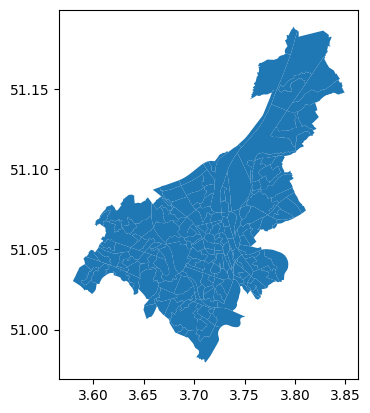

In [ ]:
gdf_sector.plot()

In [ ]:
# Do the sector codes (NIS9) map
df_mapping_gent.sector_code.isin(gdf_sector.sector_code).sum()
# Yep!

201

Looks like we got most there! The coordinates also match with a quick check of lat/lon on google maps

#### Dataset 8: Map Onto Street Level

Dataset of address point in belgium (from geo.be)


**Steps**

1. Lowercase the street names in the "streetname_nl" column.
2. Create a GeoDataFrame from the DataFrame, using the "x" and "y" coordinates to create a geometry column.
3. Set the coordinate reference system (CRS) of the GeoDataFrame to EPSG:3812.
4. Convert the CRS of the GeoDataFrame to EPSG:4326.
5. Store the original geometry coordinates separately in a "coordinates" column.
6. Extract the latitude and longitude coordinates from the geometry column.
7. Drop redundant columns from the GeoDataFrame.

**Note** This has been reduced to just include Ghent

Granularity: One row per address

**Source** ->
- [geo.be](https://www.geo.be/catalog/details/ca0fd5c0-8146-11e9-9012-482ae30f98d9?l=en)
- [useful github repo](https://github.com/oSoc19/best/tree/master)

This uses the function [get_address_data](#get_address_data)

In [ ]:
gdf_address = get_address_data()
gdf_address.head()

,housenumber,boxnumber,streetname,geometry,coordinates,lat,lon,address_id
3,1A,None,klaverstraat,POINT (3.71082 51.07227),POINT (3.71082 51.07227),51.072272,3.710818,3
31,25,None,beukenlaan,POINT (3.67460 51.02677),POINT (3.67460 51.02677),51.026773,3.674601,31
129,706,None,kortrijksesteenweg,POINT (3.71220 51.02937),POINT (3.71220 51.02937),51.029373,3.712205,129
150,18,None,chrysantstraat,POINT (3.71165 51.07249),POINT (3.71165 51.07249),51.072489,3.711650,150
170,300,None,frans van ryhovelaan,POINT (3.71288 51.07428),POINT (3.71288 51.07428),51.074281,3.712879,170


<Axes: >

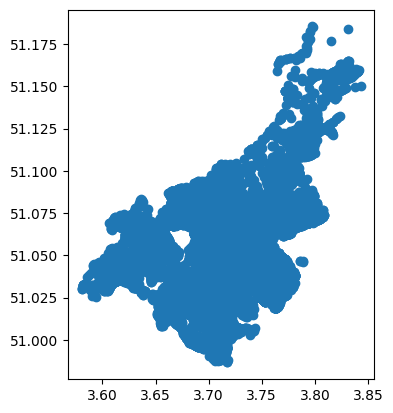

In [ ]:
gdf_address.plot()

Looks like Ghent! From eyeballing it, it looks like the coords match up with the sectors.

#### Dataset 9: Solar data

Granularity: One row per cell geom

**Steps**

1. Rename the columns of the DataFrame.
2. Rename building types and categories to more descriptive names.
3. Convert specific columns to string type.
4. Convert date columns to datetime format.
5. Lowercase the street names in the "street_name" column.
6. Select only data for the specified municipality.
7. Drop unnecessary columns from the DataFrame.
8. Convert the geometry to the WGS84 CRS (EPSG:4326).
9. Calculate the centroid of each building (after converting geometry to meters).
10. Rename the "geometry" column to "geometry_building".
11. Use the index as a unique identifier.
12. Extract the latitude and longitude coordinates of the centroids.

**Source**:

v3 is one recommended by WDL
Folder pv_data: Officially published version. Gent recommends you to USE THIS VERSION :)

This uses the function [get_solar_data](#get_solar_data)

In [ ]:
df_solar = get_solar_data()

In [ ]:
df_solar.head()

,building_type,building_cat,building_surface_area,building_length,street_name,building_number,solar_opportunity_area,solar_opportunity_3d,solar_irradiation,total_solar_irradiation,energy_production,geometry_building,centroid,solar_id,lat_solar,lon_solar
0,building on ground,central building,296.97,107.28,begoniastraat,5-15,72,72,932,67573,5989,"POLYGON ((3.70867 51.00022, 3.70867 51.00021, ...",POINT (3.70869 51.00013),0,51.000131,3.708690
1,building on ground,central building,296.97,107.28,begoniastraat,5-15,140,140,976,137162,12195,"POLYGON ((3.70846 51.00027, 3.70848 51.00027, ...",POINT (3.70850 51.00020),1,51.000201,3.708498
2,building on ground,central building,121.68,59.73,grotesteenweg-zuid,23,8,8,893,8040,638,"POLYGON ((3.68947 50.99910, 3.68947 50.99911, ...",POINT (3.68950 50.99910),2,50.999103,3.689502
3,building on ground,central building,121.68,59.73,grotesteenweg-zuid,23,22,27,995,22639,3425,"POLYGON ((3.68943 50.99908, 3.68943 50.99908, ...",POINT (3.68941 50.99911),3,50.999112,3.689414
4,building on ground,central building,83.51,40.38,remi vlerickstraat,24,22,30,992,22072,3794,"POLYGON ((3.71433 51.00036, 3.71433 51.00035, ...",POINT (3.71430 51.00034),4,51.000337,3.714302


<Axes: >

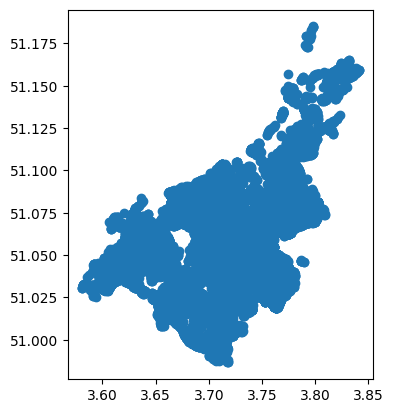

In [ ]:
df_solar.centroid.plot()

#### Dataset 10: BIMD data

Granularity: One row per sector code

A measure of relative 'deprivation' in Belgium. Description from source:

An index of mutiple deprivation (IMD) is multidimensional, offering broader view than that gained by education, occupation or income alone. It highlights the social aspects of deprivation that are relevant for health care planning and resources allocation. Being multidimensional, an IMD is based on multiple indicators, organized across multiple domains of deprivation which are weighted and combined to create the overall IMD. This relative measure of deprivation is computed for small administrative unit areas, in Belgium the statistical sector. Each statistical sector is then ranked from the most to the least deprived according to its level of deprivation relative to that of other statistical sectors.

This could be useful for the social economic aspects of defining an energy community

**Steps**

1. Rename the "CD_RES_SECTOR" column to "sector_code".
2. Filter the DataFrame to include only sector codes that start with the specified sector prefix.
3. Drop unnecessary columns from the DataFrame.

source -> [ELLIS](https://www.brain-ellis.be/blog/10-towards-the-development-of-a-belgian-index-of-multiple-deprivation)

This uses the function [get_bimd_data](#get_bimd_data)

In [ ]:
df_index = get_bimd_data()
df_index.head()

,sector_code,exp_score_income_domain,rank_income_domain,deciles_income_domain,exp_score_employment_domain,rank_employment_domain,deciles_employment_domain,exp_score_edu_domain,rank_edu_domain,deciles_edu_domain,exp_score_hous_domain,rank_hous_domain,deciles_hous_domain,exp_score_health_domain,rank_health_domain,BIMD2011_score,BIMD2011_rank,BIMD2011_deciles_domain
8023,44021A00-,62.293051,1022,1,21.114240,7346,4,25.518948,6023,4,11.650480,11210,6,12.735850,10682,30.640516,4208,3
8024,44021A01-,60.211581,1142,1,31.704390,4545,3,41.068796,2943,2,15.838700,9303,5,13.417309,10363,36.960166,2718,2
8025,44021A02-,45.811408,2349,2,6.265333,14232,8,22.965352,6759,4,7.794152,13301,8,11.953651,11060,23.040228,7028,4
8026,44021A03-,65.944994,836,1,38.311651,3349,2,42.336849,2772,2,12.658100,10719,6,13.017519,10549,39.208256,2295,2
8027,44021A040,56.078771,1415,1,54.838063,1507,1,94.384380,69,1,27.776532,5437,3,13.802113,10187,55.937630,520,1


#### Dataset 11 Sector Population
Granularity: One row per sector code

**Steps**
1. Read the data from the specified Excel file.
2. Drop the unnecessary columns "TX_DESCR_SECTOR_FR" and "TX_DESCR_FR".
3. Rename the columns "CD_SECTOR", "TOTAL", and "TX_DESCR_NL" to "sector_code", "population", and "municipality" respectively.
4. Select only the columns "sector_code", "municipality", and "population".
5. Filter the DataFrame to include only rows where the "municipality" column contains the string 'GENT' (case-insensitive).
6. Drop the "municipality" column from the DataFrame before returning it.

This uses the function [get_sector_population](#get_sector_population)

In [ ]:
df_population = get_sector_population()
df_population.head()

,sector_code,population
0,11001A00-,2474
1,11001A01-,2805
2,11001A020,752
3,11001A030,441
4,11001A042,346


#### Dataset 12: Urban Atlas
Granularity: One row per sector code

The aim is to define if the address is residential/public/ or commercial. And any other uses. This will help with address level calculations (such as energy consumption)

**Steps**

1. Define two lists: residential and other_consumers, which contain specific land use categories.
2. Read the data from the specified file using gpd.read_file.
3. Convert the coordinate reference system (CRS) of the DataFrame to WGS84 using to_crs('EPSG:4326').
4. Convert all column names to lowercase using columns = map(str.lower, df_land.columns).
5. Select only the columns 'item2012' and 'geometry' from the DataFrame.
6. Create a new column 'land_use_type' based on the values in the 'item2012' column. If a value is found in the residential list, assign it as 'residential'. If a value is found in the other_consumers list, assign it as 'other_consumers'. Otherwise, assign`np.nan.
7. Return the modified DataFrame with columns 'item2012', 'geometry', and 'land_use_type'.

**Source** <- [land.copernicus](https://land.copernicus.eu/user-corner/technical-library/urban_atlas_2012_2018_mapping_guide_v6.3)

This uses the function [get_urban_atlas](#get_urban_atlas)

In [ ]:
df_land = get_urban_atlas()
df_land.head()

,item2012,geometry,land_use_type
0,Continuous urban fabric (S.L. : > 80%),"POLYGON ((3.81040 50.90396, 3.81002 50.90380, ...",residential
1,Continuous urban fabric (S.L. : > 80%),"POLYGON ((3.65404 50.90132, 3.65404 50.90131, ...",residential
2,Continuous urban fabric (S.L. : > 80%),"POLYGON ((3.66007 50.90336, 3.66007 50.90336, ...",residential
3,Continuous urban fabric (S.L. : > 80%),"POLYGON ((3.80867 50.91182, 3.80841 50.91174, ...",residential
4,Continuous urban fabric (S.L. : > 80%),"POLYGON ((3.80869 50.91253, 3.80862 50.91252, ...",residential


### Data Wrangling <a name ='data_wrangling'></a>

We will now list the steps taken to transform the data into a state where we can use it for modelling and optimisation. We also had the target of defining specific features that would relate to energy communities (based on the advice of the subject matter expert):

- An indicator of fuel poverty
- Potential to use solar power
- Renewable energy
- Cost

Moreover, we have the challenge of working accross several location types and granularities. Therefore, we need to join these together in a way which useful for forming energy communities (the more granular the better).

We did EDA throughout this data wrangling process to understand how we should join the data, but more visualisation etc can be seen in the "official" EDA section [here](#exploratory_data_analysis)

---

##### Joining Solar and Address data <a name ='solar_address_join'></a>

We need to investigate how we relate addresses (member of energy comunities) to power sources (areas with solar potential). There are four options:

1. Join on address (not possible due to duplicate addresses in solar data)
2. Spatial join solar building outline to address coordinate.
3. Spatial join nearest solar building centroid to nearest address coordinate.
4. Don't join, and just use seperate tables for analysis. This makes sense for analysis but will make optimizing and modelling more challenging.

A combination of (1,2 or 3) and 4 would be the best option.

###### 1. Address Join

In [ ]:
gdf_address.columns

Index(['housenumber', 'boxnumber', 'streetname', 'geometry', 'coordinates',
       'lat', 'lon', 'address_id'],
      dtype='object')

In [ ]:
# check for duplicates
gdf_address[["housenumber", "streetname"]].duplicated().sum()

30104

In [ ]:
# with boxnumber
gdf_address[["housenumber", "streetname", "boxnumber"]].duplicated().sum()

1398

In [ ]:
# duplicates in solar
df_solar.columns

Index(['building_type', 'building_cat', 'building_surface_area',
       'building_length', 'street_name', 'building_number',
       'solar_opportunity_area', 'solar_opportunity_3d', 'solar_irradiation',
       'total_solar_irradiation', 'energy_production', 'geometry_building',
       'centroid', 'solar_id', 'lat_solar', 'lon_solar'],
      dtype='object')

In [ ]:
# check for duplicates
df_solar[["building_number", "street_name"]].duplicated().sum()

41792

Building name/address values are not unique in the solar data. We are lacking a way to link boxnumber with a unique identifier for addresses in a building. It would therefore be difficult to avoid duplicating solar sites in a join. We will therefore try a spatial join

###### 2. Spatial Intersection Join

Join using geometry of solar building

In [ ]:
# join the df_solar outlines with the address coordinates
# set geometry column to coordinates for join
df_address = gdf_address.copy()
df_address = df_address.set_geometry("coordinates")
df_solar = df_solar.set_geometry("geometry_building")

# join with solar data
dfs = [df_address, df_solar]
df_sjoin = ft.reduce(lambda left, right: gpd.sjoin(left, right, how="left"), dfs)

print(
    f"Number of non null values in solar irradiation column: {df_sjoin.solar_irradiation.notnull().sum()}"
)
print(f'Number of unique solar_id: {len(df_sjoin.groupby(["solar_id"]))}')
print(
    f'Thats a coverage of {round(len(df_sjoin.groupby(["solar_id"]))/len(df_solar)*100,2)}% from the available solar data'
)

Number of non null values in solar irradiation column: 97559
Number of unique solar_id: 52688
Thats a coverage of 42.85% from the available solar data


###### 3. Spatial Nearest Join

Use s_join nearest between coordinates and geometry

In [ ]:
df_address

,housenumber,boxnumber,streetname,geometry,coordinates,lat,lon,address_id
3,1A,None,klaverstraat,POINT (3.71082 51.07227),POINT (3.71082 51.07227),51.072272,3.710818,3
31,25,None,beukenlaan,POINT (3.67460 51.02677),POINT (3.67460 51.02677),51.026773,3.674601,31
129,706,None,kortrijksesteenweg,POINT (3.71220 51.02937),POINT (3.71220 51.02937),51.029373,3.712205,129
150,18,None,chrysantstraat,POINT (3.71165 51.07249),POINT (3.71165 51.07249),51.072489,3.711650,150
170,300,None,frans van ryhovelaan,POINT (3.71288 51.07428),POINT (3.71288 51.07428),51.074281,3.712879,170
...,...,...,...,...,...,...,...,...
4069706,16,0301,taxusstraat,POINT (3.73779 51.06353),POINT (3.73779 51.06353),51.063533,3.737793,4069706
4069707,16,0302,taxusstraat,POINT (3.73779 51.06353),POINT (3.73779 51.06353),51.063533,3.737793,4069707
4069708,16,0303,taxusstraat,POINT (3.73779 51.06353),POINT (3.73779 51.06353),51.063533,3.737793,4069708
4069709,16,0304,taxusstraat,POINT (3.73779 51.06353),POINT (3.73779 51.06353),51.063533,3.737793,4069709


In [ ]:
# do nearest join between the coordinates and centroids
# set geometry column to coordinates for join
df_address["coordinates_meters"] = df_address["coordinates"].to_crs(epsg=3857)
df_address = df_address.set_geometry("coordinates_meters")

df_solar["centroid_meters"] = df_solar["centroid"].to_crs(epsg=3857)
df_solar = df_solar.set_geometry("centroid_meters")

# join with s_join nearest
dfs = [df_address, df_solar]
df_sjoin_nearest = ft.reduce(
    lambda left, right: gpd.sjoin_nearest(
        left, right, how="left", distance_col="solar_to_address_distance"
    ),
    dfs,
)

In [ ]:
# See how far apart the nearest solar panel is
df_sjoin_nearest.solar_to_address_distance.describe()

count    171703.000000
mean         11.783793
std          32.778494
min           0.003829
25%           2.361452
50%           4.362836
75%           8.192984
max        3381.536842
Name: solar_to_address_distance, dtype: float64

In [ ]:
# Calculate total count
total_count = len(df_sjoin_nearest)

# Calculate cumulative position as a percentage
df_sjoin_nearest["cumulative_position"] = (
    df_sjoin_nearest["solar_to_address_distance"].rank(pct=True) * 100
)

# find max cumitive position for max distance of 20 meters
max_cumulative_position = df_sjoin_nearest[
    df_sjoin_nearest["solar_to_address_distance"] <= 20
]["cumulative_position"].max()

# find the % of unique solar panels within 20 meters out of the total non null ids
unique_solar_panels = len(
    df_sjoin_nearest[df_sjoin_nearest["solar_to_address_distance"] <= 20]
    .groupby(["solar_id"])
    .count()
)

print(f"Number of unique solar panel ids before join: {df_solar.solar_id.nunique()}")
print(
    f"The % locations with a solar panels within 20 meters is {max_cumulative_position}%"
)
print(
    f"Number of solar panels within 20 meters: {len(df_sjoin_nearest[df_sjoin_nearest['solar_to_address_distance'] <= 20])}"
)
print(
    f"Number of unique solar Ids under 20m: {unique_solar_panels}, as a percentage of the solar data: {round(unique_solar_panels/df_solar.solar_id.nunique()*100,2)}%"
)

Number of unique solar panel ids before join: 122965
The % locations with a solar panels within 20 meters is 88.24831249308399%
Number of solar panels within 20 meters: 151525
Number of unique solar Ids under 20m: 81684, as a percentage of the solar data: 66.43%


**Note** This offers a better join for unique instances than the straight join on address.

**Note** We tried this again for 50m and disn't see a huge increase in matches. We will stick with 20m for now.

We could try multiple nearest joins. This would mean:

- An intial join on nearest address to solar data (less than 20m)
- Keep only the results that are closest (if joined to the solar ID)
- Join again using the remaining addresses to the solar data (that are not in the first join)

A function was defined for this in our helper list called [recursive_nearest_join](#recursive_nearest_join)

**Note** For the purposes of this project, we want to match up as many addresses with solar potential as possible. This is because we will want to use both features in an optimization algorithim (and hence we we are attempting to join). Therefore, the accuracy of the spatial join is not necessarily important (as long as they are in the same approximate area). This is because, the solar panels don't necessarily have to be on the roofs of members. However, this is an assumption we have had to make.

In [ ]:
# other parameters were tried, but the following was selected
# Try 5 Attempts + 200 meter joining range
df_target = recursive_nearest_join(
    df_address, df_solar, join_attempts=5, max_distance=200, verbose=True
)

Number of unique solar panel ids before join: 122965
The number of rows joins 106996
Number of solar panels within 200 meters: 106996
Number of unique solar Ids under 200m: 106996, as a percentage of the solar data: 87.01%


#### Joining the datasets <a name ='joining_data'></a>

Join it all Together!

We need to assess how we can bring our multiple sources

Reminder of tables and granularity

| Dataset | Name                           | Location Column Types    |
|---------|--------------------------------|-------------------------|
| Dataset 1  | df_energy_consumption  | Street Name         |
| Dataset 2  | df_ev_points  | Postcode                    |
| Dataset 3  | df_energy_dc_prod  | Postcode               |
| Dataset 4  | df_average_income  | Sector                   |
| Dataset 5  | df_rent_prices  | Postcode, street, coordinate |
| Dataset 6  | df_mapping_gent   | Postcode, sector |
| Dataset 7  | gdf_sector  | Sector, polygon |
| Dataset 8  | gdf_address   | Address, point |
| Dataset 9  | df_solar  | coordinates (building outline) |
| Dataset 10  | df_index   | Sector |
| Dataset 11  | df_population   | Sector |
| Dataset 12  | df_land   | coordinates (land use outline) |

The data load and transform is done in the function outline above called [create_feature_table](#create_feature_table) (reading off the config parameters loaded):


In [ ]:
df_base = create_feature_table()

Number of unique solar panel ids before join: 122965
The number of rows joins 106996
Number of solar panels within 200 meters: 106996
Number of unique solar Ids under 200m: 106996, as a percentage of the solar data: 87.01%


In [ ]:
# join land use onto df solar
df_solar = df_solar.set_geometry("centroid")
df_solar = df_solar.sjoin(df_land, how="left")
df_solar.drop(columns=["index_right"], inplace=True)
df_solar.head()

,building_type,building_cat,building_surface_area,building_length,street_name,building_number,solar_opportunity_area,solar_opportunity_3d,solar_irradiation,total_solar_irradiation,energy_production,geometry_building,centroid,solar_id,lat_solar,lon_solar,centroid_meters,item2012,land_use_type
0,building on ground,central building,296.97,107.28,begoniastraat,5-15,72,72,932,67573,5989,"POLYGON ((3.70867 51.00022, 3.70867 51.00021, ...",POINT (3.70869 51.00013),0,51.000131,3.708690,POINT (412849.473 6621316.933),Discontinuous dense urban fabric (S.L. : 50% -...,residential
1,building on ground,central building,296.97,107.28,begoniastraat,5-15,140,140,976,137162,12195,"POLYGON ((3.70846 51.00027, 3.70848 51.00027, ...",POINT (3.70850 51.00020),1,51.000201,3.708498,POINT (412828.113 6621329.313),Discontinuous dense urban fabric (S.L. : 50% -...,residential
2,building on ground,central building,121.68,59.73,grotesteenweg-zuid,23,8,8,893,8040,638,"POLYGON ((3.68947 50.99910, 3.68947 50.99911, ...",POINT (3.68950 50.99910),2,50.999103,3.689502,POINT (410713.455 6621135.116),Discontinuous dense urban fabric (S.L. : 50% -...,residential
3,building on ground,central building,121.68,59.73,grotesteenweg-zuid,23,22,27,995,22639,3425,"POLYGON ((3.68943 50.99908, 3.68943 50.99908, ...",POINT (3.68941 50.99911),3,50.999112,3.689414,POINT (410703.734 6621136.668),Discontinuous dense urban fabric (S.L. : 50% -...,residential
4,building on ground,central building,83.51,40.38,remi vlerickstraat,24,22,30,992,22072,3794,"POLYGON ((3.71433 51.00036, 3.71433 51.00035, ...",POINT (3.71430 51.00034),4,51.000337,3.714302,POINT (413474.235 6621353.383),Discontinuous dense urban fabric (S.L. : 50% -...,residential


#### Handle Nulls <a name ='handling_nulls'></a>

We need to investigate and handle nulls in the dataset.

In [ ]:
df_base.isna().sum()

sector_code                      0
geometry                         0
postcode                         0
sector                           0
exp_score_income_domain        857
                             ...  
centroid                     64707
solar_id                     64707
lat_solar                    64707
lon_solar                    64707
solar_to_address_distance    64707
Length: 61, dtype: int64

Notes on nulls

- 857 nulls due to no BIMD data. This is something we cant compute, therefore will will just drop these rows. The nulls are due to sector not joining up.
- 142729 nulls in boxnumber. This is because not alldresses will have a box number. We will fill these with 'n/a' or unknown
- 2526 nulls in tax, drop these rows as these are due to missing values in the original dataset.
- 19 nulls in power, capacity and installation power to postcode join
- 8000/11000 nulls in energy due to streetname match and 5 nulls for streets from source, these can be imputed with sector/postcode means
- All object type columns are related to some form of location metadata:
  - **Assumption** All Nulls are due not having data at the location, so hense assing an unkown value
  - **Assumption** All nulls due not having solar data is because there are no solar potential reading for that building, hence assign 'not_available'


We have defined a function called [handle_missing_values](#handle_missing_values) to do all of these steps

In [ ]:
df_base = handle_missing_values(df_base)

#### Engineer Additional features <a name ='engineer_additional_features'></a>

Using the gather features, some additional features can be engineered.


- fuel poverty category
- cost of solar pannel
- estimated emissions

In [ ]:
df = df_base.copy()

##### Energy Poverty

The EU Energy Poverty Observatory, produced a 2020 methodology guidebook, which identified several primary and secondary indicators to measure energy poverty across the EU. The four primary indicators include:

1. arrears on utility bills;
2. low absolute energy expenditure;
3. high share of energy expenditure in income;
4. inability to keep home adequately warm.

Source: https://www.europarl.europa.eu/RegData/etudes/BRIE/2022/733583/EPRS_BRI(2022)733583_EN.pdf

A [belgian source](https://www.energyprice.be/blog/energy-poverty-in-belgium/#:~:text=Measured%20energy%20poverty%20%E2%80%93%20this%20affects,that%20it%20becomes%20abnormally%20low.) gives this definition:

The King Baudouin Foundation publishes an energy poverty barometer for Belgium every year. This gives a very clear picture of how the situation is developing in Belgium. The methodology applied by the Foundation revolves around three different types of poverty:

- Measured energy poverty – this affects households that spend more than 11.8% of their disposable income on their energy bills, twice as much as average households (5.9%).
- Hidden energy poverty – this refers to cases where households decrease their energy consumption so much that it becomes abnormally low. This can have serious consequences for the health of household members.
- Subjective energy poverty – this concerns people who, in their own opinion, deem that they do not have sufficient means to heat their home.

These factors are difficult to measure given the type and granularity of the data. We could create a feature combining sector income and street energy expenditure (given current energy costs) to estimate the share of mean share of income being used on energy in a sector. We could also see if any street level consumption is 'abnormally low' when compared to the rest of the data. We could also see if there is energy efficiency ratings available for properties (equivelent to EPC in the UK).For this, we will need:

- Income (average_income_per_sector in euros)
- Energy use at address level (fluvius data, street level in kwh per year)
- Energy cost at address level

In [ ]:
# income data
df.avg_net_tax_income.describe()

count    171703.000000
mean      20393.667057
std        4370.106405
min        9797.000000
25%       17183.000000
50%       20784.000000
75%       23251.000000
max       33468.000000
Name: avg_net_tax_income, dtype: float64

In [ ]:
# energy consumption data (at street level)
df.annual_energy_use_electricity_offtake.describe()

count    1.717030e+05
mean     1.693365e+06
std      4.598737e+06
min      1.677100e+03
25%      1.845065e+05
50%      4.359967e+05
75%      1.235539e+06
max      4.705270e+07
Name: annual_energy_use_electricity_offtake, dtype: float64

In [ ]:
# gas consumption data (at street level)
df.annual_energy_use_natural_gas_offtake.describe()

count    1.717030e+05
mean     2.933948e+06
std      4.747525e+06
min      1.818729e+04
25%      6.558675e+05
50%      1.379902e+06
75%      3.181195e+06
max      4.560256e+07
Name: annual_energy_use_natural_gas_offtake, dtype: float64

###### Fuel cost

According to [eu statsitics ](https://ec.europa.eu/eurostat/statistics-explained/index.php?title=Natural_gas_price_statistics), the current gas price in belgium (per kwh) is **0.0939 euro per KWH**

And the electricity price is **0.3377 euro per Kwh**

In [ ]:
# stored in config file as these are likely to change, so we want to make it as reusable as possible
print(config["Params"]["gas_price"])
print(config["Params"]["electricity_price"])

gas_price = float(config["Params"]["gas_price"])
electricity_price = float(config["Params"]["electricity_price"])

0.0939
0.3377


In [ ]:
# assuming all energy consumption is the same, calculate the energy consumption per address
energy_per_street = df.groupby("streetname")[
    ["annual_energy_use_natural_gas_offtake", "annual_energy_use_electricity_offtake"]
].agg(lambda x: x.mean() / x.count())
energy_per_street.columns = ["address_gas_offtake", "address_electricity_offtake"]

df_energy = df[["streetname", "avg_net_tax_income"]].merge(
    energy_per_street, how="left", on="streetname"
)

In [ ]:
df_energy["energy_cost"] = (
    df_energy.address_gas_offtake * gas_price
    + df_energy.address_electricity_offtake * electricity_price
)

In [ ]:
df_energy["energy_percent_income"] = (
    df_energy.energy_cost / df_energy.avg_net_tax_income
)

In [ ]:
df_energy["energy_percent_income"].describe()

count    171703.000000
mean          0.324352
std           4.752524
min           0.002413
25%           0.087536
50%           0.113668
75%           0.162972
max         758.780097
Name: energy_percent_income, dtype: float64

In [ ]:
# how many are above 11.8%
df_energy[df_energy["energy_percent_income"] > 0.118].shape[0] / df_energy.shape[0]

0.46142466934182863

These values are clearly to high. The fuel poverty indicator is 11.8% in belgium and the 50th percentile is around this mark.

This is because the energy figures are not just for residential addresses.

To make this figure more relatistic, we can:

1. Scale consumption according to national usuages (i.e x% is for housholds, y% for buisness etc)
2. Attempt to label addresses according to land use. We can therefore remove these from the total, as the assumption would be that commerical/public buildings would need a different amount of energy.



###### Residential energy consumption

According to this [source](https://www.odyssee-mure.eu/publications/efficiency-trends-policies-profiles/belgium-country-profile-english.pdf), residential buildings account for 23% of energy consumption in belgium

In [ ]:
residential_energy_share = 0.23

In [ ]:
df_energy.energy_percent_income = (
    df_energy.energy_percent_income * residential_energy_share
)

In [ ]:
df_energy.energy_percent_income[
    df_energy.energy_percent_income > 0.1118
].count() / df_energy.shape[0]

0.05665596990151599

In [ ]:
# how many values are above 1?
df_energy.energy_percent_income[
    df_energy.energy_percent_income > 1
].count() / df_energy.shape[0]

0.006639371472833905

In [ ]:
df_energy.energy_percent_income.describe()

count    171703.000000
mean          0.074601
std           1.093081
min           0.000555
25%           0.020133
50%           0.026144
75%           0.037484
max         174.519422
Name: energy_percent_income, dtype: float64

Accourding to this [report](https://www.energyprice.be/blog/energy-poverty-in-belgium/#:~:text=Measured%20energy%20poverty%20%E2%80%93%20this%20affects,that%20it%20becomes%20abnormally%20low.) 15.1% of flemish households faced energy poverty (by the above definition) in 2019. Therefore, the 5.6% may be an under estimation.

This figure is making the oversimplifaction that all buildings are residential. We need to label addresses with there use to get more accurate figures. It is likely that the majority of addressess in the city will be residential, hense the use of energy may be greater that the 23% estimation



###### Land Use

The aim is to define if the address is residential/public/ or commercial. And any other uses.

We also need to define what percentage of energy non-residential addresses use.

To do this we can use land use categories from urban atlas.

Documentation on this is [here](https://land.copernicus.eu/user-corner/technical-library/urban_atlas_2012_2018_mapping_guide_v6.3)

The following values are likely to be residential (S.L refers to soil sealing structures):

- Continuous urban fabric (S.L. : > 80%)
- Discontinuous dense urban fabric (S.L. : 50% -  80%)
- Discontinuous medium density urban fabric (S.L. : 30% - 50%)
- Discontinuous low density urban fabric (S.L. : 10% - 30%)
- Discontinuous very low density urban fabric (S.L. : < 10%)
- Isolated structures

Other values of interest:

- Industrial
- commercial
- public
- military
- private units
- Port Areas

In [ ]:
# check the join has worked
df = df.set_geometry("coordinates")

In [ ]:
df.item2012.unique()

array(['Continuous urban fabric (S.L. : > 80%)',
       'Other roads and associated land',
       'Industrial, commercial, public, military and private units',
       'Water', 'Discontinuous dense urban fabric (S.L. : 50% -  80%)',
       'Green urban areas', 'Sports and leisure facilities',
       'Discontinuous medium density urban fabric (S.L. : 30% - 50%)',
       'Arable land (annual crops)', 'Railways and associated land',
       'Port areas', 'Land without current use',
       'Discontinuous low density urban fabric (S.L. : 10% - 30%)',
       'Pastures',
       'Discontinuous very low density urban fabric (S.L. : < 10%)',
       'Herbaceous vegetation associations (natural grassland, moors...)',
       'Isolated structures', 'Mineral extraction and dump sites',
       'Forests', 'Fast transit roads and associated land',
       'Construction sites'], dtype=object)

In [ ]:
# potential areas to include
residential = [
    "Continuous urban fabric (S.L. : > 80%)",
    "Discontinuous dense urban fabric (S.L. : 50% -  80%)",
    "Discontinuous medium density urban fabric (S.L. : 30% - 50%)",
    "Discontinuous low density urban fabric (S.L. : 10% - 30%)",
    "Discontinuous very low density urban fabric (S.L. : < 10%)",
    "Isolated structures",
]

other_consumers = [
    "Industrial, commercial, public, military and private units",
    "Sports and leisure facilities",
    "Arable land (annual crops)",
    "Port areas",
    "Mineral extraction and dump sites",
    "Railways and associated land",
    "Construction sites",
]

In [ ]:
# how many addresses are in residential areas?
print(df[df.item2012.isin(residential)].shape[0] / df.shape[0])

0.8157457936087313


This is difficult to verify, but it makes sense that the majority of addresses in a city would be residential. Note, this refers to count of addresses, not area.

###### Calculating energy usage per address

Without knowing the exact split of energy usage between residential and other addresses ( considering large buildings such as hospitals, schools, offices etc will have more than one address), we have to make assumptions on how the energy is distributed.

Assumptions:
- Ratio of residential to non-residential addresses is 5 for the same land use (this is a gross over simplimification).
- Energy consumption will be distributed evenly accross residential addresses

To do this we defined energy split functions.




In [ ]:
grouped_df = df.groupby("streetname").apply(group_energy_split)
grouped_df.reset_index(inplace=True)
grouped_df.drop(columns="level_1", inplace=True)

grouped_df.head()

,streetname,residential_electricity_offtake_address,other_electricity_offtake_address,residential_natural_gas_offtake_address,other_natural_gas_offtake_address
0,'t stuk,234721.073416,0.000000,333056.126881,0.000000
1,aaigemstraat,1646.035319,8230.176596,5041.012492,25205.062462
2,aakstraat,0.000000,569152.561722,0.000000,377036.416478
3,aalbessenlaan,2913.198421,0.000000,10822.556842,0.000000
4,aalscholverstraat,2905.695714,0.000000,13925.087857,0.000000


In [ ]:
df_join = df.merge(grouped_df, how="left", on="streetname")
df_join.residential_natural_gas_offtake_address.describe()

count    1.717030e+05
mean     1.299317e+04
std      8.455854e+04
min      0.000000e+00
25%      5.968486e+03
50%      9.260176e+03
75%      1.184238e+04
max      7.429019e+06
Name: residential_natural_gas_offtake_address, dtype: float64

In [ ]:
# set other energy to null for residential areas
df_join.loc[
    df_join.land_use_type == "residential", "other_natural_gas_offtake_address"
] = np.nan
df_join.loc[
    df_join.land_use_type == "residential", "other_electricity_offtake_address"
] = np.nan

# set residential energy to null for other areas
df_join.loc[
    df_join.land_use_type == "other_consumers",
    "residential_natural_gas_offtake_address",
] = np.nan
df_join.loc[
    df_join.land_use_type == "other_consumers",
    "residential_electricity_offtake_address",
] = np.nan

# set nan uses to nan
df_join.loc[
    df_join.land_use_type == np.nan, "residential_natural_gas_offtake_address"
] = np.nan
df_join.loc[
    df_join.land_use_type == np.nan, "residential_electricity_offtake_address"
] = np.nan

df_join["energy_cost_residential"] = (
    df_join.residential_natural_gas_offtake_address * gas_price
    + df_join.residential_electricity_offtake_address * electricity_price
)
df_join["energy_cost_residential_percent_income"] = df_join.apply(
    lambda x: x.energy_cost_residential / x.avg_net_tax_income
    if x.item2012 in residential
    else np.nan,
    axis=1,
)

In [ ]:
df_join.isna().sum()

sector_code                                     0
geometry                                        0
postcode                                        0
sector                                          0
exp_score_income_domain                         0
                                            ...  
other_electricity_offtake_address          140066
residential_natural_gas_offtake_address     26952
other_natural_gas_offtake_address          140066
energy_cost_residential                     26952
energy_cost_residential_percent_income      31637
Length: 67, dtype: int64

In [ ]:
df_join["energy_cost_residential"] = (
    df_join.residential_natural_gas_offtake_address * gas_price
    + df_join.residential_electricity_offtake_address * electricity_price
)

In [ ]:
df_join["energy_cost_residential"].describe()

count    1.447510e+05
mean     3.464384e+03
std      2.614836e+04
min      0.000000e+00
25%      1.533755e+03
50%      1.929145e+03
75%      2.507555e+03
max      4.128694e+06
Name: energy_cost_residential, dtype: float64

In [ ]:
df_join["energy_cost_residential_percent_income"] = df_join.apply(
    lambda x: x.energy_cost_residential / x.avg_net_tax_income
    if x.item2012 in residential
    else np.nan,
    axis=1,
)

In [ ]:
df_join["energy_cost_residential_percent_income"].describe()

count    140066.000000
mean          0.155505
std           0.996482
min           0.000566
25%           0.074990
50%           0.097460
75%           0.127664
max         216.071490
Name: energy_cost_residential_percent_income, dtype: float64

In [ ]:
# how many are above 11.8%?
df_join.energy_cost_residential_percent_income[
    df_join.energy_cost_residential_percent_income > 0.118
].count() / df_join.shape[0]

0.25545855343238033

In [ ]:
# how many are above 100%
df_join.energy_cost_residential_percent_income[
    df_join.energy_cost_residential_percent_income > 1
].count() / df_join.shape[0]

0.008334158401425717

This figure is ofcourse above the 15.1% energy poverty figure, however this is likely due to the to an over estimate of the amount of energy households consume. More detailed data on consumption patterns would be needed to improved. Also, this calculation has been made using the assumption that each address has only one tax payer, this is likely higher.

0.8% are above 100% of budget on energy. This is likely due to mislabelling of landuses or including addresses that represent multiple households (although this shouldn't be the case given the data is at address level and not building level). We can discount values above 50% (an assumption)

However, this is still our best estimate of energy poverty in the city.

It's bigger than we need but looks like it emcompases gent!

putting it into a function you can find [here](#create_energy_income_ratio):

In [ ]:
df = create_energy_income_ratio(df)

In [ ]:
df.columns

Index(['sector_code', 'geometry', 'postcode', 'sector',
       'exp_score_income_domain', 'rank_income_domain',
       'deciles_income_domain', 'exp_score_employment_domain',
       'rank_employment_domain', 'deciles_employment_domain',
       'exp_score_edu_domain', 'rank_edu_domain', 'deciles_edu_domain',
       'exp_score_hous_domain', 'rank_hous_domain', 'deciles_hous_domain',
       'exp_score_health_domain', 'rank_health_domain', 'BIMD2011_score',
       'BIMD2011_rank', 'BIMD2011_deciles_domain', 'population',
       'total_net_taxable_income', 'interquartile_coeff_of_taxpayers',
       'interquartile_asymmetry_of_taxpayers', 'avg_net_tax_income',
       'housenumber', 'boxnumber', 'streetname', 'coordinates', 'lat', 'lon',
       'address_id', 'installation_max_power', 'power_capacity', 'street',
       'annual_energy_use_electricity_offtake',
       'annual_energy_use_natural_gas_offtake',
       'number_access_points_electricity_offtake',
       'number_access_points_natural_

##### Cost of solar panels

We need to define away of calculating the cost of each solar pannel instalation

We will establish a rough cost per square meter (based on standard prices) and keep this as a parameter so it can be altered by the user.

From this [source](https://www.greenmatch.co.uk/blog/2014/08/what-is-the-installation-cost-for-solar-panels), the cost per m2 of a 4kw system is: 289 euros/m2

The users of this tool will of course have a better idea of what solar pannels will cost for them.

In [ ]:
df.solar_opportunity_area.describe()

count    171703.000000
mean         35.277869
std         331.108726
min           0.000000
25%           0.000000
50%          14.000000
75%          30.000000
max       54751.000000
Name: solar_opportunity_area, dtype: float64

We created a function to load and process the cost [here](#calculate_solar_cost)

In [ ]:
df = calculate_solar_cost(df)
df_solar = calculate_solar_cost(df_solar)

In [ ]:
df["solar_cost"].describe()

count    1.717030e+05
mean     1.019530e+04
std      9.569042e+04
min      0.000000e+00
25%      0.000000e+00
50%      4.046000e+03
75%      8.670000e+03
max      1.582304e+07
Name: solar_cost, dtype: float64

In [ ]:
# how many are above 100,000 euros in cost
df.solar_cost[df.solar_cost > 100000].count() / df.shape[0]

0.009003919558772997

##### Energy proximity

You can find the function to generate energy proximity [here](#generate_energy_proximity)

In [ ]:
df = generate_energy_proximity(df, df_solar)

In [ ]:
df.head()

,sector_code,geometry,postcode,sector,exp_score_income_domain,rank_income_domain,deciles_income_domain,exp_score_employment_domain,rank_employment_domain,deciles_employment_domain,...,lon_solar,solar_to_address_distance,residential_electricity_offtake_address,other_electricity_offtake_address,residential_natural_gas_offtake_address,other_natural_gas_offtake_address,energy_cost_residential,energy_cost_residential_percent_income,solar_cost,top_10_per_energy_prod_in_500m
0,44021A00-,"MULTIPOLYGON Z (((3.72967 51.05289 0.00000, 3....",9000,kuip,62.293051,1022.0,1.0,21.11424,7346.0,4.0,...,3.721924,0.0,42172.942449,NaN,28015.405816,NaN,16872.449271,0.679546,0.0,3149404.0
1,44021A00-,"MULTIPOLYGON Z (((3.72967 51.05289 0.00000, 3....",9000,kuip,62.293051,1022.0,1.0,21.11424,7346.0,4.0,...,3.721924,0.0,42172.942449,NaN,28015.405816,NaN,16872.449271,0.679546,0.0,3149404.0
2,44021A00-,"MULTIPOLYGON Z (((3.72967 51.05289 0.00000, 3....",9000,kuip,62.293051,1022.0,1.0,21.11424,7346.0,4.0,...,3.721924,0.0,42172.942449,NaN,28015.405816,NaN,16872.449271,0.679546,0.0,3149404.0
3,44021A00-,"MULTIPOLYGON Z (((3.72967 51.05289 0.00000, 3....",9000,kuip,62.293051,1022.0,1.0,21.11424,7346.0,4.0,...,3.721134,0.0,0.000000,47338.15,0.000000,1.802040e+06,0.000000,NaN,0.0,3485556.0
4,44021A00-,"MULTIPOLYGON Z (((3.72967 51.05289 0.00000, 3....",9000,kuip,62.293051,1022.0,1.0,21.11424,7346.0,4.0,...,3.721924,0.0,42172.942449,NaN,28015.405816,NaN,16872.449271,0.679546,0.0,2827383.0


In [ ]:
df_solar.head()

,building_type,building_cat,building_surface_area,building_length,street_name,building_number,solar_opportunity_area,solar_opportunity_3d,solar_irradiation,total_solar_irradiation,energy_production,geometry_building,centroid,solar_id,lat_solar,lon_solar,centroid_meters,item2012,land_use_type,solar_cost
0,building on ground,central building,296.97,107.28,begoniastraat,5-15,72,72,932,67573,5989,"POLYGON ((3.70867 51.00022, 3.70867 51.00021, ...",POINT (3.70869 51.00013),0,51.000131,3.708690,POINT (412849.473 6621316.933),Discontinuous dense urban fabric (S.L. : 50% -...,residential,20808
1,building on ground,central building,296.97,107.28,begoniastraat,5-15,140,140,976,137162,12195,"POLYGON ((3.70846 51.00027, 3.70848 51.00027, ...",POINT (3.70850 51.00020),1,51.000201,3.708498,POINT (412828.113 6621329.313),Discontinuous dense urban fabric (S.L. : 50% -...,residential,40460
2,building on ground,central building,121.68,59.73,grotesteenweg-zuid,23,8,8,893,8040,638,"POLYGON ((3.68947 50.99910, 3.68947 50.99911, ...",POINT (3.68950 50.99910),2,50.999103,3.689502,POINT (410713.455 6621135.116),Discontinuous dense urban fabric (S.L. : 50% -...,residential,2312
3,building on ground,central building,121.68,59.73,grotesteenweg-zuid,23,22,27,995,22639,3425,"POLYGON ((3.68943 50.99908, 3.68943 50.99908, ...",POINT (3.68941 50.99911),3,50.999112,3.689414,POINT (410703.734 6621136.668),Discontinuous dense urban fabric (S.L. : 50% -...,residential,6358
4,building on ground,central building,83.51,40.38,remi vlerickstraat,24,22,30,992,22072,3794,"POLYGON ((3.71433 51.00036, 3.71433 51.00035, ...",POINT (3.71430 51.00034),4,51.000337,3.714302,POINT (413474.235 6621353.383),Discontinuous dense urban fabric (S.L. : 50% -...,residential,6358


##### Calculate green energy consumption

from https://gent.buurtmonitor.be/, households are 21.47% self sufficient with green energy

We can't target specific addressess or areas, so will have to assume that the energy is distributed evenly accross the city (which wont be the case)

**Note** residential and other energy outputs can be included for the same address. This is because the energy is at street level, so we can't know what the energy is being used for for the entire street. Instead these figures are distibuted according to total number of land uses in the street.

You can find information on this function [here](#calculate_green_energy)

In [ ]:
df = calculate_green_energy(df)

#### Create Table of Just Residential Addresses <a name ='residential_addresses'></a>
Creating a table of just residential address as, mentioned above, residential and other energy inputs may be included at the same address, and we want to seperate this out for our analysis.


In [ ]:
df_residential = df[df.land_use_type == "residential"]
df_residential.drop(
    columns=["other_natural_gas_offtake_address", "other_electricity_offtake_address"],
    inplace=True,
)

### Exploratory Data Analysis <a name ='exploratory_data_analysis'></a>

#### Geo Plots <a name ='geo_plots'></a>

Below are exploratory plots understanding key columns in the data frame (**Please see the [Appendix](#appendix) for other EDA Plots**)

- Land Use Type: Using the dataframe, we visualise the types of land use across the city

- Fuel Poverty: Using the column energy_cost_residential_percent_income in the residential dataframe, we visualise the ratio of expenditure on energy to income

- Quality of Living: Using the BIMD Score in 2011 (Belgian Index of Multiple Deprivation, combining indicators of income, employment, education, health, housing and crime), we visualise quality of living in Ghent. The higher the score, the higher the quality of living.

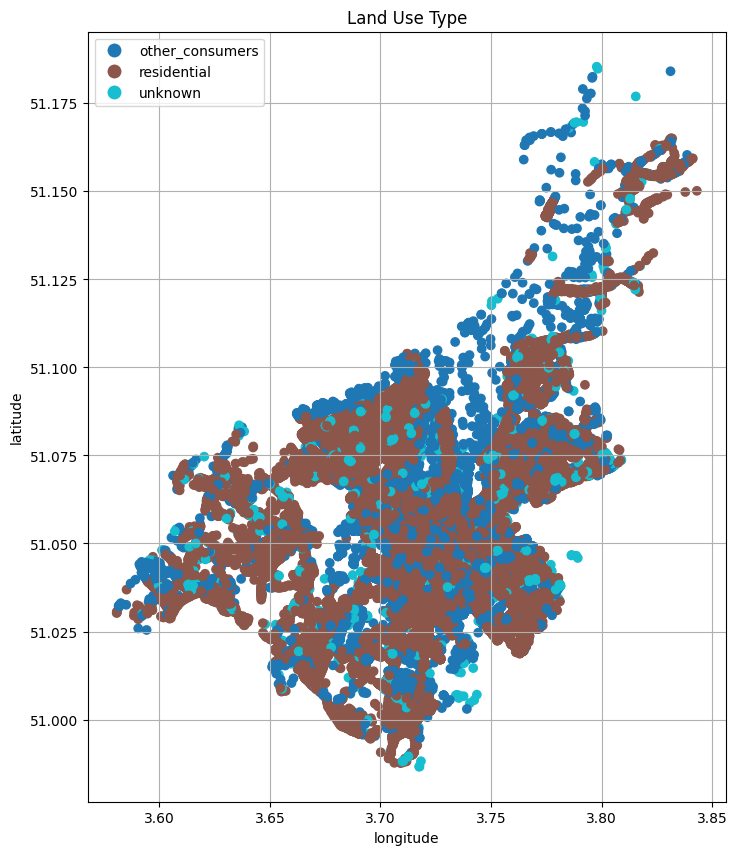

In [ ]:
import matplotlib.pyplot as plt

# Plot the distribution of residential and non-residential areas in Ghent
df.to_crs(epsg=4326).plot(column="land_use_type", legend=True, figsize=(10, 10))

# Add labels and title
plt.title("Land Use Type")
plt.xlabel("longitude")
plt.ylabel("latitude")

# Add grid lines
plt.grid();

The plot shows that non-residential abuildings are interspersed throughout the city, so the final clusters of our model will have physical spaces between them.

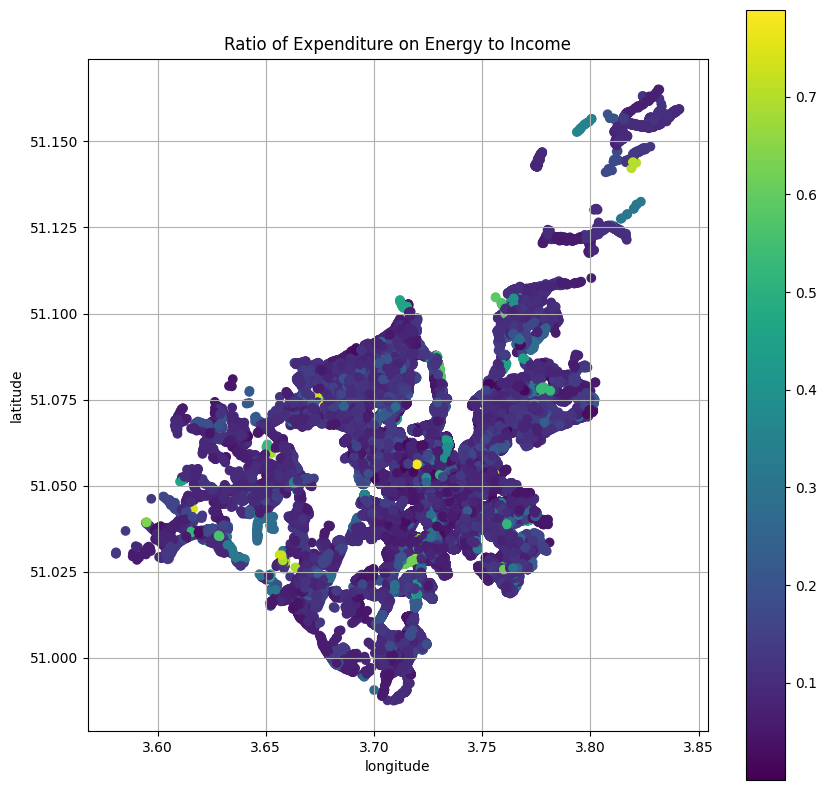

In [ ]:
# Plot the distribution of fuel poverty in Ghent
df_residential.to_crs(epsg=4326).plot(
    column="energy_cost_residential_percent_income", legend=True, figsize=(10, 10)
)

# Add labels and title
plt.title("Ratio of Expenditure on Energy to Income")
plt.xlabel("longitude")
plt.ylabel("latitude")

# Add grid lines
plt.grid();

The households that are most vulnerable to energy poverty (highest proportion of income spent on energy) are scattered throughout the city with a cluster identified in the Southwest region.

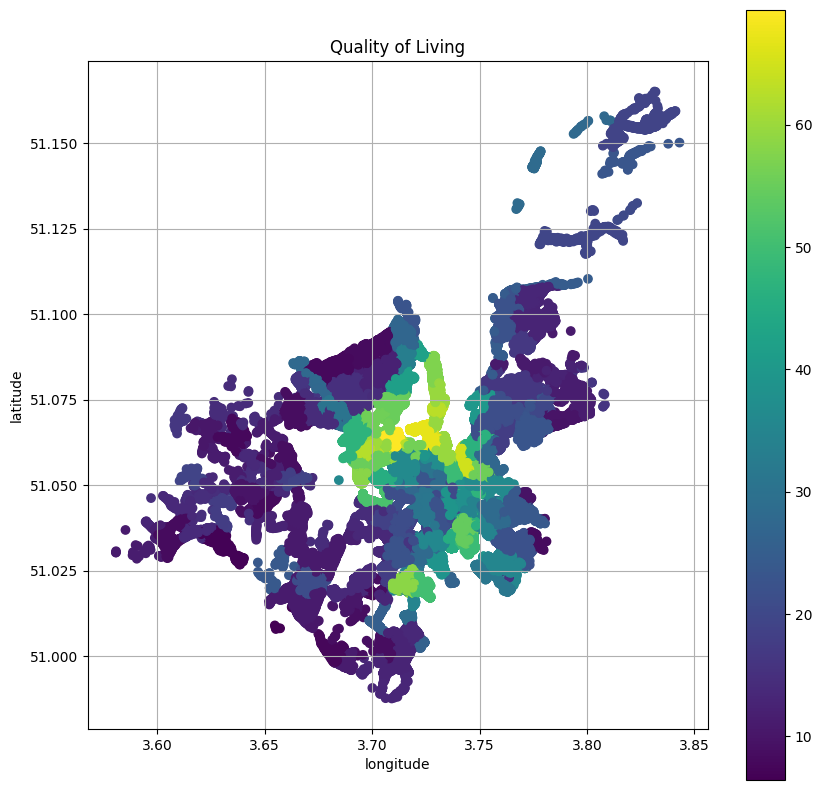

In [ ]:
# Plot the distribution of quality of living in Ghent
df_residential.to_crs(epsg=4326).plot(
    column="BIMD2011_score", legend=True, figsize=(10, 10)
)

# Add labels and title
plt.title("Quality of Living")
plt.xlabel("longitude")
plt.ylabel("latitude")

# Add grid lines
plt.grid();

Households with the highest quality of living index are concentrated in the centre of the city. The darkest areas suggest that the clusters created by our model would have the most impact on the West region of the city.

####Energy Production by Population <a name ='production_by_population'></a>
Below is a visualisation on how potential energy production scales to population in residential addresses.

True


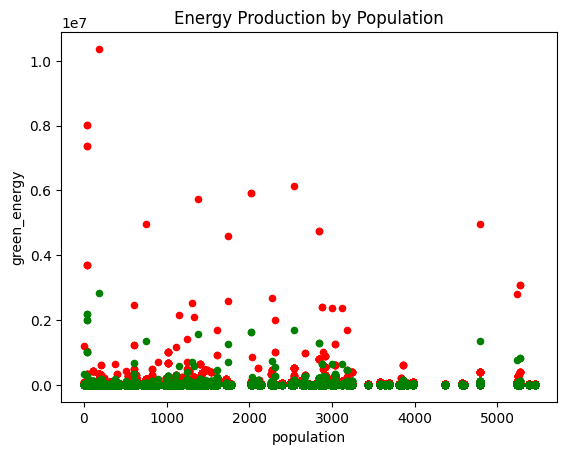

In [ ]:
import pandas as pd
import numpy as np  #

# start plotting fossil energy usage
ax1 = df_residential.plot(kind="scatter", x="population", y="fossil_energy", color="r")
# add on green energy usage plot onto first plot
ax2 = df_residential.plot(
    kind="scatter", x="population", y="green_energy", color="g", ax=ax1
)
plt.title("Energy Production by Population")
print(ax1 == ax2)

There is no clear pattern observed between population and prevalence for green energy use.

#### Snapshot of Interactive plots <a name ='interactive_plots'></a>

Load features from config to help with following EDA

In [ ]:
geometry_columns = config["Columns"]["geometry_columns"]
location_columns = config["Columns"]["location_columns"]
solar_columns = config["Columns"]["solar_columns"]
features = config["Columns"]["feature_columns"]
info_columns = config["Columns"]["info_columns"]

In [ ]:
df[solar_columns].describe()

,building_surface_area,building_length,solar_opportunity_area,solar_opportunity_3d,solar_irradiation,total_solar_irradiation,solar_id,energy_production,solar_to_address_distance
count,171703.000000,171703.000000,171703.000000,171703.000000,171703.000000,1.717030e+05,171703.000000,1.717030e+05,171703.000000
mean,167.218452,40.269943,35.277869,39.439602,585.517254,3.440654e+04,37660.556455,4.138636e+03,8.467821
std,1156.566096,74.236336,331.108726,333.916807,457.196158,3.327385e+05,40346.816135,3.066048e+04,21.137688
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000
50%,64.820000,37.760000,14.000000,16.000000,888.000000,1.304300e+04,23579.000000,1.707000e+03,1.960958
75%,110.910000,51.040000,30.000000,37.000000,958.000000,2.848400e+04,72577.500000,4.151000e+03,5.365368
max,127531.280000,3007.090000,54751.000000,54760.000000,1088.000000,5.534303e+07,122964.000000,4.936203e+06,199.846408


In [ ]:
df_top_energy = get_top_percentage(df, "energy_production", 1)
df_top_energy

,sector_code,geometry,postcode,sector,exp_score_income_domain,rank_income_domain,deciles_income_domain,exp_score_employment_domain,rank_employment_domain,deciles_employment_domain,...,other_electricity_offtake_address,residential_natural_gas_offtake_address,other_natural_gas_offtake_address,energy_cost_residential,energy_cost_residential_percent_income,solar_cost,top_10_per_energy_prod_in_500m,all_energy,green_energy,fossil_energy
147831,44021D190,"MULTIPOLYGON Z (((3.79726 51.09662 0.00000, 3....",9041,schansakker,5.996821,14402.0,8.000000,2.597382,16735.000,9.000000,...,2.240844e+04,NaN,1.613999e+04,NaN,NaN,15823039.0,5703925.0,3.854843e+04,8.276348e+03,3.027208e+04
147879,44021D471,"MULTIPOLYGON Z (((3.79196 51.13644 0.00000, 3....",9000,texaco,11.769230,11475.9,6.569643,7.098728,13756.125,7.748214,...,3.780419e+06,NaN,4.425802e+06,NaN,NaN,14576293.0,6050306.0,8.206222e+06,1.761876e+06,6.444346e+06
146938,44021M173,"MULTIPOLYGON Z (((3.72347 51.07296 0.00000, 3....",9000,oude lieve (wondelgem),88.134983,167.0,1.000000,59.509307,1185.000,1.000000,...,1.436254e+06,NaN,1.583419e+06,NaN,NaN,12151294.0,5254515.0,3.019673e+06,6.483239e+05,2.371350e+06
147954,44021D471,"MULTIPOLYGON Z (((3.79196 51.13644 0.00000, 3....",9000,texaco,11.769230,11475.9,6.569643,7.098728,13756.125,7.748214,...,4.560798e+05,NaN,4.648138e+05,NaN,NaN,9419088.0,5127387.0,9.208936e+05,1.977159e+05,7.231777e+05
147236,44021D670,"MULTIPOLYGON Z (((3.81059 51.15314 0.00000, 3....",9000,rodenhuize,12.033134,11021.0,6.000000,6.561143,14047.000,8.000000,...,5.714628e+06,NaN,5.460344e+05,NaN,NaN,9531509.0,3955198.0,6.260662e+06,1.344164e+06,4.916498e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147430,44021A42-,"MULTIPOLYGON Z (((3.70647 51.04925 0.00000, 3....",9000,neermeersen,47.966427,2117.0,2.000000,76.948791,425.000,1.000000,...,7.028592e+04,NaN,1.421001e+05,NaN,NaN,105196.0,1847512.0,2.123860e+05,4.559928e+04,1.667867e+05
94077,44021A410,"MULTIPOLYGON Z (((3.70651 51.04326 0.00000, 3....",9000,patijntje,28.053453,5369.0,3.000000,3.197068,16298.000,9.000000,...,NaN,11394.767326,NaN,2765.331972,0.103015,105774.0,1348892.0,1.641509e+04,3.524320e+03,1.289077e+04
127853,44021A31-,"MULTIPOLYGON Z (((3.72876 51.04767 0.00000, 3....",9000,nederkouter,63.049703,981.0,1.000000,17.626368,8589.000,5.000000,...,NaN,6648.416789,NaN,1406.018610,0.064868,107219.0,2898506.0,8.963289e+03,1.924418e+03,7.038871e+03
169346,44021A42-,"MULTIPOLYGON Z (((3.70647 51.04925 0.00000, 3....",9000,neermeersen,47.966427,2117.0,2.000000,76.948791,425.000,1.000000,...,1.225454e+04,NaN,2.286384e+04,NaN,NaN,67337.0,2398597.0,3.511839e+04,7.539917e+03,2.757847e+04


In [ ]:
fig = go.Figure()
# Add scattermapbox trace
fig.add_trace(
    go.Scattermapbox(
        lat=df["lat"],
        lon=df["lon"],
        mode="markers",
        marker=dict(
            size=5,
            opacity=0.5,
            color=df["rank_income_domain"],
            colorscale="RdYlGn",
            showscale=True,
        ),
    )
)
# Update map layout
fig.update_layout(
    mapbox=dict(style="carto-positron", zoom=10, center=dict(lat=51.05, lon=3.73))
)
fig.add_trace(
    go.Scattermapbox(
        lat=df_top_energy["lat"],
        lon=df_top_energy["lon"],
        mode="markers",
        marker=dict(size=4, color="black", opacity=0.7),
        text=df_top_energy["energy_production"],
    )
)
fig.show()

The plot shows that areas with the highest potential for solar energy production are around the city centre, which supports our aim of providing renewable energy to households with lower standards of living.

Embedding interactive plotly:

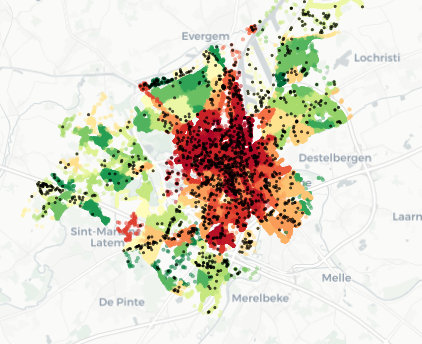

### Feature Selection <a name ='feature_selection'></a>
Now we have created some potentially useful features for this problem, we want to reduce them to ones that will be most useful for optimisation. We can do this using PCA and also by looking at correlation


#### PCA <a name ='pca'></a>

Trying PCA to see if we can reduce the dimensionality of the data and assess the importance of the features (without labels to use)

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, OrdinalEncoder
from sklearn.compose import ColumnTransformer

In [ ]:
X = df_residential[info_columns + solar_columns]

# Transform for modelling
ct = ColumnTransformer(
    [
        (
            "text_preprocess",
            OrdinalEncoder(),
            X.select_dtypes(include="object").columns.to_list(),
        ),
        (
            "num_preprocess",
            StandardScaler(),
            X.select_dtypes(include="number").columns.to_list(),
        ),
    ]
)

X_t = pd.DataFrame(ct.fit_transform(X), columns=X.columns)

# drop energy_cost_residential_percent_income nulls for the purpose of PCA analysis
X_t = X_t.dropna()

In [ ]:
X_t

,exp_score_income_domain,rank_income_domain,deciles_income_domain,exp_score_employment_domain,rank_employment_domain,deciles_employment_domain,exp_score_edu_domain,rank_edu_domain,deciles_edu_domain,exp_score_hous_domain,...,building_cat,building_surface_area,building_length,solar_opportunity_area,solar_opportunity_3d,solar_irradiation,total_solar_irradiation,solar_id,energy_production,top_10_per_energy_prod_in_500m
0,1026.0,0.0,0.0,1963.0,5422.0,2.0,4.0,0.868758,-0.773512,-0.799223,...,0.520203,-0.226749,-0.738885,-0.450650,-0.500690,-1.423038,-0.445141,-1.002364,-0.539260,1.612792
1,1026.0,0.0,0.0,1963.0,5422.0,2.0,4.0,0.868758,-0.773512,-0.799223,...,0.520203,-0.226749,-0.738885,-0.450650,-0.500690,-1.423038,-0.445141,-1.002364,-0.539260,1.612792
2,1026.0,0.0,0.0,1963.0,5422.0,2.0,4.0,0.868758,-0.773512,-0.799223,...,0.520203,-0.226749,-0.738885,-0.450650,-0.500690,-1.423038,-0.445141,-1.002364,-0.539260,1.612792
3,1026.0,0.0,0.0,1963.0,5422.0,2.0,4.0,0.868758,-0.773512,-0.799223,...,0.520203,-0.226749,-0.738885,-0.450650,-0.500690,-1.423038,-0.445141,-1.002364,-0.539260,1.274414
4,1026.0,0.0,0.0,1963.0,5422.0,2.0,4.0,0.868758,-0.773512,-0.799223,...,0.520203,-0.226749,-0.738885,-0.450650,-0.500690,-1.423038,-0.445141,-1.002364,-0.539260,1.274414
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
140061,904.0,0.0,0.0,2156.0,2235.0,1.0,2.0,0.476901,-0.641181,-0.799223,...,-0.092421,0.318415,1.144830,1.815612,1.669001,0.797478,1.843346,0.923483,1.327105,0.050433
140062,693.0,2.0,0.0,361.0,2896.0,1.0,2.0,-0.849027,0.483531,0.435740,...,-0.090414,-0.014701,0.185426,0.107199,0.029311,0.612623,0.082573,1.295000,-0.121289,-0.908675
140063,1907.0,3.0,0.0,1918.0,4879.0,1.0,2.0,-1.718186,2.596248,2.494011,...,0.621153,0.133565,0.566185,-0.136860,-0.169440,0.479617,-0.158884,1.735544,-0.190492,-0.612566
140064,661.0,4.0,0.0,1209.0,504.0,1.0,2.0,-1.685822,2.480539,2.494011,...,-0.084713,0.049691,0.222664,0.020035,-0.053502,0.572045,-0.010896,0.121266,-0.193571,-1.374450


Plot variance against number of components to see if there is a point where the variance drops off:

Function definition can be found above: [plot_explained_variance](#plot_explained_variance)

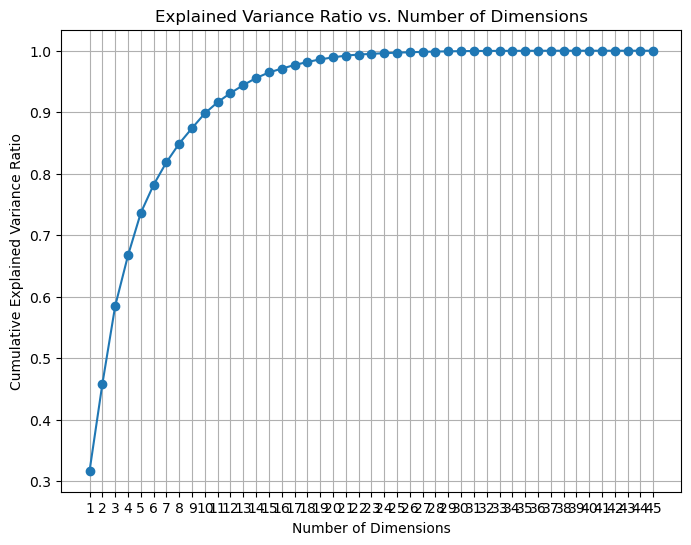

In [ ]:
plot_explained_variance(X_t)

We can get 90% of the variance with 10 components

In [ ]:
n_components = 10
pca = PCA(n_components=n_components)

In [ ]:
pca.fit(X_t)

PCA(n_components=10)

In [ ]:
X_pca = pca.transform(X_t)

#### Factor Loadings and Correlation <a name ='correlation'></a>


In [ ]:
pca_columns = [f"pca_{i}" for i in range(n_components)]
loadings = pca.components_.T * np.sqrt(pca.explained_variance_)

loading_matrix = pd.DataFrame(loadings, columns=pca_columns, index=X_t.columns)

In [ ]:
loading_matrix

,pca_0,pca_1,pca_2,pca_3,pca_4,pca_5,pca_6,pca_7,pca_8,pca_9
exp_score_income_domain,-0.881885,0.085724,-0.021226,0.159238,0.240571,-0.129858,-0.104248,0.006854,-0.124152,0.003265
rank_income_domain,0.851704,-0.096639,0.087275,-0.213043,-0.200144,0.244740,0.087740,-0.014286,0.105524,0.065678
deciles_income_domain,0.852579,-0.095424,0.080125,-0.204066,-0.184903,0.258085,0.075968,-0.014389,0.082180,0.087025
exp_score_employment_domain,-0.833186,0.033161,0.090009,0.026459,0.152490,0.373302,0.145915,-0.086063,-0.025432,-0.104291
rank_employment_domain,0.919413,-0.051623,-0.109660,0.006928,-0.098414,-0.173704,-0.061341,0.032041,0.021032,0.182104
deciles_employment_domain,0.915674,-0.055132,-0.117616,0.020526,-0.081268,-0.167194,-0.069192,0.032439,0.023519,0.188373
exp_score_edu_domain,-0.899341,0.061810,0.186558,-0.093299,-0.022456,0.191781,0.088992,-0.038197,-0.122502,-0.081557
rank_edu_domain,0.919635,-0.073323,-0.122551,0.051895,0.015028,-0.035901,-0.097640,0.030131,0.017230,0.130801
deciles_edu_domain,0.908806,-0.073283,-0.113727,0.044256,0.018363,-0.005184,-0.106482,0.032042,0.022686,0.154120
exp_score_hous_domain,-0.604684,0.115522,0.352767,-0.352928,-0.396614,-0.087762,-0.157123,0.114073,-0.174420,0.173988


PCA 0:


BIMD2011_rank              0.969228
BIMD2011_deciles_domain    0.957114
BIMD2011_score            -0.943349
rank_edu_domain            0.919635
rank_employment_domain     0.919413
Name: pca_0, dtype: float64

High Abs Correlation with other features:


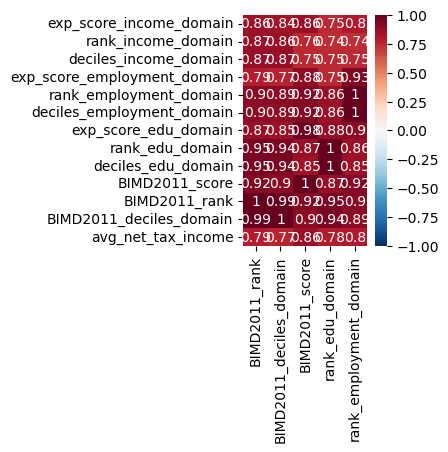




PCA 1:


energy_cost_residential_percent_income    0.944929
energy_cost_residential                   0.935961
all_energy                                0.930160
fossil_energy                             0.930160
green_energy                              0.930160
Name: pca_1, dtype: float64

High Abs Correlation with other features:


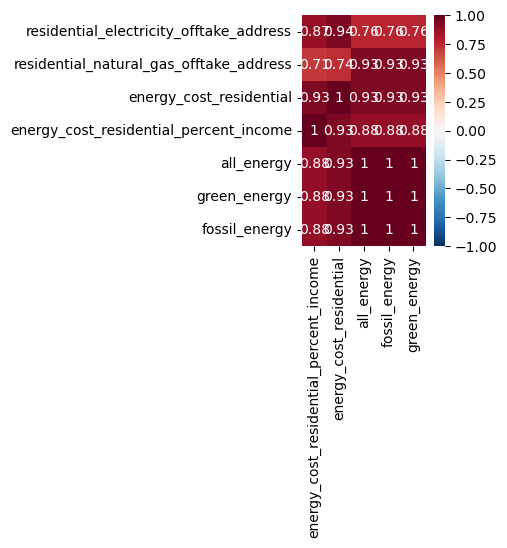




PCA 2:


solar_opportunity_3d       0.855866
energy_production          0.847655
solar_opportunity_area     0.846413
solar_cost                 0.846413
total_solar_irradiation    0.845036
Name: pca_2, dtype: float64

High Abs Correlation with other features:


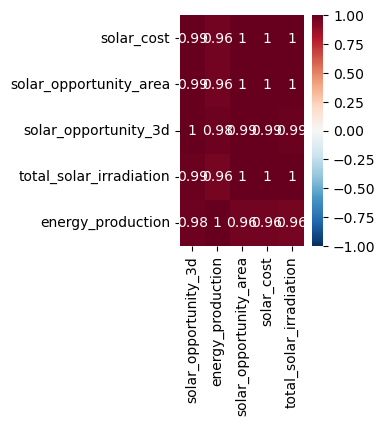




PCA 3:


number_access_points_electricity_offtake    0.671693
annual_energy_use_natural_gas_offtake       0.624565
annual_energy_use_electricity_offtake       0.590856
number_access_points_natural_gas_offtake    0.588999
installation_max_power                      0.429294
Name: pca_3, dtype: float64

High Abs Correlation with other features:


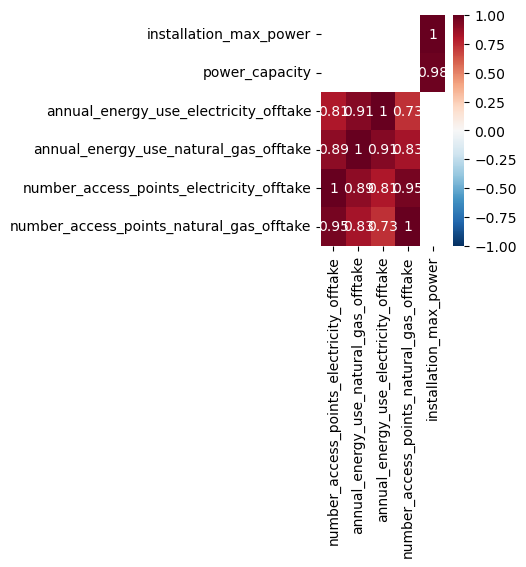




PCA 4:


number_access_points_natural_gas_offtake   -0.620265
number_access_points_electricity_offtake   -0.572811
annual_energy_use_natural_gas_offtake      -0.544523
annual_energy_use_electricity_offtake      -0.510478
top_10_per_energy_prod_in_500m              0.468731
Name: pca_4, dtype: float64

High Abs Correlation with other features:


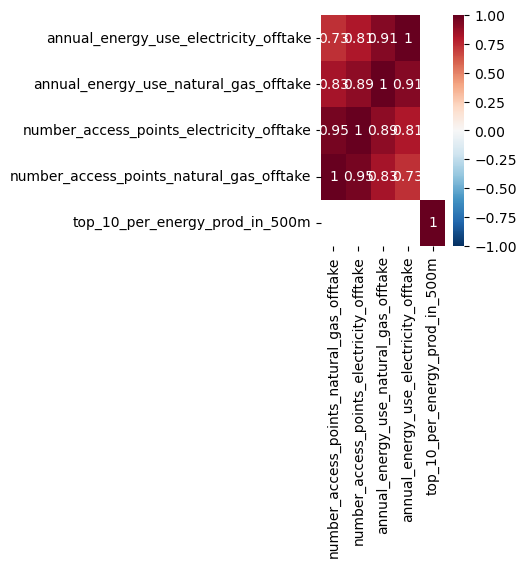




PCA 5:


interquartile_coeff_of_taxpayers       -0.718164
total_net_taxable_income               -0.651921
population                             -0.515697
exp_score_employment_domain             0.373302
interquartile_asymmetry_of_taxpayers   -0.287429
Name: pca_5, dtype: float64

High Abs Correlation with other features:


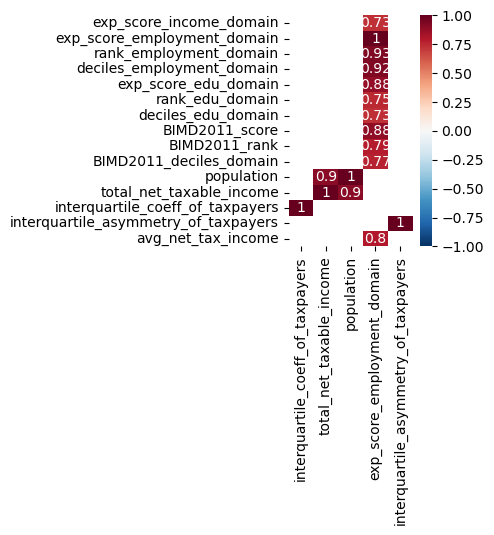




PCA 6:


total_net_taxable_income                0.627294
population                              0.618595
interquartile_coeff_of_taxpayers       -0.374657
interquartile_asymmetry_of_taxpayers   -0.365768
exp_score_health_domain                -0.259956
Name: pca_6, dtype: float64

High Abs Correlation with other features:


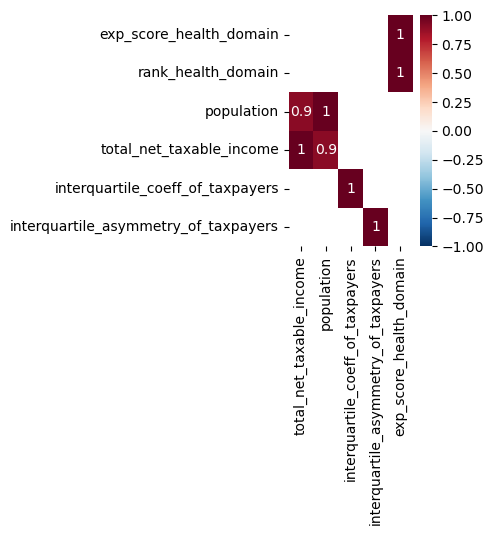




PCA 7:


building_surface_area     -0.734093
building_length           -0.669732
solar_irradiation         -0.208571
total_solar_irradiation    0.174647
solar_opportunity_area     0.170408
Name: pca_7, dtype: float64

High Abs Correlation with other features:


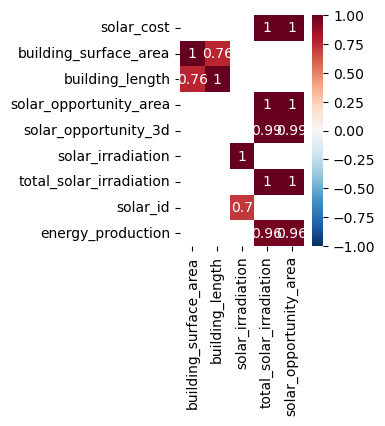




PCA 8:


exp_score_health_domain                 0.584736
rank_health_domain                     -0.584401
interquartile_coeff_of_taxpayers       -0.317403
interquartile_asymmetry_of_taxpayers    0.254075
total_net_taxable_income                0.211671
Name: pca_8, dtype: float64

High Abs Correlation with other features:


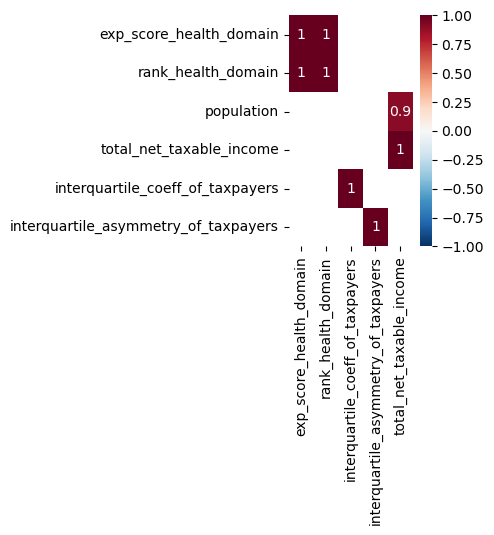




PCA 9:


interquartile_asymmetry_of_taxpayers   -0.675128
power_capacity                          0.365999
installation_max_power                  0.322739
exp_score_health_domain                 0.233458
rank_health_domain                     -0.232857
Name: pca_9, dtype: float64

High Abs Correlation with other features:


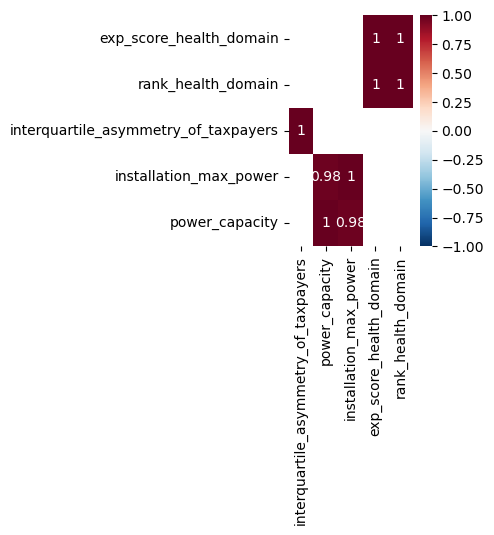

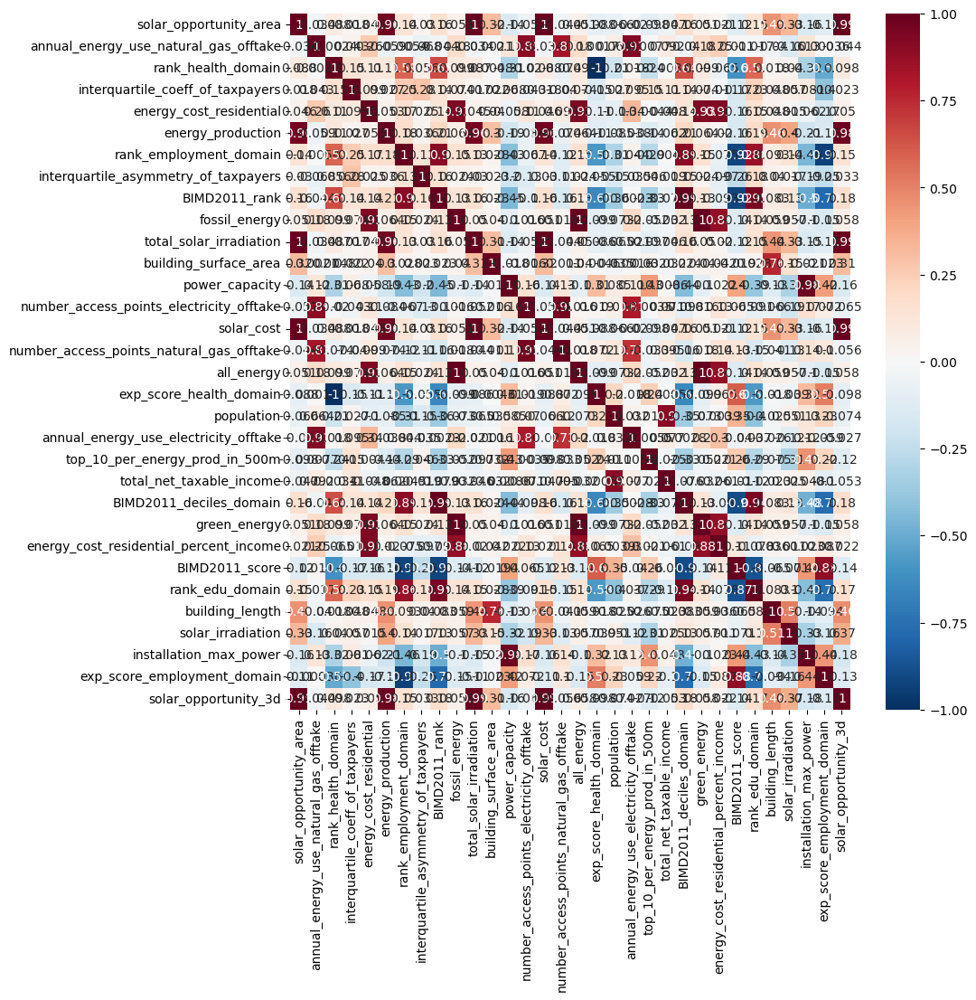

In [ ]:
# For each principal component display the features with the top 5 highest loadings (and their loadings)
feature_pool = []
for i in range(n_components):
    top_5 = loading_matrix.iloc[:, i].abs().sort_values(ascending=False).head(5)

    print(f"PCA {i}:")
    display(loading_matrix.loc[top_5.index, f"pca_{i}"])
    # find the the features in X with and abs correlation greater than 0.5 with the top 3 features
    top_5_corr = X_t.corr()[top_5.index].abs()
    top_5_corr = top_5_corr[top_5_corr > 0.7].dropna(how="all")
    print("High Abs Correlation with other features:")
    plt.figure(figsize=(2, 3))
    sns.heatmap(top_5_corr, annot=True, cmap="RdBu_r", vmin=-1, vmax=1)
    plt.show()
    print("\n\n")

    feature_pool.extend(top_5.index.to_list())

feature_pool = list(set(feature_pool))

# plot a correlation heatmap of the features with the top 5 highest loadings for each principal component
plt.figure(figsize=(10, 10))
sns.heatmap(df[feature_pool].corr(), annot=True, cmap="RdBu_r", vmin=-1, vmax=1)
plt.show()

From the top loadings, we can select either the most correlated features or another option (if the features are too correlated with another)

#### Feature Selection Reasoning <a name ='feature_reasoning'></a>

Features selected according to the 9 principal components with the highest explained variance. The features selected are the ones with the highest factor loading in each of the 9 principal components. The features selected (where possible) not to correlate with the other features.

- PC 0 -> BIMD2011_score (One of the Highest Factor Loading in the strongest principal component, and is more intuitive that the other BIMD2011 features).
- PC 1 -> energy_cost_residential_percent_income (Second Highest Factor Loading in the second strongest principal component. This is also an intuitive feature for planning energy communities as it can be related to energy poverty definitions)
- PC 2 -> energy_production,solar_cost (Highly Correlated with this dimension). Both are being selected despite being correlated as they are both intuitive features for planning energy communities (even though both want offer much more value than the other)
- PC 3 -> number_access_points_electricity_offtake (Strong loading and not correlated with any other features)
- PC 4 -> top_10_per_energy_prod_in_500m  (Strong loading and not correlated with any other features) population (not correleted and good indicator of density)
- PC 5 -> interquartile_coeff_of_taxpayers  (Strong loading and not correlated with any other features)
- PC 6 -> None (Already included or highly correlated with existing features)
- PC 7 -> None (Already included or highly correlated with existing features)
- PC 8 -> exp_score_health_domain (not correlated with existing feature
- -PC 9 -> power capcity (not correlated with existing feature)

Manually selected features:
- avg_net_tax_income (could be useful for policy makers)
- green_energy (this is 0.88 correlated with energy_cost_residential_percent_income, but may be preferred by policy makers, depending on goals)

**list of features to include (selected_columns in config.yaml):**
- BIMD2011_score
- energy_cost_residential_percent_income
- energy_production (solar data)
- solar_cost (solar data)
- number_access_points_electricity_offtake
- top_10_per_energy_prod_in_500m
- interquartile_coeff_of_taxpayers
- population
- exp_score_health_domain
- power_capacity
- avg_net_tax_income
- green energy


### Modelling <a name ='modelling'></a>
To shape this problem into a modelling or optimisation problem, we initially considered a number of techniques. These are listed below, alongside any useful documentations we read:

*   Rule based
*   Clustering algorithms:
  - KMeans [doc](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html)
  - Spectral clustering [doc](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html)
  - HDBSCAN [doc](#https://hdbscan.readthedocs.io/en/latest/how_hdbscan_works.html)
* Spatial optimsation algorithms:
  - pygeoda - [doc](#https://geodacenter.github.io/pygeoda/spatial_clustering.html)
  - spopt - [doc](https://pysal.org/spopt/)
  - spatial weights - [doc](http://darribas.org/gds_scipy16/ipynb_md/03_spatial_weights.html)
  - Spatially constrained hierarchical clustering (SCHC) using GeoDa software - [doc](#http://geodacenter.github.io/workbook/9c_spatial3/lab9c.html)
  - Fair clustering - [doc](https://arxiv.org/pdf/1910.05113.pdf)
  - Regionalisation - [doc](http://darribas.org/gds_scipy16/ipynb_md/07_spatial_clustering.html)
  - Pygmo - [doc](https://esa.github.io/pygmo2/tutorials/coding_udp_simple.html)

* Reinforcement algorithm - TF-Agent, Deep Q-Learning in particular [doc](https://www.tensorflow.org/agents/tutorials/0_intro_rl)
* Formulating as an allocation or set covering problem then using an optimisation algorithm [doc](https://pysal.org/spopt/)


Due to computing power, we first started with a simple rule based & k means clustering algorithm.

We than tested out other clustering and spatial optimisation algorithms, but due to the complexity of the problem and compute power, these were less efficient for our needs. However, we did get a sample running using pygeoda.

Due to this, we chose to try another approach with reinforcment learning.


#### Rules Then Spatial Clustering <a name ='rules_spatial'></a>

The minimum valuable product **(MVP)** is to create a process that first filters down the population to a pool of addresses that would benefit from being part of an energy community (independent of location)

Then a clustering algorithm is used to cluster on just lattitude and longitude to group these potential participants into energy communities.

This approach could have the following **advantages**:
- Quick: would allow the model user to change conditions and parameters in real time as they explore different options.
- Easy to implement in a dashboard to allow for interactivity
- Scalable: No fine tuning is required.
- Flexible: would allow alot of control in terms of numbers of clusters as well as size (through intial filtering)
- Conditions and parameters can be easily adapted to policy/ needs and would allow for subject matter experts to help shape the communities (with the aid of the underlying model)

But also has **disadvantages**:
- Will not rank the communities only offer a selection to choose from
- Wont' optimize for features

##### Create a set of conditions for filtering the data set

In [ ]:
# define criteria
criteria = {
    "avg_net_tax_income": ("<", 23000),
    "energy_cost_residential_percent_income": (">", 0.08),
    "BIMD2011_score": ("<", 40),
    "top_10_per_energy_prod_in_500m": (">", 1000000),
}

##### Define a Class for Inference and Evaluation

To make this model easy to use (and scalable to other algorithms) we can wrap it in a class to aid in the workflow of creating energy communties.

The class is defined [here](#CommunitySelect)

In [ ]:
# it's intialized by
community = CommunitySelect(df)

# create the communities/clusters using the criteria and clustering
community.create(criteria=criteria, algorithm="spatial_cluster", num_clusters=20)

In [ ]:
# summary statistics can then be produced for each community to aid in definition
community_summary = community.get_cluster_summary()
community_summary

,exp_score_income_domain,rank_income_domain,deciles_income_domain,exp_score_employment_domain,rank_employment_domain,deciles_employment_domain,exp_score_edu_domain,rank_edu_domain,deciles_edu_domain,exp_score_hous_domain,...,lon,avg_net_tax_income_rank_value,energy_cost_residential_percent_income_rank_value,BIMD2011_score_rank_value,top_10_per_energy_prod_in_500m_rank_value,cluster,elapsed_time,lat_centroid,lon_centroid,ranked_mean
cluster,,,,,,,,,,,,,,,,,,,,,
0,22.287039,7582.802309,4.343434,13.028558,10641.051948,5.981241,24.269551,6553.688312,3.757576,29.313874,...,3.755214,0.506593,0.383459,0.322027,0.604533,0.0,1.484783,51.062672,3.755220,0.454153
1,27.092841,6004.364347,3.666927,10.113254,12143.947615,6.628616,30.301189,5554.885848,3.234558,38.136049,...,3.682412,0.441459,0.406073,0.400878,0.558566,1.0,1.484783,51.073547,3.682412,0.451744
2,47.217929,2217.206407,1.896110,15.906042,9427.442105,5.759268,31.383584,4804.855835,3.275973,44.961591,...,3.726373,0.585542,0.278916,0.527232,0.512577,2.0,1.484783,51.031964,3.726373,0.476067
3,17.825765,8755.400766,4.900383,17.543381,8714.412261,5.094253,40.831208,3265.639847,2.301916,37.532846,...,3.714918,0.416555,0.413048,0.441990,0.510555,3.0,1.484783,51.091414,3.714918,0.445537
4,29.479738,5105.842742,2.917742,10.513658,11889.967742,6.622581,33.521610,4386.680645,2.717742,45.880299,...,3.757086,0.501281,0.393513,0.466118,0.421794,4.0,1.484783,51.043816,3.757086,0.445676
5,10.719760,11731.069519,6.925134,3.703651,16114.074866,9.010695,17.106723,9027.053476,5.256684,15.448548,...,3.784367,0.584653,0.310732,0.134266,0.526297,5.0,1.484783,51.079598,3.784367,0.388987
6,16.705400,9395.990909,5.378788,4.002112,15759.469697,8.628283,4.346260,15551.968687,8.903030,34.702170,...,3.659598,0.644949,0.420266,0.148228,0.584889,6.0,1.484783,51.052123,3.659598,0.449583
7,63.638801,950.000000,1.000000,32.881637,4306.000000,3.000000,37.993869,3399.000000,2.000000,10.629390,...,3.714738,0.407120,0.274195,0.601548,0.077969,7.0,1.484783,51.052971,3.714738,0.340208
8,7.352911,13750.579934,7.732084,4.874070,15171.398015,8.478501,23.488622,7186.647189,4.620728,22.024919,...,3.769856,0.529184,0.315030,0.205558,0.573263,8.0,1.484783,51.099584,3.769856,0.405759


To evaluate the clusters we can consider the average rank of our selected features in each cluster. The ranks are taken from the original popluation and ordered so that 1 corresponds to the optimal value for that feature.

<Axes: xlabel='cluster'>

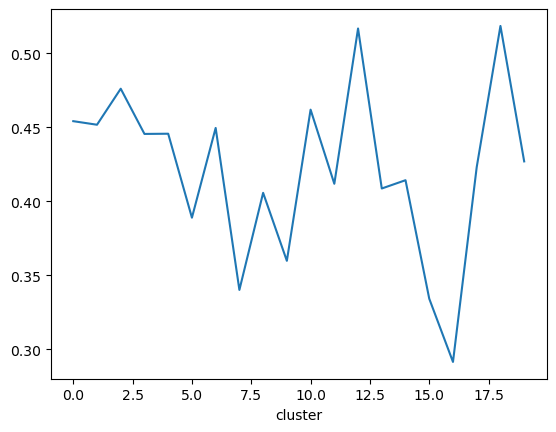

In [ ]:
grouped.ranked_mean.plot()

##### Linking these communities to Solar Sites

Even though proximity to solar energy is alreadt considered, users would need to be able to see ppotential locations for solar pannel sights in the area of community.

We've deliberetly included several options, as it is difficult to determine things like likelyhood of getting permission to mount solar panels.



In [ ]:
# reduce df_solar so it includes only the solar sites within x meters from the selected communities
df_solar_top = get_possible_sites(X_cluster, df_solar, 500)

# plot clusters
fig = map_scatter_plot(X_cluster)
# add top percent solar
fig = top_n_map_scatter_plot(df_solar_top, "energy_production", 200, fig)

fig.show()

As this function is using plotly, an emded image of the output is shown below. Based on overlap of top solar sites and communities there are some good options:

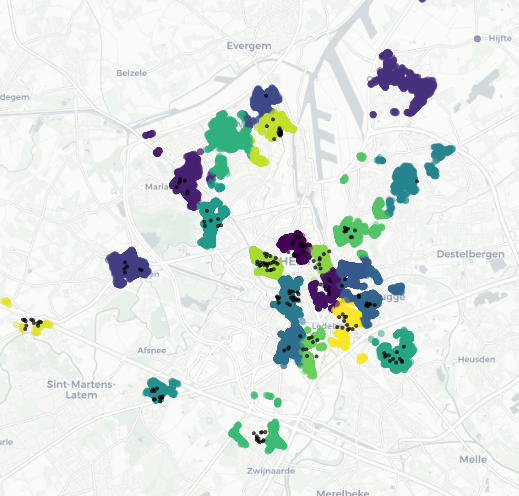

#### Spatial Optimisation <a name ='spatial_optimisation'></a>
Unfortunately, due to lack of compute, we were not able to run this algorithm on our full data set, but the code we used can be found in the appendix [here](#spatial_appendix)


#### Reinforcement Learning <a name ='reinforcement_learning'></a>


In [ ]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import abc
import tensorflow as tf
import numpy as np

from sklearn.preprocessing import MinMaxScaler

from sklearn.cluster import KMeans
from shapely.geometry import LineString, Point, Polygon

from tf_agents.policies.epsilon_greedy_policy import EpsilonGreedyPolicy
from tf_agents.specs import BoundedTensorSpec, TensorSpec
from tf_agents.environments import py_environment
from tf_agents.environments import tf_environment
from tf_agents.environments import tf_py_environment
from tf_agents.environments import utils
from tf_agents.specs import array_spec
from tf_agents.environments import wrappers
from tf_agents.environments import suite_gym
from tf_agents.trajectories import time_step as ts

##### **Prep data**

- First reduce possible population down by filtering for features relevent to our equality,scoial and efficiency goals

- Prepocess so that all features are between 0 and 1 and ordered to reflect the priorities for creating energy communities

- Take another sub sample to help with runtime of the algorithm

In [ ]:
df[selected_columns].describe()

,BIMD2011_score,energy_cost_residential_percent_income,energy_production,solar_cost,number_access_points_electricity_offtake,top_10_per_energy_prod_in_500m,interquartile_coeff_of_taxpayers,exp_score_health_domain,power_capacity,avg_net_tax_income
count,138545.000000,136501.000000,138545.000000,1.385450e+05,138545.000000,1.385450e+05,138545.000000,138545.000000,138545.000000,138545.000000
mean,33.948085,0.117061,3299.651413,7.426248e+03,193.805222,1.627326e+06,85.749901,12.846431,20706.136063,20498.179934
std,16.867583,0.085698,6175.471482,1.661730e+04,238.860978,9.484043e+05,9.919681,0.527437,10596.021696,4386.253696
min,6.438670,0.000566,0.000000,0.000000e+00,3.000000,0.000000e+00,45.000000,11.580312,4311.825000,9797.000000
25%,21.088685,0.074723,0.000000,0.000000e+00,56.000000,9.095200e+05,82.000000,12.407732,7214.831000,17189.000000
50%,30.840503,0.097110,2156.000000,4.335000e+03,112.000000,1.433319e+06,86.000000,12.977069,28869.420000,20905.000000
75%,49.378098,0.127273,4301.000000,8.959000e+03,235.000000,2.122599e+06,91.000000,13.248808,28869.420000,23319.000000
max,69.375847,0.788818,520902.000000,1.641520e+06,1450.000000,5.278543e+06,129.000000,13.804318,28869.420000,33468.000000


In [ ]:
# define criteria
criteria = {
    "avg_net_tax_income": ("<", 23000),
    "energy_cost_residential_percent_income": (">", 0.07),
    "BIMD2011_score": ("<", 50),
    "top_10_per_energy_prod_in_500m": (">", 1000000),
}

community = CommunitySelect(df)

train_df = community.select_participants(criteria)

In [ ]:
train_df

,sector_code,geometry,postcode,sector,exp_score_income_domain,rank_income_domain,deciles_income_domain,exp_score_employment_domain,rank_employment_domain,deciles_employment_domain,...,lon_solar,residential_electricity_offtake_address,residential_natural_gas_offtake_address,energy_cost_residential,energy_cost_residential_percent_income,solar_cost,top_10_per_energy_prod_in_500m,all_energy,green_energy,fossil_energy
476,44021A01-,"MULTIPOLYGON Z (((3.72929 51.05999 0.00000, 3....",9000,sint-jacobs,60.211581,1142.0,1.0,31.704390,4545.0,3.0,...,3.729020,3634.701111,12648.330556,2415.116804,0.116201,0.0,3591969.0,16283.031667,3495.966899,12787.064768
477,44021A01-,"MULTIPOLYGON Z (((3.72929 51.05999 0.00000, 3....",9000,sint-jacobs,60.211581,1142.0,1.0,31.704390,4545.0,3.0,...,3.729020,3634.701111,12648.330556,2415.116804,0.116201,0.0,3591969.0,16283.031667,3495.966899,12787.064768
478,44021A01-,"MULTIPOLYGON Z (((3.72929 51.05999 0.00000, 3....",9000,sint-jacobs,60.211581,1142.0,1.0,31.704390,4545.0,3.0,...,3.729020,3634.701111,12648.330556,2415.116804,0.116201,0.0,3591969.0,16283.031667,3495.966899,12787.064768
479,44021A01-,"MULTIPOLYGON Z (((3.72929 51.05999 0.00000, 3....",9000,sint-jacobs,60.211581,1142.0,1.0,31.704390,4545.0,3.0,...,3.729020,3634.701111,12648.330556,2415.116804,0.116201,0.0,3630309.0,16283.031667,3495.966899,12787.064768
480,44021A01-,"MULTIPOLYGON Z (((3.72929 51.05999 0.00000, 3....",9000,sint-jacobs,60.211581,1142.0,1.0,31.704390,4545.0,3.0,...,3.729020,3634.701111,12648.330556,2415.116804,0.116201,0.0,3630309.0,16283.031667,3495.966899,12787.064768
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168678,44021F110,"MULTIPOLYGON Z (((3.78111 51.03007 0.00000, 3....",9050,sportplein,26.724222,5703.0,4.0,1.986540,17192.0,10.0,...,3.766106,4497.427839,8337.971998,2301.716952,0.102353,6069.0,1193738.0,12835.399837,2755.760345,10079.639492
168679,44021D10-,"MULTIPOLYGON Z (((3.77650 51.08229 0.00000, 3....",9041,lourdes,8.868164,12683.0,7.0,2.545967,16773.0,9.0,...,3.782397,24789.027024,34590.920952,11619.341903,0.530685,1734.0,1163917.0,59379.947976,12748.874830,46631.073146
168703,44021M03-,"MULTIPOLYGON Z (((3.72045 51.09170 0.00000, 3....",9032,woestijnegoed - molenhoek,16.843152,8895.0,5.0,17.162429,8769.0,5.0,...,3.717166,2675.746870,9509.628522,1796.553836,0.085388,4624.0,1844974.0,12185.375391,2616.200097,9569.175295
168720,44021E052,"MULTIPOLYGON Z (((3.76913 51.07010 0.00000, 3....",9040,rozebroeken,9.161803,12519.0,7.0,15.896587,9279.0,5.0,...,3.758924,8022.496084,18886.593133,4482.648023,0.204809,4335.0,1266160.0,26909.089217,5777.381455,21131.707762


In [ ]:
def rl_data_prep(
    df,
    mininmize_or_maximize,
    geo_column="coordinates",
    sample_size=5000,
    null_column="energy_cost_residential_percent_income",
    seed=0,
):
    # set columns
    columns = list(mininmize_or_maximize.keys())
    df_train = df[columns + [geo_column]].copy()
    # reduce down for experimenting
    df_train = df_train.dropna(subset=[null_column]).sample(sample_size)

    # convert coordinates to meters
    df_train["coordinates"] = df_train["coordinates"].to_crs(epsg=3857)
    df_train = df_train.set_geometry("coordinates")

    # scale the data so that all values are between 0 and 1
    scaler = MinMaxScaler()
    df_train_scaled = scaler.fit_transform(df_train[columns])
    df_train_scaled = pd.DataFrame(
        df_train_scaled, columns=columns, index=df_train.index
    )
    # set any negative values to 0
    df_train_scaled = df_train_scaled.applymap(lambda x: 0 if x <= 0 else x)

    df_train_scaled[geo_column] = df_train[geo_column].copy()

    # adjust meatures so that a higher value is always better (for the enrgy community problem)
    for column in mininmize_or_maximize.keys():
        if mininmize_or_maximize[column] == "min":
            df_train_scaled[column] = 1 - df_train_scaled[column]

    return gpd.GeoDataFrame(df_train_scaled).set_geometry(geo_column)

In [ ]:
# define the positive direction of the feature (i.e is higher better or lower better)
# if lower is better then set to 1- value
mininmize_or_maximize = {
    "avg_net_tax_income": "min",
    "energy_cost_residential_percent_income": "max",
    "BIMD2011_score": "min",
    "top_10_per_energy_prod_in_500m": "max",
}

df_train = rl_data_prep(train_df, mininmize_or_maximize, sample_size=14000)

df_train

,avg_net_tax_income,energy_cost_residential_percent_income,BIMD2011_score,top_10_per_energy_prod_in_500m,coordinates
66367,0.053382,0.282166,0.524924,0.016180,POINT (414341.893 6626299.916)
87685,0.525968,0.241772,0.398149,0.102118,POINT (413544.007 6637257.490)
125363,0.332370,0.981339,0.661143,0.046673,POINT (418801.896 6639105.492)
18667,0.706144,0.103232,0.446915,0.395034,POINT (414649.382 6628712.972)
42290,0.053382,0.282166,0.524924,0.067896,POINT (414323.855 6626432.790)
...,...,...,...,...,...
101509,0.052555,0.044971,0.667973,0.046214,POINT (419768.935 6626040.020)
71352,0.370986,0.024157,0.454599,0.066228,POINT (410057.731 6633946.119)
153267,0.668147,0.117998,0.057113,0.107087,POINT (410948.855 6632466.011)
30106,0.668147,0.016719,0.057113,0.021727,POINT (411513.717 6633040.566)


In [ ]:
# cathching bug from minmax scaler
df_train.loc[df_train.avg_net_tax_income < 0, "avg_net_tax_income"] = 0

##### **Define the process being optimized**


**Plan**

We need to define the actions an 'agent' can take in the enviroment, as well as the rewards those actions can result in. The RL model will then be trained to maximize the reward be choosing the best possible action at each step, eventually selecting enough participants to form the energy communities.

**Actions**

- Choose a new participant by selecting a row
  * The selection should be made by selecting the row with the best possible feature value
  * Each action will correspond to selecting a row by choosing the row with the best feature value
  * For example, action 0 will always choose the row closest to the centroid of the existing cluster
  * Or action 1 would be selecting the row with the lowest BIMD score
  * The features have been propocessed so that higher values (apart from geometry) correspond to the values we want to prioritize (e.g a a BIMD score of 1 will correspond to the lowest value in the un processed data and 0 the highest)
- Move on to a new cluster

**Observations**

- mean values of each feature in the group with the new participants
- current cluster size
- Total number of participants in a cluster

**Rewards**

These have been chosen after some experimation, but more tuning could be done to choose more appropriate reward structures.

- +1 for each cluster mean higher than the mean for the whole population
- +0.1 if the mean distance apart is within a predifined range
- -0.1 if the cluster exceeds 20

##### **Create Helper Functions**
These helper functions have not been included in our helpers at the top of the notebook [here](#define_helpers). This is because we chose to use the MVP algorithm of rules/spatial clustering for the dashboard for now as it is speedy and relatively efficient. However, as seen below the reinforcement learning method is very promising, and would benefit from some more subject matter expert input.

In [ ]:
# helper for returning the mean values of the group (including mean distance)
def calculate_mean_values(df):
    # calculate mean of feature calcomns
    value_cols = [col for col in df.columns if col != "coordinates"]
    mean_values_df = df[value_cols].mean()

    # calculate mean distancebetween points
    # this is computationally intensive and should be improved
    mean_distance_df = (
        df["coordinates"]
        .apply(
            lambda g: gpd.GeoDataFrame(df["coordinates"])
            .set_geometry("coordinates")
            .distance(g)
        )
        .mean()
        .mean()
    )

    all_mean_values = np.append(mean_values_df, mean_distance_df)
    return all_mean_values

In [ ]:
def calculate_state(df, count, starting_values):
    # take mean of features and distance in the current cluster
    mean_values = calculate_mean_values(df)

    # get current cluster size and overall steps
    cluster_size = df.shape[0]
    overall_size = count

    state = np.append(mean_values, np.array([cluster_size, overall_size]))
    return np.array(state)

In [ ]:
def calculate_reward(state, starting_values):
    # option to add weights to each score
    reward = 0
    i = 0
    # compare features to their means (from the whole population)
    for feature in state[:-3]:
        if feature > starting_values[i]:
            reward += 1
        i += 1

    # reward for more compact clusters (within 1km)
    if state[-3] < 1000:
        reward += 0.1

    # reward small clusters
    if state[-2] > 20:
        reward -= 0.1

    return reward

###### **Create Environment**

Create a custom python environment for the process of sequentially assigning the best participants to energy communities and for optimising the size.

In [ ]:
class CommunityEnv(py_environment.PyEnvironment):
    def __init__(self, df, distance_constraint=2000):
        # read parameters
        self.df = gpd.GeoDataFrame(df).set_geometry("coordinates")
        self.distance_constraint = distance_constraint
        self.df_original = self.df.copy()

        # define empty dataframe for storing addresses under the distance contraint for each episode
        self.df_select = gpd.GeoDataFrame()

        # move coordinates column to index 0 (to correspond with action 0)
        column = self.df["coordinates"]
        self.df = self.df.drop("coordinates", axis=1)
        self.df.insert(0, "coordinates", column)

        # max action number is the number of features (action for each feature and creating a new cluster) as first action is 0
        self.max = self.df.shape[1]
        # define possible actions
        self._action_spec = array_spec.BoundedArraySpec(
            shape=(),
            dtype=np.int32,
            minimum=np.array(0, dtype=np.int32),
            maximum=np.array(self.max, dtype=np.int32),
            name="action",
        )
        # define possible observation (mean feature values, current community size & total selected)
        self._observation_spec = array_spec.BoundedArraySpec(
            shape=(self.max + 2,),
            dtype=np.float32,
            minimum=np.array([0.0] * (self.max + 2), dtype=np.float32),
            name="observation",
        )
        # set state to be empty observation (all 0)
        self._state = np.array([0.0] * (self.max + 2), dtype=np.float32)
        # reset episode
        self._episode_ended = False

        # calculate mean feature values (including distance) of the intial population
        # This is needed for the reward function
        self.starting_values = calculate_mean_values(df)

        # define clustering df
        self.community_df = gpd.GeoDataFrame(
            columns=self.df.columns.to_list() + ["cluster", "orginal_index"]
        ).set_geometry("coordinates")

        # set itterators
        self.current_cluster = 0
        self.count = 0
        self.reward = 0

    def action_spec(self):
        return self._action_spec

    def observation_spec(self):
        return self._observation_spec

    def _reset(self):
        # perform resets
        self.count = 0
        self.df = self.df_original
        self._state = np.array([0.0] * (self.max + 2), dtype=np.float32)
        self.community_df = gpd.GeoDataFrame(
            columns=self.df.columns.to_list() + ["cluster", "original_index"]
        ).set_geometry("coordinates")
        self._episode_ended = False
        return ts.restart(self._state.astype("float32"))

    def _step(self, action):
        if self._episode_ended:
            # The last action ended the episode. Ignore the current action and start
            # a new episode.
            return self.reset()

        # set new count
        self.count += 1
        # boolean to determine if actions can be performed
        do_actions = True
        # define the size of the latest community/cluster
        cluster_size = self.community_df[
            self.community_df["cluster"] == self.current_cluster
        ].shape[0]

        # if cluster size >0 then restrict the dataframe to a radius of the first point (acting as centroid)
        if cluster_size == 1:
            # get the first point
            fixed_point = (
                self.community_df[self.community_df["cluster"] == self.current_cluster]
                .head(1)["coordinates"]
                .values[0]
            )

            # Define the radius
            radius = self.distance_constraint

            # Create a buffer around the fixed point
            buffer = fixed_point.buffer(radius)

            # Use spatial operation to select points within the buffer (df_select)
            df_select = gpd.GeoDataFrame(self.df).set_geometry("coordinates")
            df_select = df_select[df_select.geometry.within(buffer)]

            # This could be 0 if the radius is too small
            # If this is the case, move on to next cluster and do nothing
            if df_select.shape[0] == 0:
                self.current_cluster += 1
                do_actions = False
            self.df_select = df_select

        # if cluster is bigger than one, proceed with the the available population in the buffer
        elif cluster_size > 1:
            df_select = gpd.GeoDataFrame(self.df_select).set_geometry("coordinates")

        # if cluster size is < 1, this means the buffer hasn't been set (df_select)
        # so proceed with all available rows
        else:
            df_select = gpd.GeoDataFrame(self.df).set_geometry("coordinates")
            self.df_select = df_select

        # end episode if
        if self.count > 400 or self.df.shape[0] == 1:
            # if the last value is selected end the episode
            self._episode_ended = True

        else:
            if do_actions:
                # This action corresponds to starting a new cluster
                if action == self.max:
                    # if the second to last value is selected start a new cluster
                    self.current_cluster += 1

                # This action corresponds to choosing the address closest to the cluster centroid
                elif action == 0:
                    # if the first value is selected choose the closest point to the center of the cluster
                    # if now addresses are in the community yet, select a random row and use that as the centroid
                    if cluster_size == 0:
                        new_row = self.df.sample(1)
                        # drop from df
                        new_id = new_row.index[0]
                        self.df = self.df.drop(new_id)

                        # add to community df
                        self.community_df.loc[len(self.community_df)] = np.append(
                            new_row.values, np.array([self.current_cluster, new_id])
                        )

                        # select current cluster
                        cluster_df = self.community_df[
                            self.community_df["cluster"] == self.current_cluster
                        ]

                        # calculate state of the episode
                        state = calculate_state(
                            cluster_df.iloc[:, :-2], self.count, self.starting_values
                        )
                        self._state = state
                    else:
                        # find the instance that is clostest to the centroid of the current cluster
                        cluster = self.community_df[
                            self.community_df["cluster"] == self.current_cluster
                        ]
                        cluster = gpd.GeoDataFrame(cluster).set_geometry("coordinates")
                        centroid = cluster.dissolve().centroid[0]

                        # find id of closest row
                        closest_row_id = df_select.distance(centroid).idxmin()
                        new_row = df_select.loc[closest_row_id]

                        # drop from df and df_select so it can't be picked again
                        self.df = self.df.drop(closest_row_id)
                        self.df_select = df_select.drop(closest_row_id)

                        # move onto next cluster if there are no more points in the buffer
                        if self.df_select.shape[0] == 0:
                            self.current_cluster += 1

                        # add to community df
                        self.community_df.loc[len(self.community_df)] = np.append(
                            new_row.values,
                            np.array([self.current_cluster, closest_row_id]),
                        )

                        # select current cluster
                        cluster_df = self.community_df[
                            self.community_df["cluster"] == self.current_cluster
                        ]

                        # calculate state
                        state = calculate_state(
                            cluster_df.iloc[:, :-2], self.count, self.starting_values
                        )
                        self._state = state

                elif action in range(1, self.max):
                    # action corresponds to a column location between 0 and n_columns -2
                    column_loc = action

                    # select the max value in the corresponding column add to community df
                    select_index = df_select.iloc[:, int(column_loc)].idxmax()
                    new_row = df_select.loc[select_index]

                    # drop from both dfs
                    self.df = self.df.drop(select_index)
                    self.df_select = self.df_select.drop(select_index)

                    # move onto next cluster if buffer is now empty
                    if self.df_select.shape[0] == 0:
                        self.current_cluster += 1

                    # add to community df
                    self.community_df.loc[len(self.community_df)] = np.append(
                        new_row.values, np.array([self.current_cluster, select_index])
                    )

                    # select current cluster
                    cluster_df = self.community_df[
                        self.community_df["cluster"] == self.current_cluster
                    ]
                    state = calculate_state(
                        cluster_df.iloc[:, :-2], self.count, self.starting_values
                    )
                    self._state = state
                else:
                    raise ValueError("Not a valid action.")

        # calculate reward and the end of the step
        self.reward = float(calculate_reward(self._state, self.starting_values))

        # either end episode or pass values onto next step
        if self._episode_ended:
            return ts.termination(self._state.astype("float32"), self.reward)
        else:
            return ts.transition(
                observation=self._state.astype("float32"),
                reward=self.reward,
                discount=0.7,
            )

In [ ]:
# validate environment
environment = CommunityEnv(df_train, distance_constraint=2000)
utils.validate_py_environment(environment, episodes=10)

In [ ]:
import matplotlib.pyplot as plt
import contextily as ctx

/usr/local/lib/python3.10/dist-packages/geopandas/plotting.py:809: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)


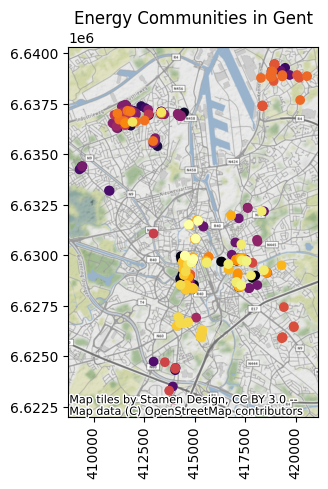

In [ ]:
# Create a plot
ax = (
    gpd.GeoDataFrame(environment.community_df)
    .set_geometry("coordinates")
    .plot(column="cluster", legend=False, cmap="inferno")
)

# Add a street map as the background
ctx.add_basemap(ax)
plt.title("Energy Communities in Gent")
plt.xticks(rotation=90)

plt.show()

##### **Reinforcement Learning Pipeline**

The basis of the agent, policy and buffer was taken from Tensorflows [guide](https://www.tensorflow.org/agents/tutorials/1_dqn_tutorial#plots)

In [ ]:
import base64
import IPython
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import PIL.Image
import reverb

import time
from tqdm import tqdm

import tensorflow_probability as tfp

from tf_agents.specs import array_spec
from tf_agents.specs import tensor_spec
from tf_agents.networks import network

from tf_agents.policies import py_policy
from tf_agents.policies import random_py_policy
from tf_agents.policies import scripted_py_policy

from tf_agents.policies import tf_policy
from tf_agents.policies import random_tf_policy
from tf_agents.policies import actor_policy
from tf_agents.policies import q_policy
from tf_agents.policies import greedy_policy

from tf_agents.trajectories import time_step as ts


from tf_agents.agents.dqn import dqn_agent
from tf_agents.drivers import py_driver
from tf_agents.environments import suite_gym
from tf_agents.environments import tf_py_environment
from tf_agents.eval import metric_utils
from tf_agents.metrics import tf_metrics
from tf_agents.networks import sequential
from tf_agents.policies import py_tf_eager_policy
from tf_agents.policies import random_tf_policy
from tf_agents.replay_buffers import py_uniform_replay_buffer
from tf_agents.replay_buffers import tf_uniform_replay_buffer
from tf_agents.trajectories import trajectory
from tf_agents.specs import tensor_spec
from tf_agents.utils import common


from tf_agents import specs
from tf_agents.agents.dqn import dqn_agent
from tf_agents.drivers import dynamic_step_driver
from tf_agents.environments import tf_py_environment
from tf_agents.networks import q_network
from tf_agents.specs import tensor_spec
from tf_agents.trajectories import time_step

###### **Hyperparameters**

Define the parameters for the agent, policy, buffer and training regime.

In [ ]:
num_iterations = 50000  # @param {type:"integer"}

initial_collect_steps = 10  # @param {type:"integer"}
collect_steps_per_iteration = 1  # @param {type:"integer"}
replay_buffer_max_length = 100  # @param {type:"integer"}

batch_size = 12  # @param {type:"integer"}
learning_rate = 1e-3  # @param {type:"number"}
log_interval = 200  # @param {type:"integer"}

num_eval_episodes = 10  # @param {type:"integer"}
eval_interval = 5000  # @param {type:"integer"}

In [ ]:
train_py_env = CommunityEnv(df_train)
train_env = tf_py_environment.TFPyEnvironment(train_py_env)

###### **Agent**

Define the Neural Network used to evaluate the best possible action (Deep Q Network)

In [ ]:
fc_layer_params = (100, 50)
action_tensor_spec = tensor_spec.from_spec(train_env.action_spec())
num_actions = action_tensor_spec.maximum - action_tensor_spec.minimum + 1


# Define a helper function to create Dense layers configured with the right
# activation and kernel initializer.
def dense_layer(num_units):
    return tf.keras.layers.Dense(
        num_units,
        activation=tf.keras.activations.relu,
        kernel_initializer=tf.keras.initializers.VarianceScaling(
            scale=2.0, mode="fan_in", distribution="truncated_normal"
        ),
    )


# QNetwork consists of a sequence of Dense layers followed by a dense layer
# with `num_actions` units to generate one q_value per available action as
# its output.
dense_layers = [dense_layer(num_units) for num_units in fc_layer_params]
q_values_layer = tf.keras.layers.Dense(
    num_actions,
    activation=None,
    kernel_initializer=tf.keras.initializers.RandomUniform(minval=-0.03, maxval=0.03),
    bias_initializer=tf.keras.initializers.Constant(-0.2),
)
q_net = sequential.Sequential(dense_layers + [q_values_layer])

In [ ]:
optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)

train_step_counter = tf.Variable(0)

agent = dqn_agent.DqnAgent(
    train_env.time_step_spec(),
    train_env.action_spec(),
    q_network=q_net,
    optimizer=optimizer,
    td_errors_loss_fn=common.element_wise_squared_loss,
    train_step_counter=train_step_counter,
)

agent.initialize()

###### **Policies**

Sets rules for the agent to take.

We will use an EpsilonGreedyPolicy to introduce some noise and encourage exploration of the problem.

In [ ]:
eval_policy = agent.policy
collect_policy = agent.collect_policy

In [ ]:
# create a random policy for testing and benchmarking
random_policy = random_tf_policy.RandomTFPolicy(
    train_env.time_step_spec(), train_env.action_spec()
)

In [ ]:
# wrapp the dqn policy to add some noise and aid exploration
ep_policy = EpsilonGreedyPolicy(agent.policy, epsilon=0.3)

###### **Metrics**

Function for computing the average return per episode

In [ ]:
def compute_avg_return(environment, policy, num_episodes=10):
    total_return = 0.0
    for _ in range(num_episodes):
        time_step = environment.reset()
        episode_return = 0.0

        while not time_step.is_last():
            action_step = policy.action(time_step)
            time_step = environment.step(action_step.action)
            episode_return += time_step.reward
        total_return += episode_return

    avg_return = total_return / num_episodes
    return avg_return.numpy()[0]


# See also the metrics module for standard implementations of different metrics.
# https://github.com/tensorflow/agents/tree/master/tf_agents/metrics

In [ ]:
### Running this computation on the random_policy shows a baseline performance in the environment.
compute_avg_return(train_env, random_policy, num_eval_episodes)

988.787

In [ ]:
compute_avg_return(train_env, ep_policy, num_eval_episodes)

1344.1375

###### **Replay Buffer**

Stores previous states of the rearning process

In [ ]:
# create replay buffer from data spec
batch_size = 32
max_length = 1000
data_spec = tensor_spec.from_spec(agent.collect_data_spec)
replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer(
    data_spec=tensor_spec.from_spec(agent.collect_data_spec),
    batch_size=batch_size,
    max_length=max_length,
)

In [ ]:
replay_buffer_capacity = 1000

replay_buffer = tf_uniform_replay_buffer.TFUniformReplayBuffer(
    agent.collect_data_spec,
    batch_size=train_env.batch_size,
    max_length=replay_buffer_capacity,
)

# Add an observer that adds to the replay buffer:
replay_observer = [replay_buffer.add_batch]

collect_steps_per_iteration = 10
collect_op = dynamic_step_driver.DynamicStepDriver(
    train_env,
    agent.collect_policy,
    observers=replay_observer,
    num_steps=collect_steps_per_iteration,
).run()

In [ ]:
# Read the replay buffer as a Dataset,
# read batches of 4 elements, each with 2 timesteps:
dataset = replay_buffer.as_dataset(sample_batch_size=4, num_steps=2)

Instructions for updating:
Use `tf.data.Dataset.counter(...)` instead.
Instructions for updating:
Use `as_dataset(..., single_deterministic_pass=False) instead.


###### **Train**

Run the agent on the data, evaluation every 5000 steps

In [ ]:
try:
    %%time
except:
    pass

# (Optional) Optimize by wrapping some of the code in a graph using TF function.
agent.train = common.function(agent.train)

iterator = iter(dataset)

# Evaluate the agent's policy once before training.
avg_return = compute_avg_return(train_env, ep_policy, num_eval_episodes)
returns = [avg_return]
print(returns)

for _ in tqdm(range(num_iterations)):
    step = agent.train_step_counter.numpy()

    trajectories, _ = next(iterator)
    loss = agent.train(experience=trajectories)

    if step % log_interval == 0:
        print("step = {0}: loss = {1}".format(step, loss))

    if (step % eval_interval == 0) and (step != 0):
        print("Evaluating:")
        avg_return = compute_avg_return(train_env, ep_policy, num_eval_episodes)
        print("step = {0}: Average Return = {1}".format(step, avg_return))
        returns.append(avg_return)

###### **Evaluate Reward**

Plot the reward over iteration.

Text(0, 0.5, 'Reward')

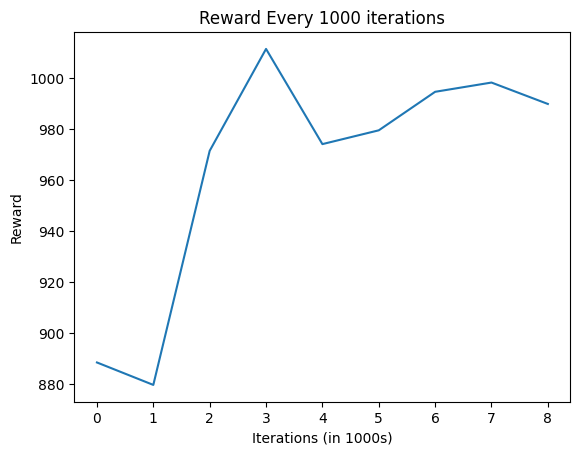

In [ ]:
import matplotlib.pyplot as plt

#
plt.plot(returns[1:])
plt.title("Reward Every 1000 iterations")
plt.xlabel("Iterations (in 1000s)")
plt.ylabel("Reward")

We were limitted by the evaluation step greatly increasing the runtime, hence we only evaluated 10 times (every 5000 iterations).

However, this plot shows the desired shape of the reward function intially increasing converging around a value.

Of course, other metrics related to energy communities need to be evaluated, but this demonstrated the created environment and agent is capable of learning from the data and reward (even if it needs to be tweaked)

###### **Create The Communities From The Trained Agent**

Use the learned 'cluster creation' steps to define the communities

In [ ]:
# unpack actions
total_return = 0.0
environment = train_env
time_step = environment.reset()
episode_return = 0.0
action_steps = []

while not time_step.is_last():
    action_step = ep_policy.action(time_step)
    time_step = environment.step(action_step.action)
    episode_return += time_step.reward
    action_steps.append(action_step.action)
total_return += episode_return

In [ ]:
# add int to a list
action_ints = []
for i in range(len(action_steps)):
    action_ints.append(tf.get_static_value(action_steps[i])[0])

In [ ]:
# run through python environment with trained actions
time_step = train_py_env.reset()

for i in action_ints:
    action = np.array(i, dtype=np.int32)

    next_time_step = train_py_env.step(action)

In [ ]:
# display the dataset of clusters
df_rl_clusters = train_py_env.community_df
df_rl_clusters

,coordinates,avg_net_tax_income,energy_cost_residential_percent_income,BIMD2011_score,top_10_per_energy_prod_in_500m,cluster,original_index
0,POINT (409406.8655973049 6634389.81177494),0.370986,1.0,0.454599,0.084618,3320,129445
1,POINT (409395.01263560157 6634381.674156655),0.370986,1.0,0.454599,0.084618,3320,119484
2,POINT (409437.6524566218 6634409.942631675),0.370986,1.0,0.454599,0.076704,3320,152876
3,POINT (409295.15558490384 6634250.9595826715),0.370986,1.0,0.454599,0.060133,3320,110854
4,POINT (409412.20383915363 6634393.1576795345),0.370986,1.0,0.454599,0.081657,3320,127253
...,...,...,...,...,...,...,...
373,POINT (420032.905083714 6634622.996571396),0.113784,0.312584,0.8037,0.115789,3341,134101
374,POINT (421376.373190077 6635459.197198844),0.078678,0.081224,0.89746,0.486305,3341,159988
375,POINT (419581.32890861883 6633558.726296149),0.244605,0.01515,0.641842,0.003844,3341,51659
376,POINT (421217.4233284328 6635671.14650835),0.078678,0.095442,0.89746,0.088898,3341,135676


In [ ]:
# how many clusters
df_rl_clusters.cluster.nunique()

23

/usr/local/lib/python3.10/dist-packages/geopandas/plotting.py:809: FutureWarning: In a future version, the Index constructor will not infer numeric dtypes when passed object-dtype sequences (matching Series behavior)
  cat = pd.Categorical(values, categories=categories)


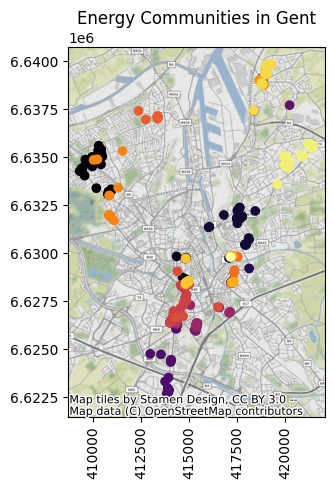

In [ ]:
# Create a plot
ax = (
    gpd.GeoDataFrame(df_rl_clusters)
    .set_geometry("coordinates")
    .plot(column="cluster", legend=False, cmap="inferno")
)

# Add a street map as the background
ctx.add_basemap(ax)
plt.title("Energy Communities in Gent")
plt.xticks(rotation=90)

plt.show()

Clusters are reasonably well distributed accross the city. They are noticably more spread out then then rules-spatial clustering algorithm.

An improvement would be to apply a tighter contraint on the max distance to the centroid (currently set at 2km). This was done as we wanted to see if the algorithm will prioritize closer distance (based on the reward), but this may need to be tightened in the future (or increase the reward for close clusters).

###### **Compare to MVP (rules + spatial)**

While the created communities vary greatly in size (the RL technque selects approx 400), we can see if the intital version of the complex RL solution compares to the baselines.

The metric of comparrison will be **ranked_mean**:
- The average of the mean rank of selected features in each cluster
- Order of ranking is selected based on the feature and challenge requirements (for example, lower BIMD scores are ranked higher as we want to prioritize less afulent areas)

It should be noted that the RL technique required sampling the training data at 60% (due to computational constraints) so the training sets aren't being compared for like.

In [ ]:
# set up tool for evaluation
community = CommunitySelect(df)

# Get results from MVP (default algorithm)
df_spatial_cluster = community.create(criteria=criteria, num_clusters=23)
summary_table_spatial = community.get_cluster_summary()

# Get selected communities (with rank)
df_select_rl = community.create(algorithm=None, criteria=criteria)

# mannually set community.X_selected to be the clusters from RL (as RL is not yet implemented as an algorthim due to it's long run time)
community.X_selected = df_select_rl.reset_index().merge(
    df_rl_clusters[["cluster", "original_index"]],
    how="inner",
    left_on="index",
    right_on="original_index",
)

summary_table_rl = community.get_cluster_summary()

summary_table_rl

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


,exp_score_income_domain,rank_income_domain,deciles_income_domain,exp_score_employment_domain,rank_employment_domain,deciles_employment_domain,exp_score_edu_domain,rank_edu_domain,deciles_edu_domain,exp_score_hous_domain,...,solar_cost,top_10_per_energy_prod_in_500m,all_energy,green_energy,fossil_energy,avg_net_tax_income_rank_value,energy_cost_residential_percent_income_rank_value,BIMD2011_score_rank_value,top_10_per_energy_prod_in_500m_rank_value,ranked_mean
cluster,,,,,,,,,,,,,,,,,,,,,
3320,28.521230,6272.500000,3.736842,17.386202,10280.526316,5.736842,30.809851,6525.631579,3.789474,31.892286,...,12563.894737,1.165079e+06,33980.034508,7295.513409,26684.521099,0.474090,0.104873,0.398185,0.623741,0.400222
3321,77.066858,442.875000,1.000000,9.029123,12708.500000,7.625000,24.074896,6437.125000,3.875000,12.302804,...,3269.312500,2.966035e+06,29215.157542,6272.494324,22942.663218,0.229473,0.089295,0.514168,0.131484,0.241105
3322,36.309200,4189.705882,2.588235,17.577895,8942.941176,5.264706,39.419615,3884.588235,2.352941,37.577411,...,7497.000000,1.332842e+06,33960.234268,7291.262297,26668.971970,0.420808,0.120621,0.492118,0.561913,0.398865
3323,40.246847,3283.666667,1.916667,23.305472,8109.166667,4.500000,49.181200,2122.583333,1.916667,35.430681,...,6189.416667,2.497150e+06,50910.840859,10930.557532,39980.283327,0.357160,0.125839,0.564949,0.226847,0.318699
3324,5.379005,14859.000000,8.333333,7.888732,13508.833333,7.500000,32.546776,4431.500000,3.166667,39.947993,...,8766.333333,1.187110e+06,135327.425392,29054.798232,106272.627161,0.340637,0.036467,0.330269,0.613336,0.330177
3325,28.396011,7033.687500,4.312500,10.236088,12840.000000,7.625000,18.640249,9818.937500,5.812500,31.654154,...,9925.343750,1.609911e+06,20320.346622,4362.778420,15957.568203,0.492438,0.111787,0.316505,0.503951,0.356170
3326,6.182997,14284.000000,8.000000,4.726566,15248.500000,8.500000,24.406558,6928.000000,4.500000,22.118690,...,21964.000000,1.318876e+06,169857.686750,36468.445345,133389.241405,0.535165,0.001234,0.205377,0.552454,0.323558
3327,52.888160,1662.000000,1.000000,16.853220,8891.000000,5.000000,50.183025,1900.000000,2.000000,43.318077,...,16646.400000,1.399753e+06,56955.914426,12228.434827,44727.479599,0.627381,0.002315,0.661983,0.517576,0.452314
3328,58.124390,1402.800000,1.000000,15.042765,9772.200000,5.600000,44.874787,2831.200000,2.400000,37.085653,...,4103.800000,1.888377e+06,47772.380377,10256.730067,37515.650310,0.538471,0.088055,0.632751,0.381659,0.410234


<Axes: ylabel='mean rank'>

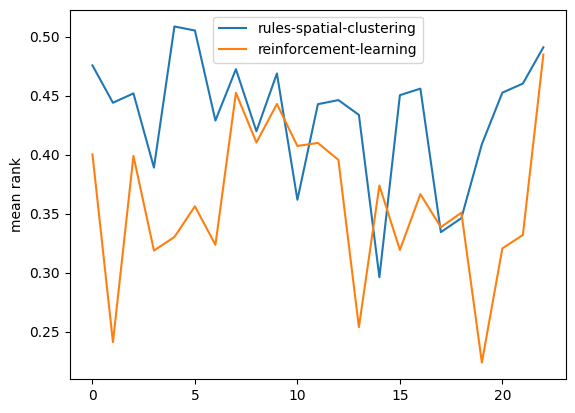

In [ ]:
summary_table_spatial.reset_index(allow_duplicates=True).ranked_mean.plot(
    ylabel="mean rank", label="rules-spatial-clustering", legend=True
)
summary_table_rl.reset_index(allow_duplicates=True).ranked_mean.plot(
    label="reinforcement-learning", legend=True
)

The MVP solution outperforms the RL algorithm for most of the clusters (the order is arbitary).

While this points towards using the rules-spatial algorithm in the intial product, it shows the RL technique is at least comparable. It also must be considered that the RL technique clusters are formed from a select 400 addresses while the MVP solution consists of 30,000 which would not be useful for defining the exact communities (although still helpful in decision making).

This, together with the fact that the RL model is in the very early stages of development, means there is a lot more potential for future iterations. Moreover, rewards return showed that the environment is capable of learning from the data, and with more tuning could perform even better.

Finally, the RL model could also benefit from subject matter experts assisting in the creation of the reward function (without having to egineer additional features), so that the clusters are being optimized for the desired outcomes. This flexibillity is another advantage the RL approach has over straight clustering approaches.

Therefore, this approach (and base environment) would form a key part of the tool going forward.

#### **Interpretability** <a name ='interpretability'></a>

The rules then spatial clustering algorithm is very interpratable. This is beacuse the only clustering is performed on the spatial coordinates which can be easily inspected on a city plot.

The Reinforcement Learning solution is not fully interprable, due to the Deep-Q-Network used as the agent. However, as each action is associated with a single feature, the decisions made by the agent can be directly linked to an attribute of the data. For example, in the solution above, the distribution of actions was


<Axes: >

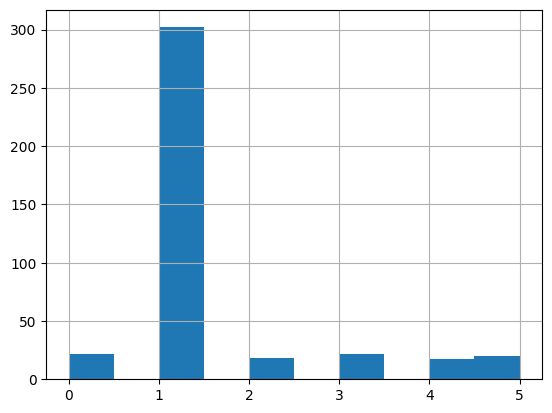

In [ ]:
#display distribution of actions
pd.Series(action_ints).hist()

Action 1 which is choosing areas with lower average net tax income. This means that the algorithm skewed heavily towards prioritizing low values of this feature. This approach of inspecting the actions could be used to debug the model and decide if any changes need made to the rewards and policy in order to lessen the importance of certain featurs. This could help shape the model by tuning the rewards to give more importance to certain features (depending on local goverment policy)

In this case, we would decrease the reward associated with choosing this feature and possibly prioritize the energy poverty indicator more.

#### **Fairness** <a name ='fairness'></a>

Fairness is a consideration, given that we dont want the model to assign bias against demographics (in terms of not reccomending they be part of energy communities). This is handled by:

 - Only considering street/level data for social/economic indicators
 - Prioritizing areas more likely to be facing fuel poverty
 - Allowing the features and constraints to be changed by the model users. This ensure people with more subject matter knowledge on equallity and diversity in the chosen city can set appropriate parameters for the solution.

## 🖼️ Visualisations <a name ='visualisations'></a>
Copy here the most important visualizations (graphs, charts, maps, images, etc). You can refer to them in the Executive Summary.

Technical note: If not all the visualisations are visible, you can still include them as an image or link - in this case please upload them to your own repository.

#### Plot of BIMD in Gent

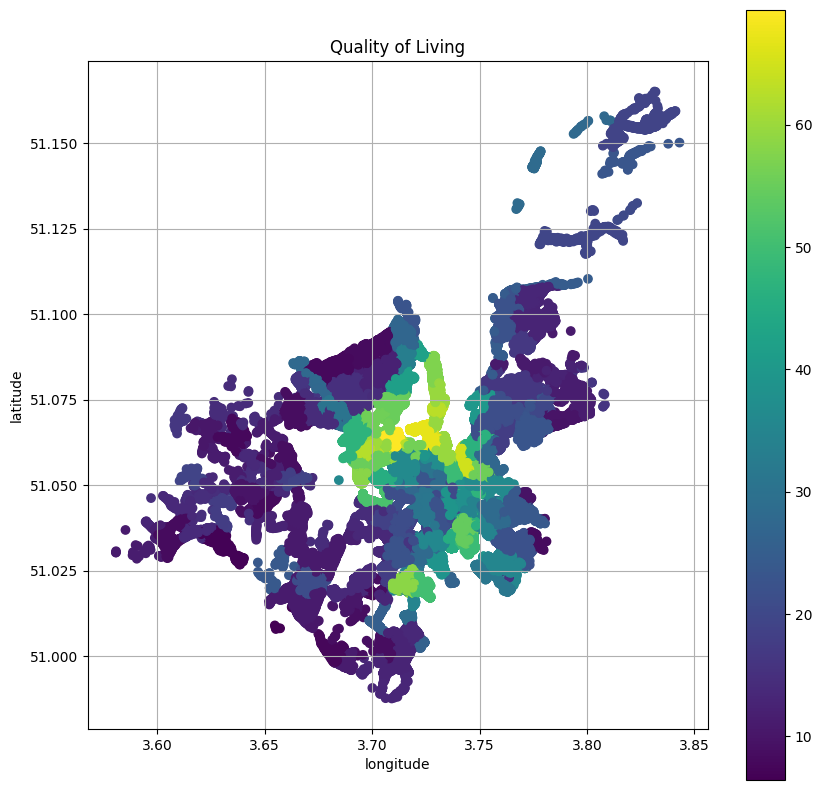

In [ ]:
# Plot the distribution of quality of living in Ghent
df_residential.to_crs(epsg=4326).plot(
    column="BIMD2011_score", legend=True, figsize=(10, 10)
)

# Add labels and title
plt.title("Quality of Living")
plt.xlabel("longitude")
plt.ylabel("latitude")

# Add grid lines
plt.grid();

#### Mapping of Defined Communities to Solar Panel Sites

As this function is using plotly, an emded image of the output is shown below. Based on overlap of top solar sites and communities there are some good options:

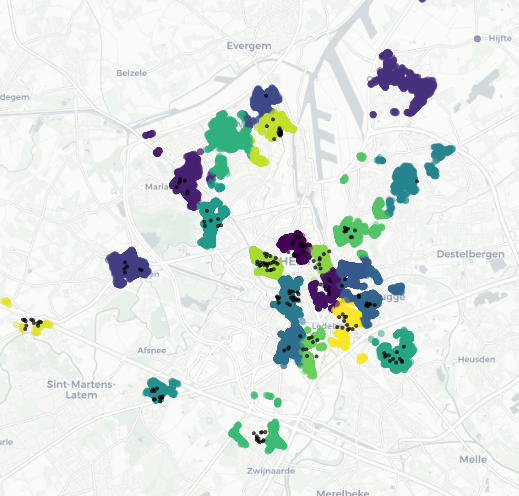

#### Evaluate Reward Function of Reward Function

Text(0, 0.5, 'Reward')

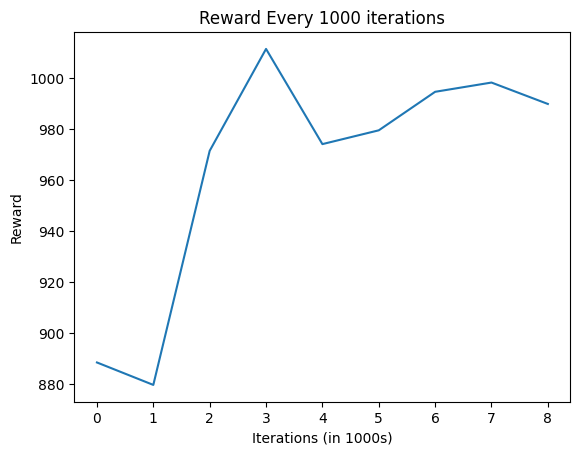

In [ ]:
import matplotlib.pyplot as plt

#
plt.plot(returns[1:])
plt.title("Reward Every 1000 iterations")
plt.xlabel("Iterations (in 1000s)")
plt.ylabel("Reward")

#### Compare MVP with Reinforcement Learning Model

<Axes: ylabel='mean rank'>

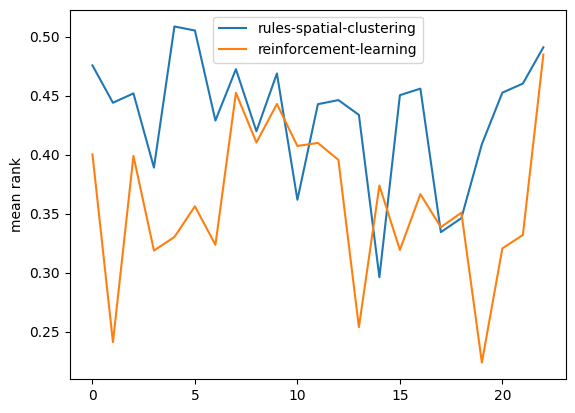

In [ ]:
summary_table_spatial.reset_index(allow_duplicates=True).ranked_mean.plot(
    ylabel="mean rank", label="rules-spatial-clustering", legend=True
)
summary_table_rl.reset_index(allow_duplicates=True).ranked_mean.plot(
    label="reinforcement-learning", legend=True
)

#### Screen Shot of Product Dashboard

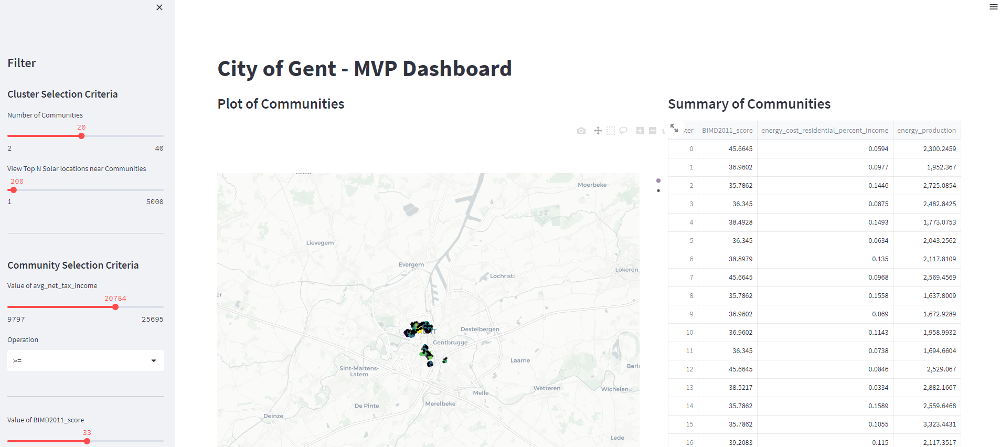

## 👓 References <a name ='references'></a>
-	https://opendata.fluvius.be/explore/dataset/1_06a-verbruiksgegevens-per-statistische-sector-met-nace-sector-en-nace-subsecto/information/
-	https://opendata.fluvius.be/explore/dataset/1_21-aangemelde-oplaadpunten-voor-ev/information/
-	https://opendata.fluvius.be/explore/dataset/1_20-lijst-van-decentrale-productie-installaties-gekoppeld-aan-het-distributiene/information/
-	https://gent.buurtmonitor.be/
-	https://www.immoweb.be/en
-	https://github.com/mathiasleroy/Belgium-Geographic-Data/tree/master
-	https://www.geo.be/catalog/details/d5f503fe-c228-48a6-9f00-927c95bbd450?l=en
-	https://www.geo.be/catalog/details/ca0fd5c0-8146-11e9-9012-482ae30f98d9?l=en
-	https://github.com/oSoc19/best/tree/master
-	https://www.brain-ellis.be/blog/10-towards-the-development-of-a-belgian-index-of-multiple-deprivation
-	https://land.copernicus.eu/user-corner/technical-library/urban_atlas_2012_2018_mapping_guide_v6.3
-	https://www.europarl.europa.eu/RegData/etudes/BRIE/2022/733583/EPRS_BRI(2022)733583_EN.pdf
-	https://www.energyprice.be/blog/energy-poverty-in-belgium/#:~:text=Measured%20energy%20poverty%20%E2%80%93%20this%20affects,that%20it%20becomes%20abnormally%20low
-	https://ec.europa.eu/eurostat/statistics-explained/index.php?title=Natural_gas_price_statistics
-	https://www.odyssee-mure.eu/publications/efficiency-trends-policies-profiles/belgium-country-profile-english.pdf
-	https://www.energyprice.be/blog/energy-poverty-in-belgium/#:~:text=Measured%20energy%20poverty%20%E2%80%93%20this%20affects,that%20it%20becomes%20abnormally%20low
-	https://land.copernicus.eu/user-corner/technical-library/urban_atlas_2012_2018_mapping_guide_v6.3
-	https://www.greenmatch.co.uk/blog/2014/08/what-is-the-installation-cost-for-solar-panels
-	https://gent.buurtmonitor.be/
-	https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html
-	https://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html
-	https://hdbscan.readthedocs.io/en/latest/how_hdbscan_works.html
-	https://geodacenter.github.io/pygeoda/spatial_clustering.html
-	https://pysal.org/spopt/
-	https://geodacenter.github.io/data-and-lab/Guerry/
-	http://darribas.org/gds_scipy16/ipynb_md/03_spatial_weights.html
-	http://geodacenter.github.io/workbook/9c_spatial3/lab9c.html
-	https://arxiv.org/pdf/1910.05113.pdf
-	http://darribas.org/gds_scipy16/ipynb_md/07_spatial_clustering.html
-	https://esa.github.io/pygmo2/tutorials/coding_udp_simple.ht
-	https://www.tensorflow.org/agents/tutorials/0_intro_rl
-	https://pysal.org/spopt/
- https://www.tensorflow.org/agents/tutorials/1_dqn_tutorial#plots


## ⏭️ Appendix <a name ='appendix'></a>

#### EDA Plots

We carried out eda on all of the features, displayed below:

**************************************************
area Summary Statistics:
**************************************************



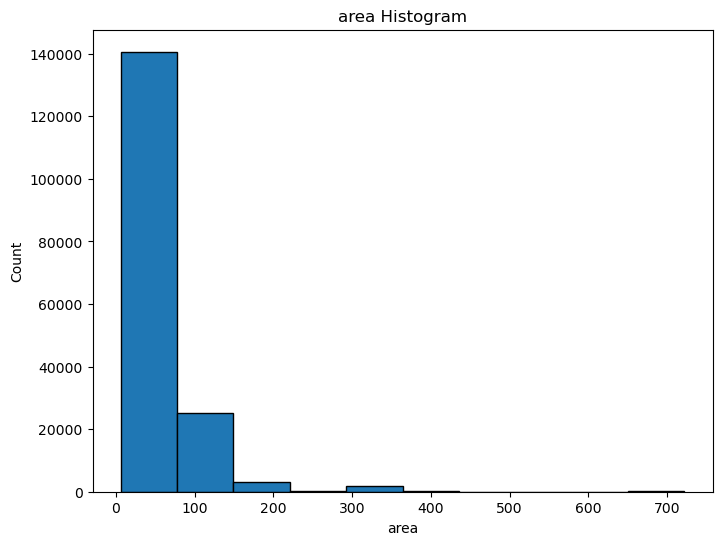

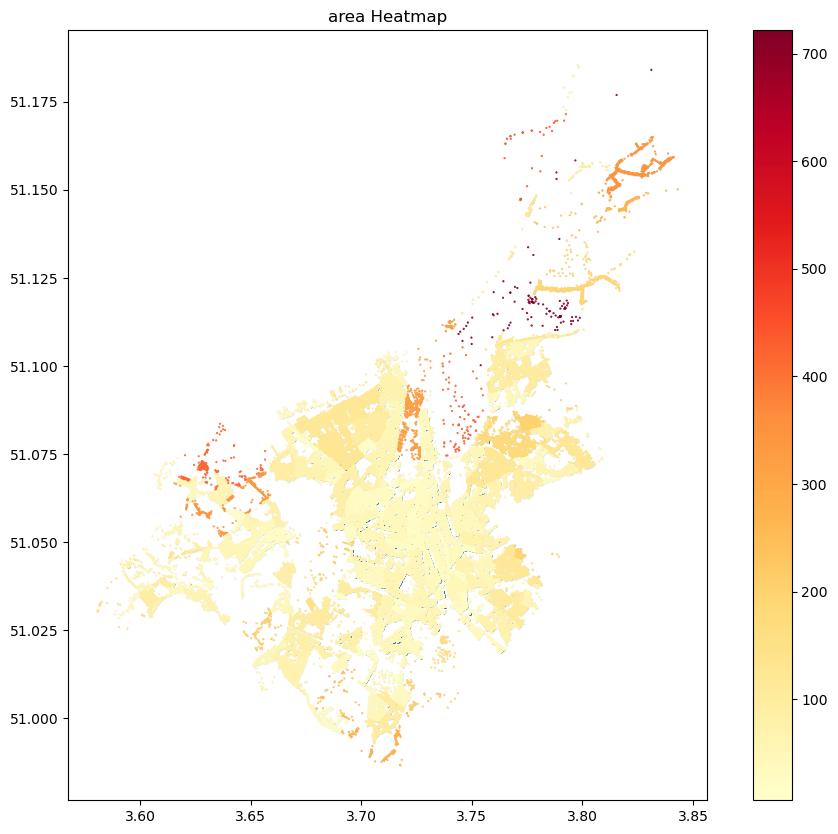

area Summary Statistics:
count    171703.000000
mean         56.510688
std          49.700098
min           6.196136
25%          31.099867
50%          43.615208
75%          65.105069
max         721.733794
Name: area, dtype: float64
Frac Null Values: 0.0
**************************************************
exp_score_income_domain Summary Statistics:
**************************************************



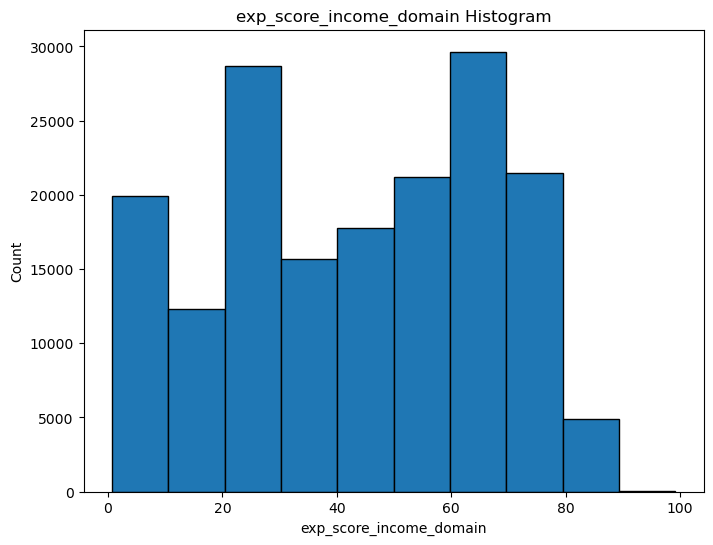

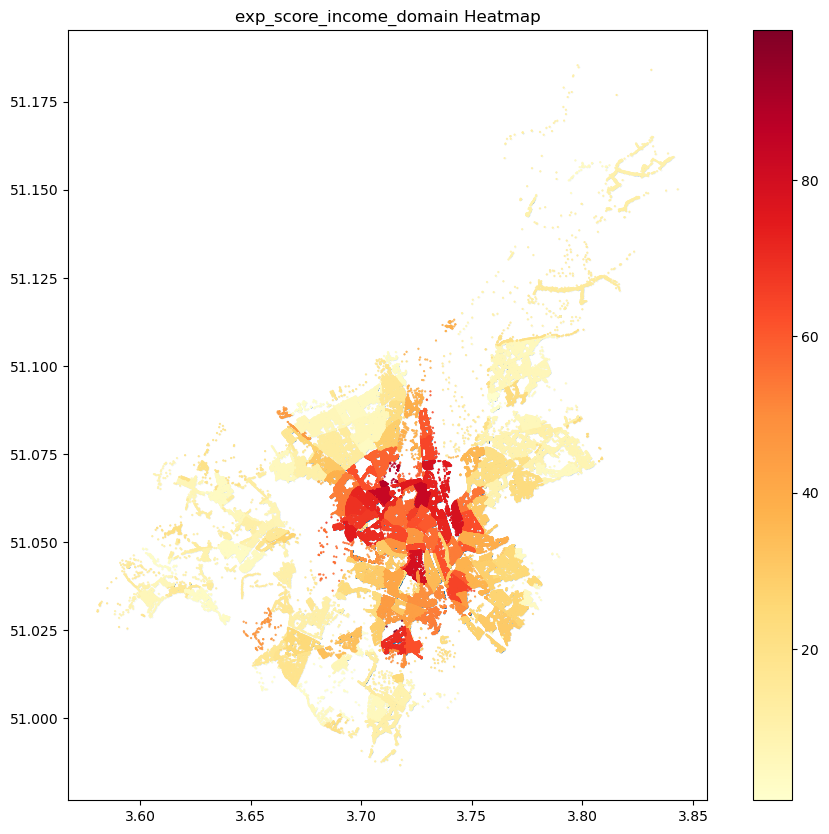

exp_score_income_domain Summary Statistics:
count    171703.000000
mean         43.389563
std          23.084692
min           0.666539
25%          24.675926
50%          45.811408
75%          62.293051
max          99.173204
Name: exp_score_income_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
rank_income_domain Summary Statistics:
**************************************************



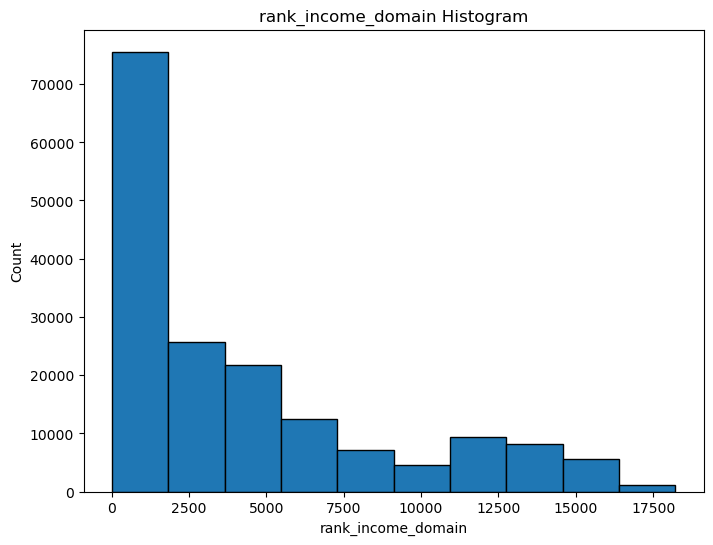

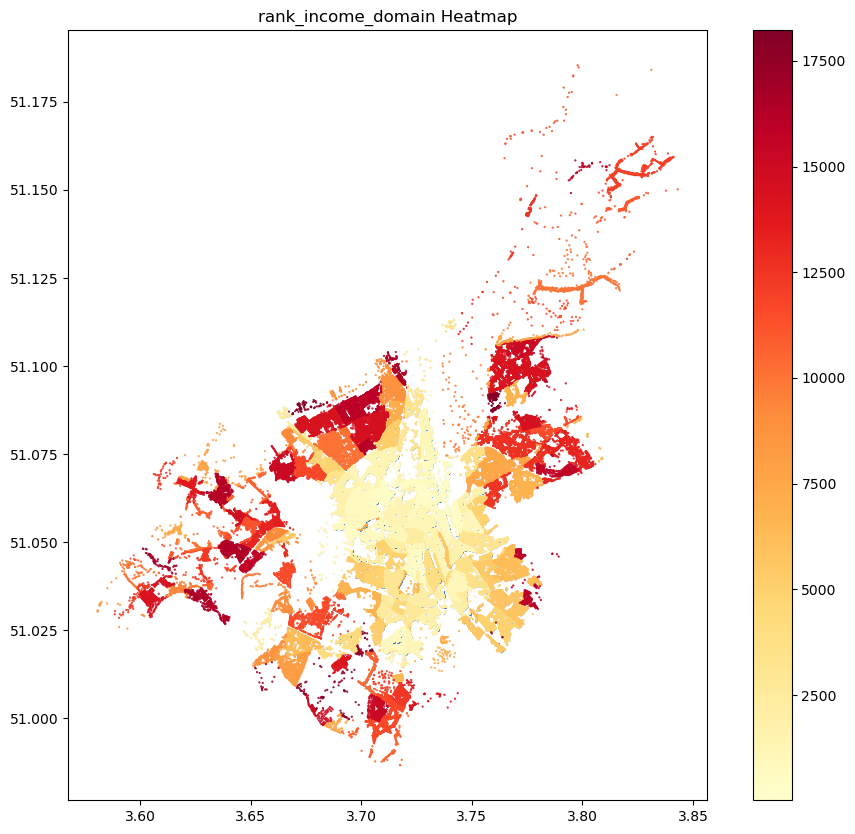

rank_income_domain Summary Statistics:
count    171703.000000
mean       4412.697422
std        4535.496954
min          10.000000
25%        1022.000000
50%        2349.000000
75%        6257.000000
max       18222.000000
Name: rank_income_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
deciles_income_domain Summary Statistics:
**************************************************



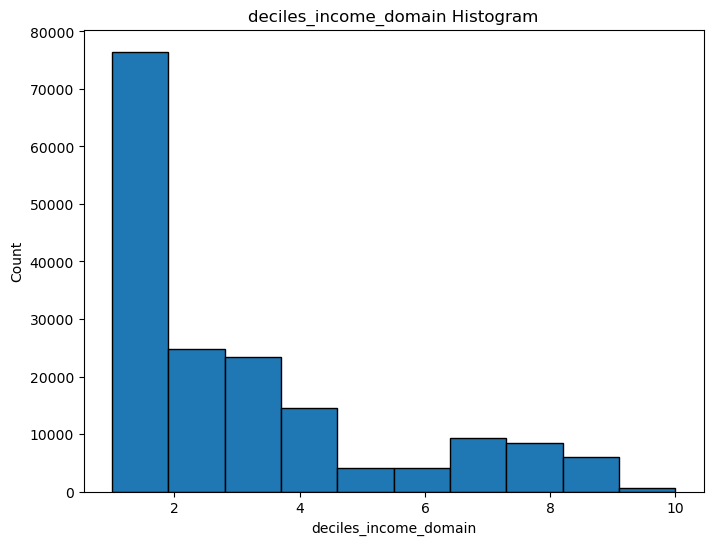

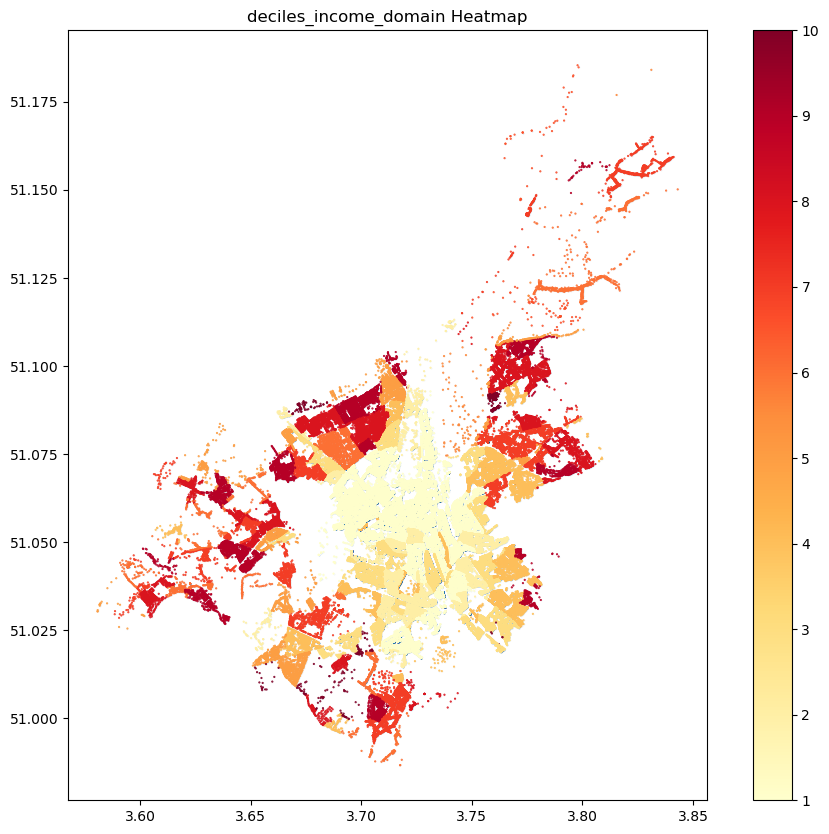

deciles_income_domain Summary Statistics:
count    171703.000000
mean          2.861938
std           2.408690
min           1.000000
25%           1.000000
50%           2.000000
75%           4.000000
max          10.000000
Name: deciles_income_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
exp_score_employment_domain Summary Statistics:
**************************************************



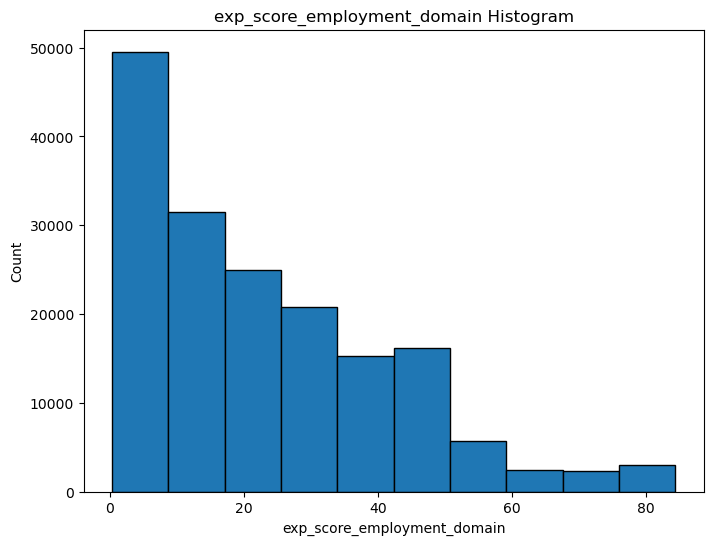

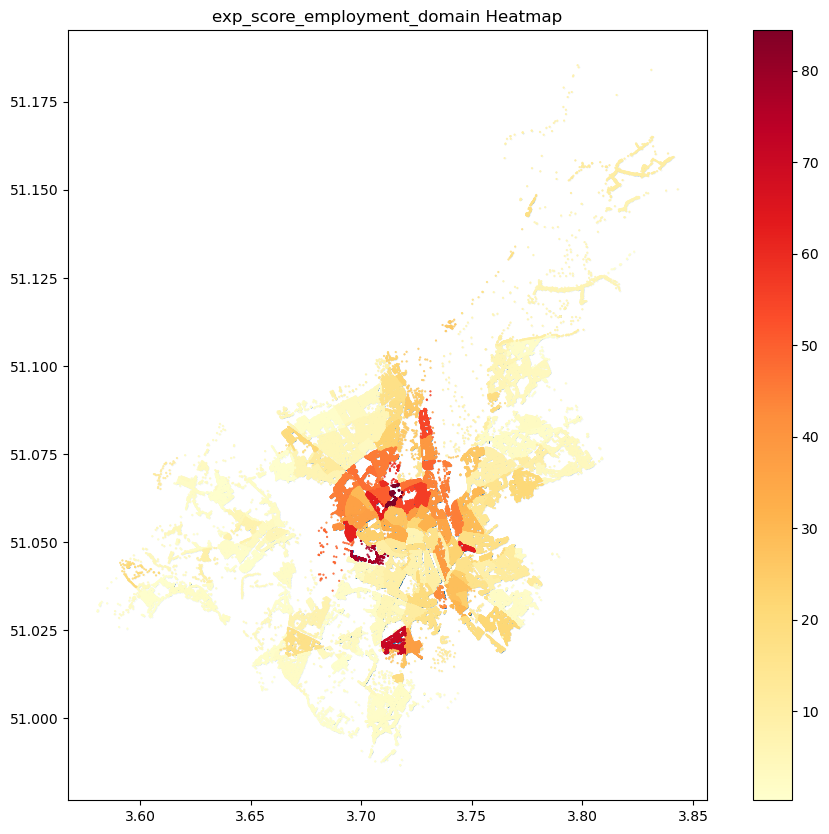

exp_score_employment_domain Summary Statistics:
count    171703.000000
mean         22.794464
std          18.630362
min           0.278749
25%           7.707720
50%          17.626368
75%          36.110146
max          84.429663
Name: exp_score_employment_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
rank_employment_domain Summary Statistics:
**************************************************



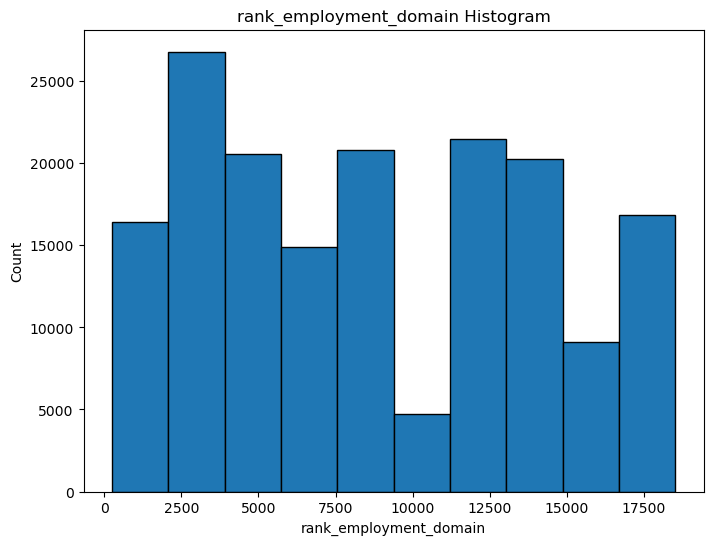

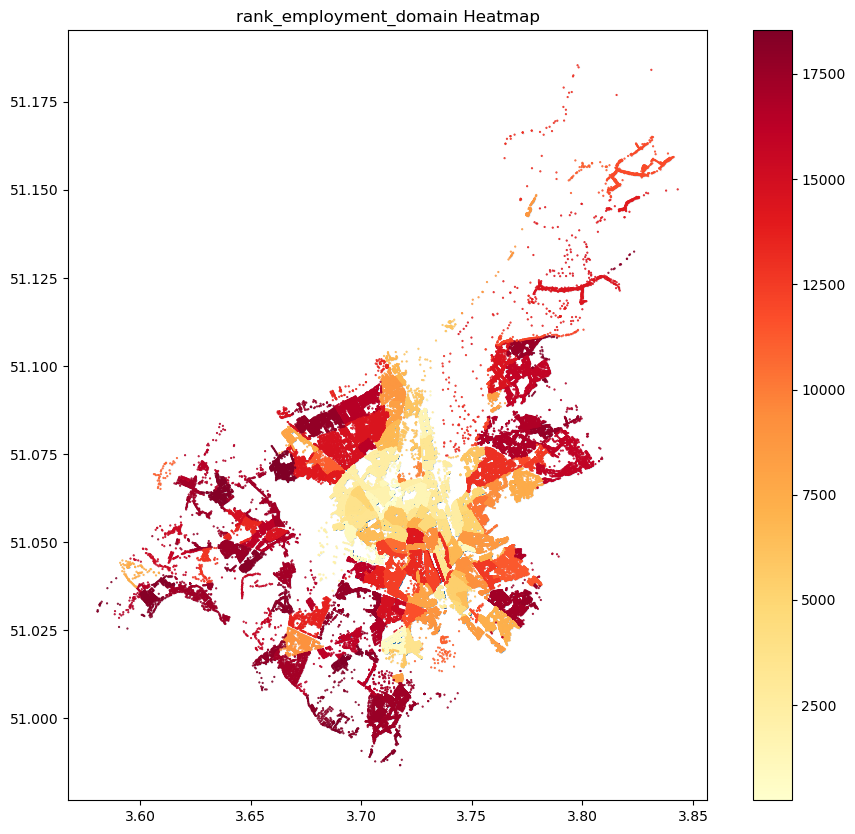

rank_employment_domain Summary Statistics:
count    171703.000000
mean       8846.136386
std        5349.437118
min         239.000000
25%        3710.000000
50%        8589.000000
75%       13352.000000
max       18536.000000
Name: rank_employment_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
deciles_employment_domain Summary Statistics:
**************************************************



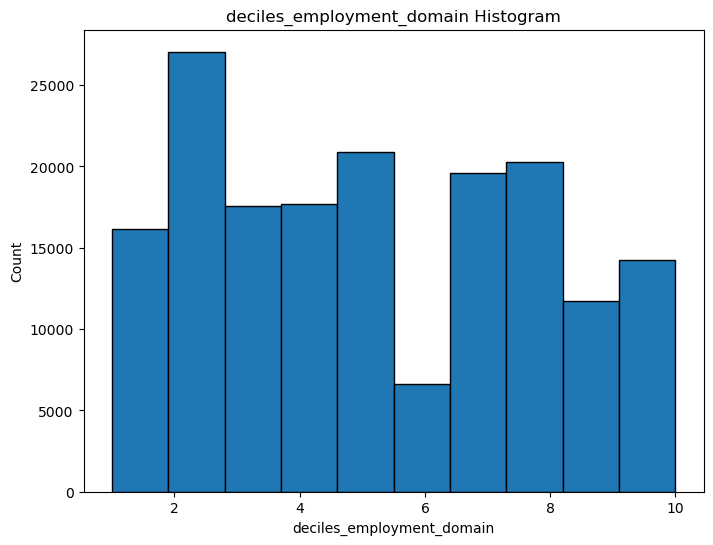

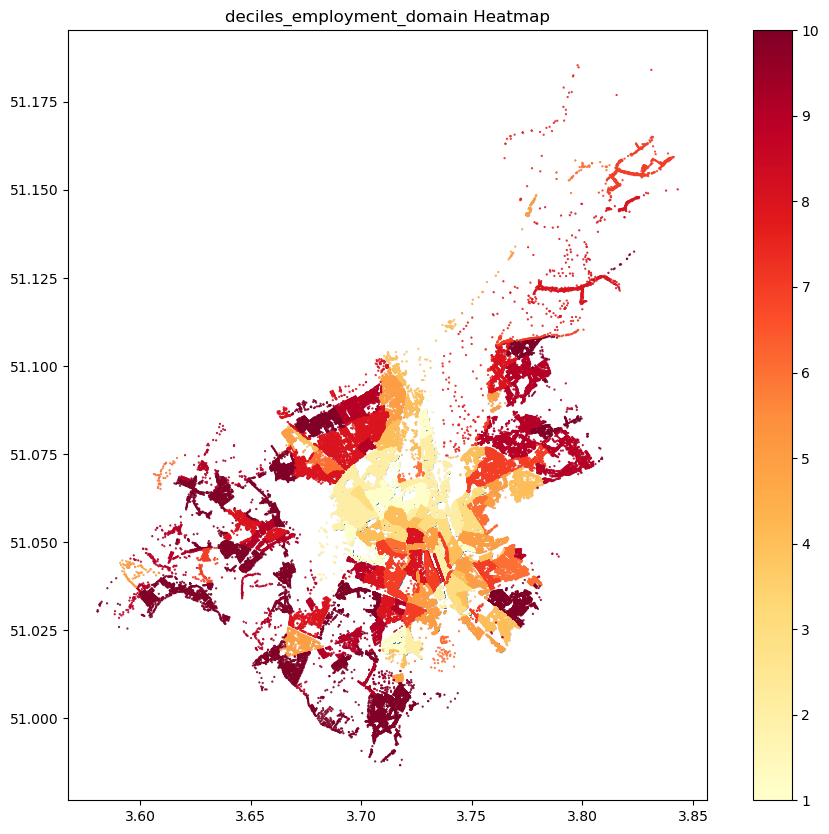

deciles_employment_domain Summary Statistics:
count    171703.000000
mean          5.152729
std           2.847204
min           1.000000
25%           2.000000
50%           5.000000
75%           8.000000
max          10.000000
Name: deciles_employment_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
exp_score_edu_domain Summary Statistics:
**************************************************



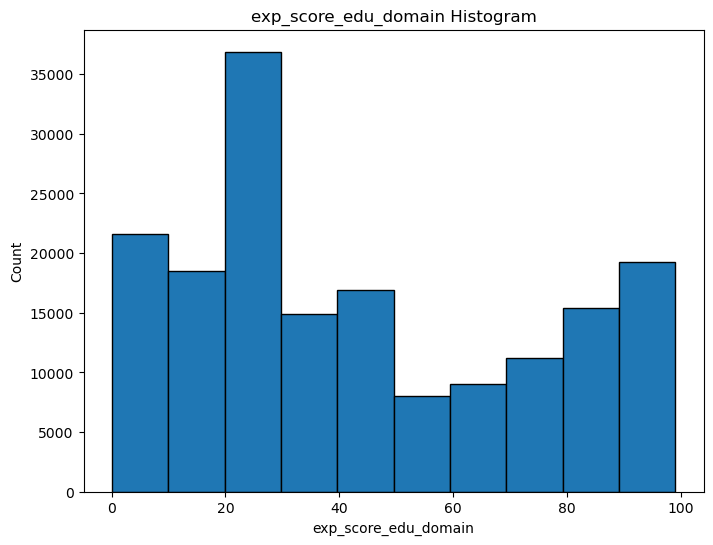

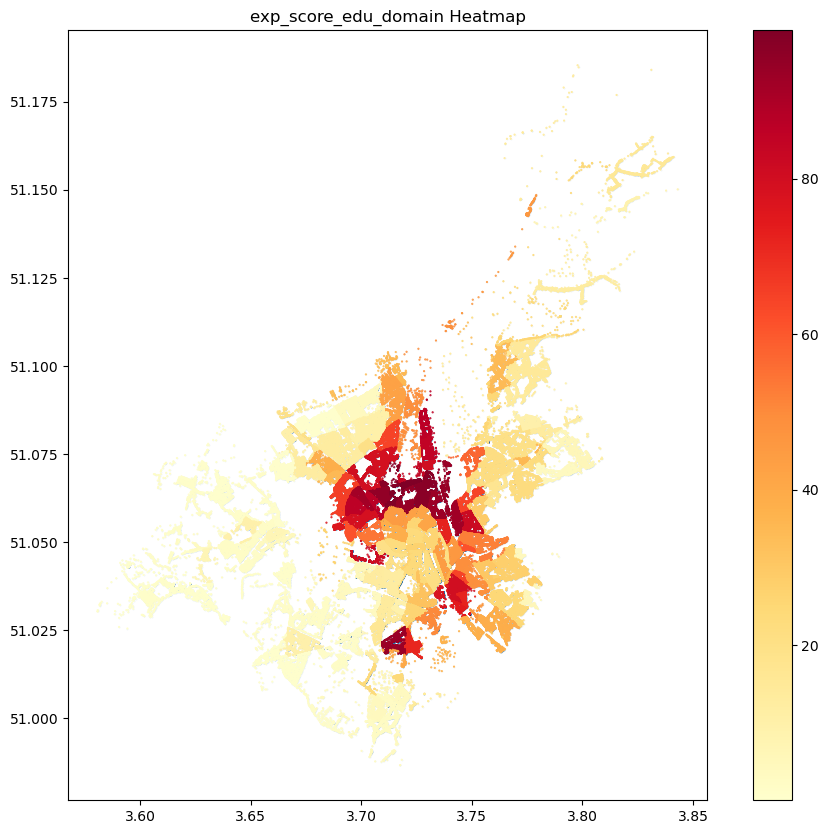

exp_score_edu_domain Summary Statistics:
count    171703.000000
mean         43.214863
std          30.423089
min           0.024211
25%          20.141290
50%          37.956028
75%          72.470428
max          99.083146
Name: exp_score_edu_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
rank_edu_domain Summary Statistics:
**************************************************



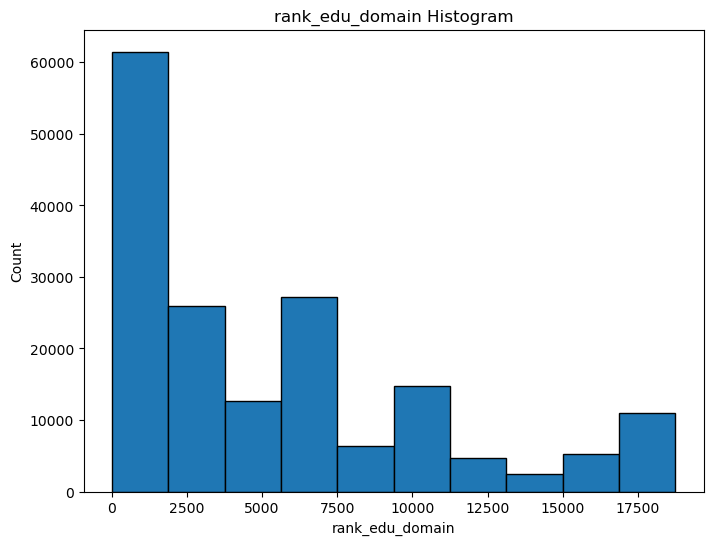

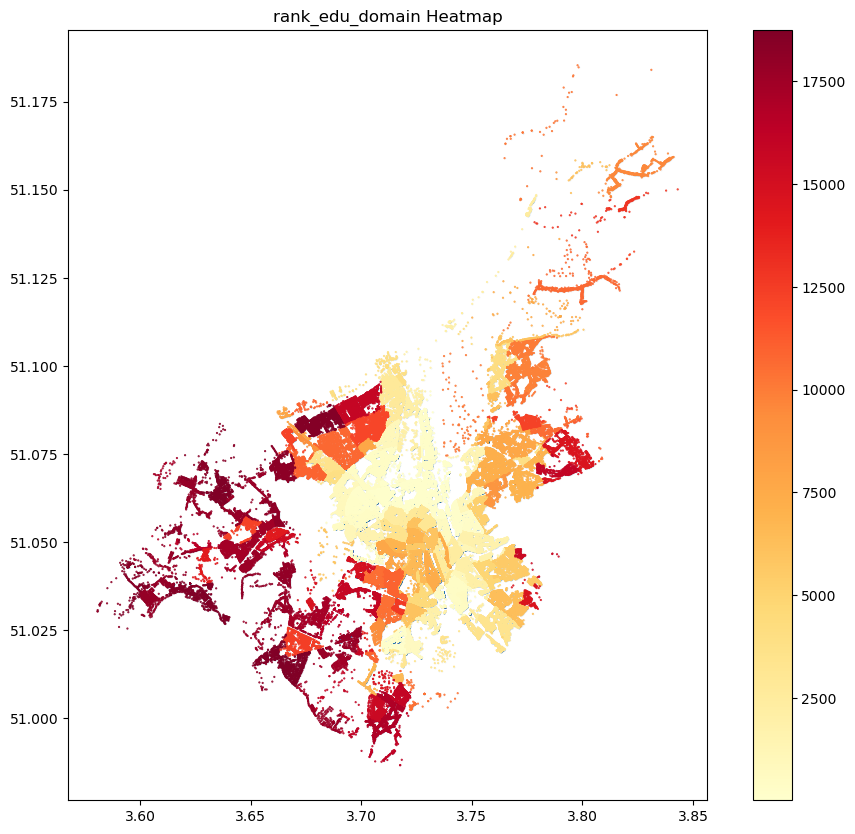

rank_edu_domain Summary Statistics:
count    171703.000000
mean       5375.053928
std        5351.909484
min          11.000000
25%         569.000000
50%        3405.000000
75%        7674.000000
max       18745.000000
Name: rank_edu_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
deciles_edu_domain Summary Statistics:
**************************************************



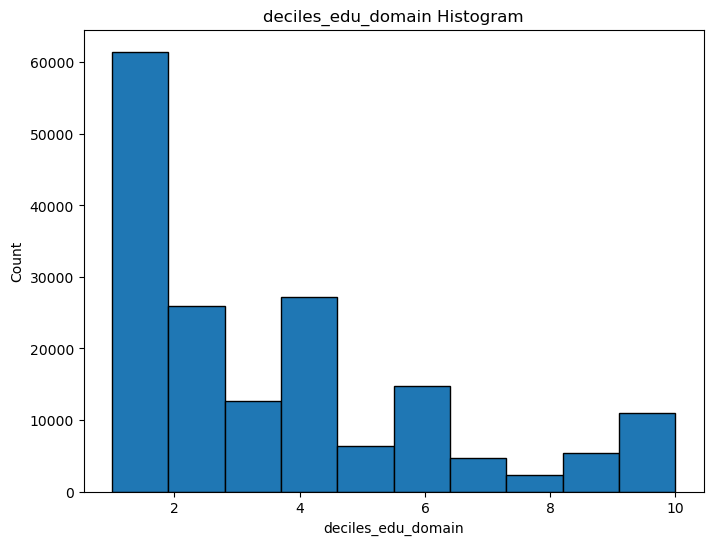

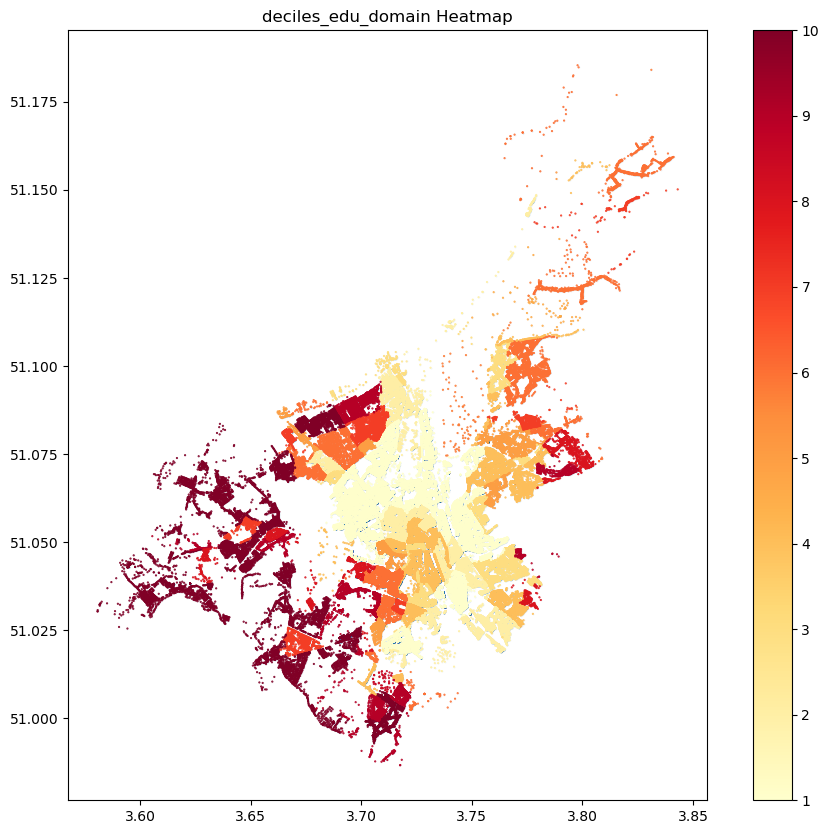

deciles_edu_domain Summary Statistics:
count    171703.000000
mean          3.436636
std           2.741546
min           1.000000
25%           1.000000
50%           2.000000
75%           5.000000
max          10.000000
Name: deciles_edu_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
exp_score_hous_domain Summary Statistics:
**************************************************



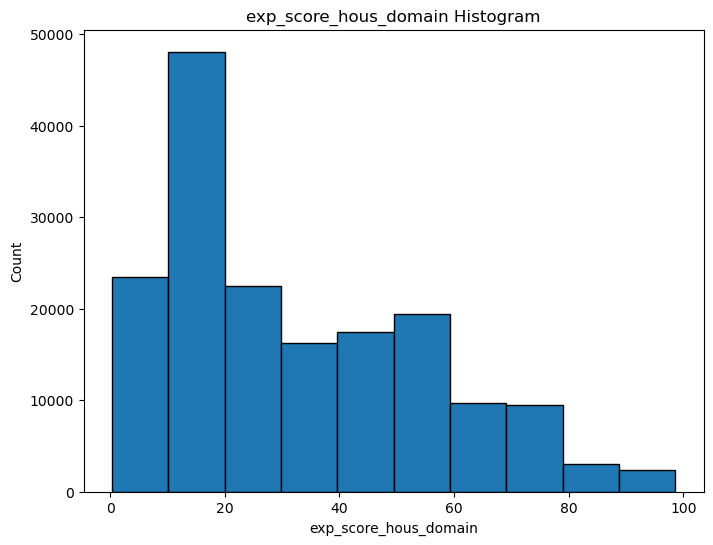

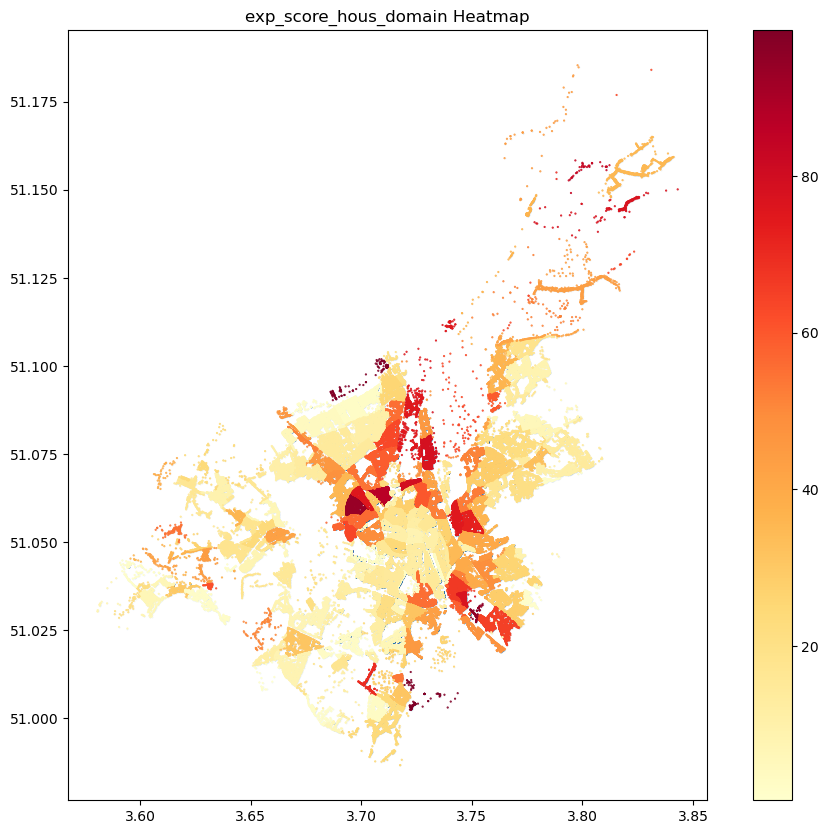

exp_score_hous_domain Summary Statistics:
count    171703.000000
mean         32.515671
std          23.274117
min           0.293449
25%          13.330744
50%          27.110269
75%          51.079573
max          98.638070
Name: exp_score_hous_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
rank_hous_domain Summary Statistics:
**************************************************



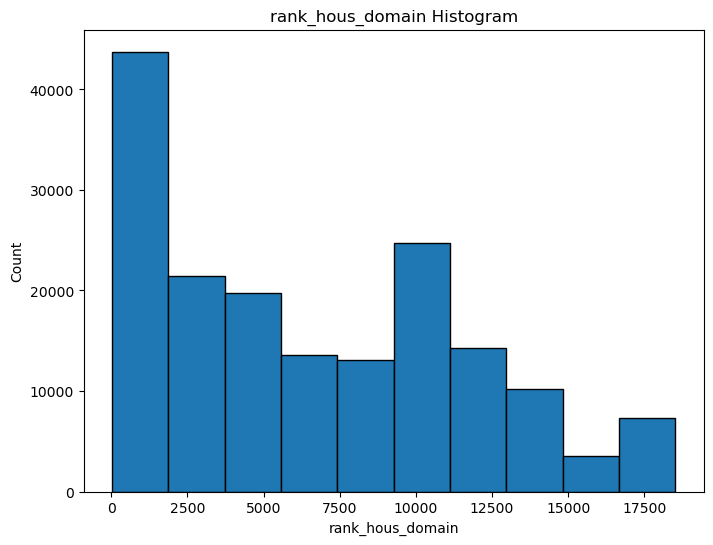

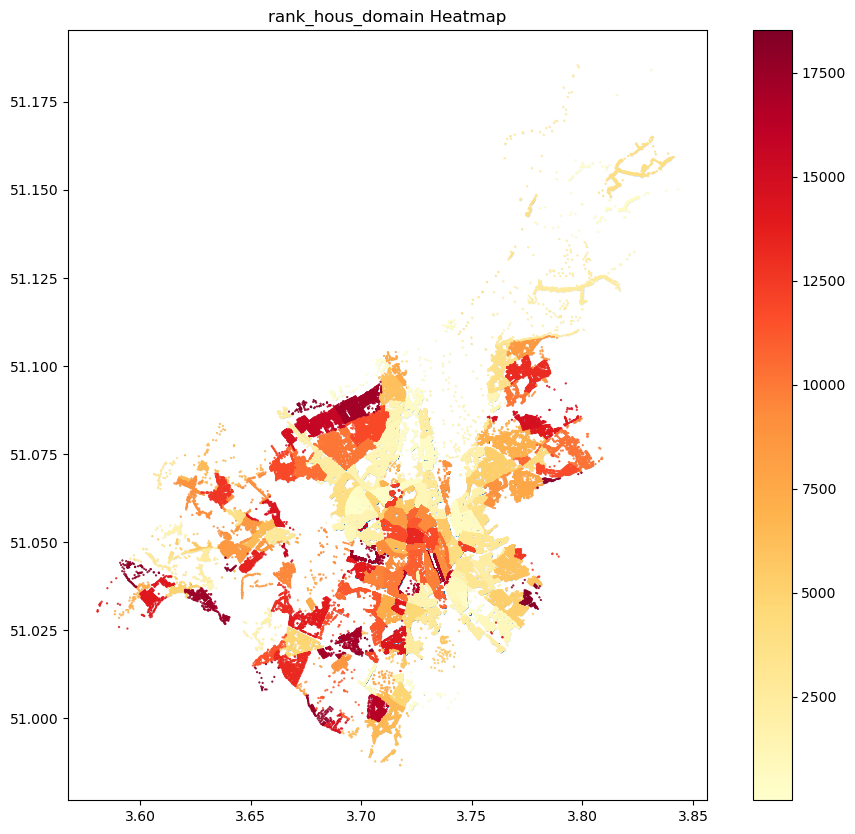

rank_hous_domain Summary Statistics:
count    171703.000000
mean       6599.675656
std        4975.155837
min          16.000000
25%        1818.000000
50%        5604.000000
75%       10403.000000
max       18524.000000
Name: rank_hous_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
deciles_hous_domain Summary Statistics:
**************************************************



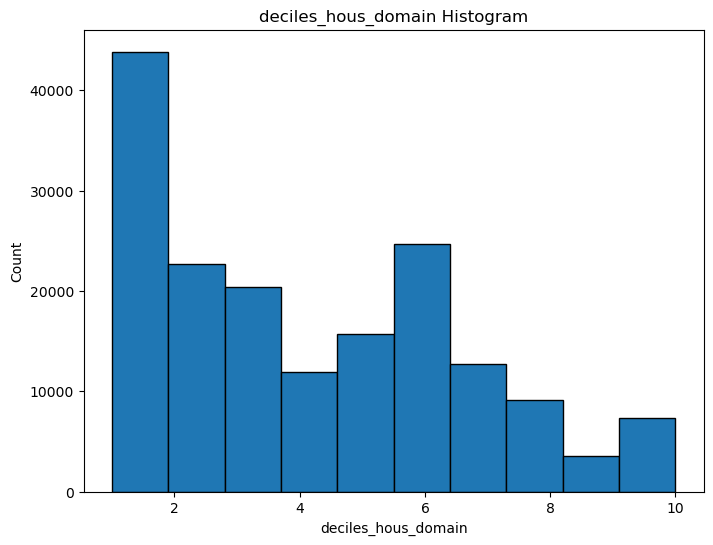

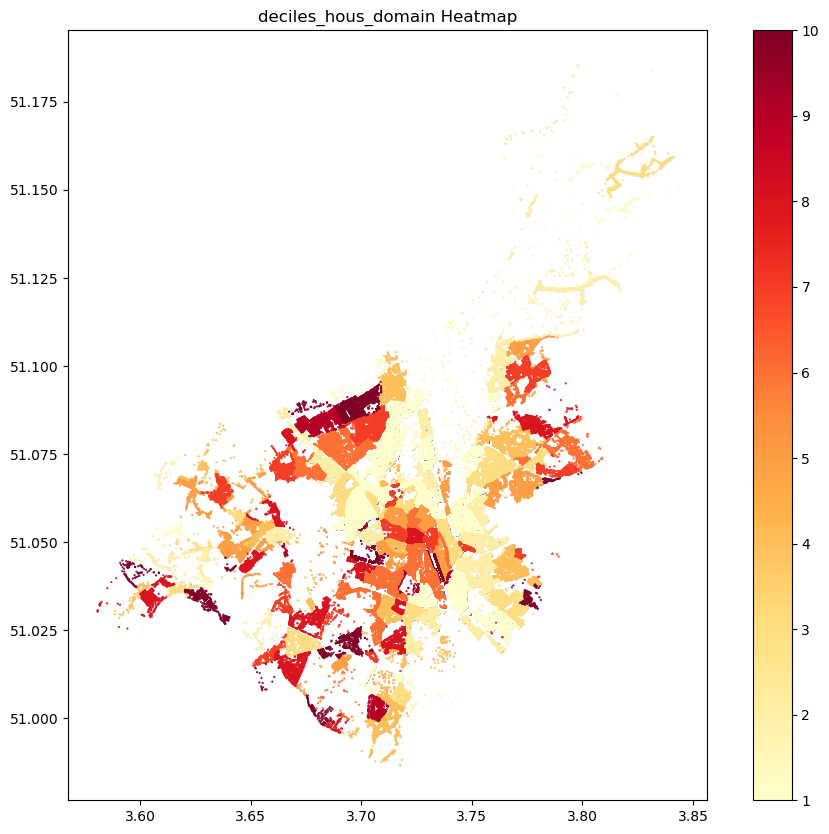

deciles_hous_domain Summary Statistics:
count    171703.000000
mean          4.021789
std           2.676481
min           1.000000
25%           1.000000
50%           3.000000
75%           6.000000
max          10.000000
Name: deciles_hous_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
deciles_crime_domain Summary Statistics:
**************************************************



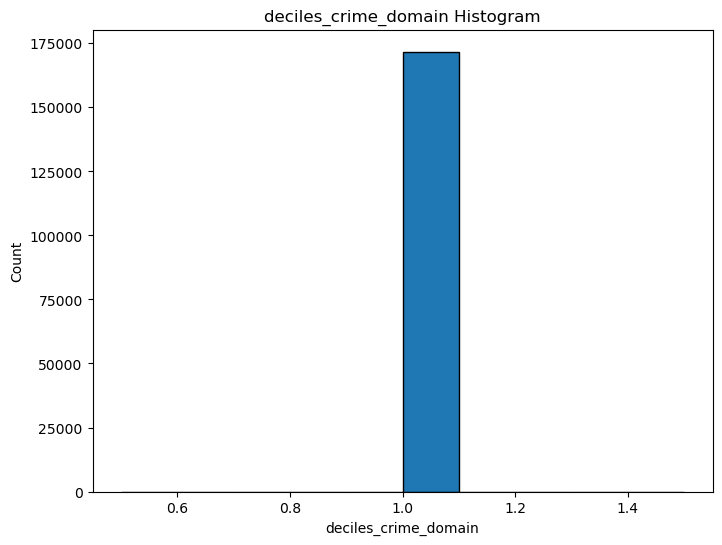

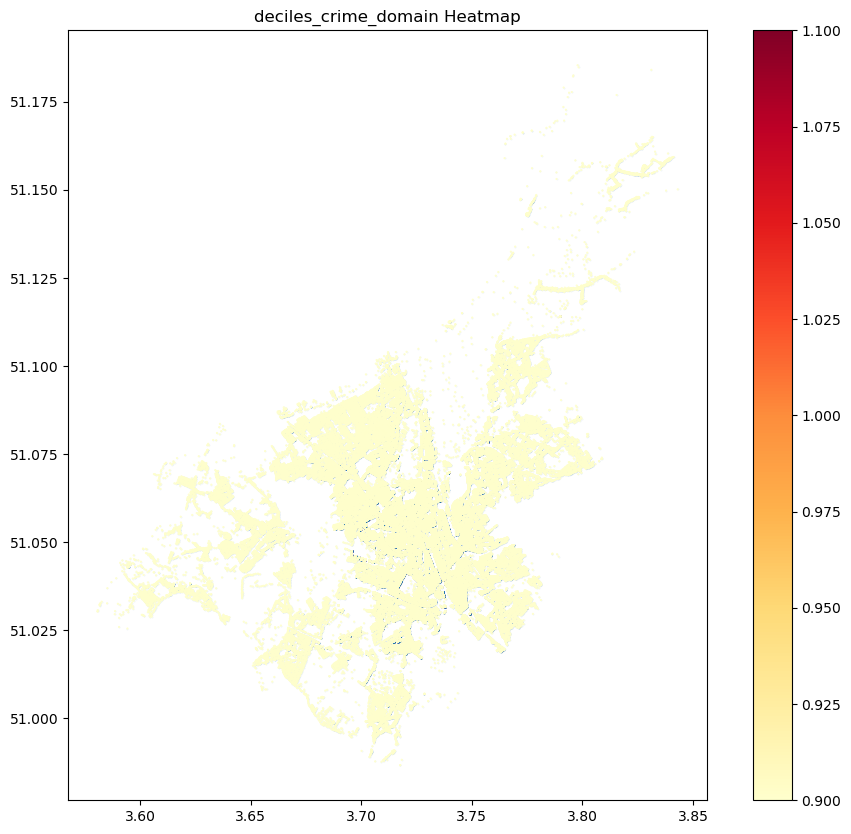

deciles_crime_domain Summary Statistics:
count    171703.0
mean          1.0
std           0.0
min           1.0
25%           1.0
50%           1.0
75%           1.0
max           1.0
Name: deciles_crime_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
exp_score_health_domain Summary Statistics:
**************************************************



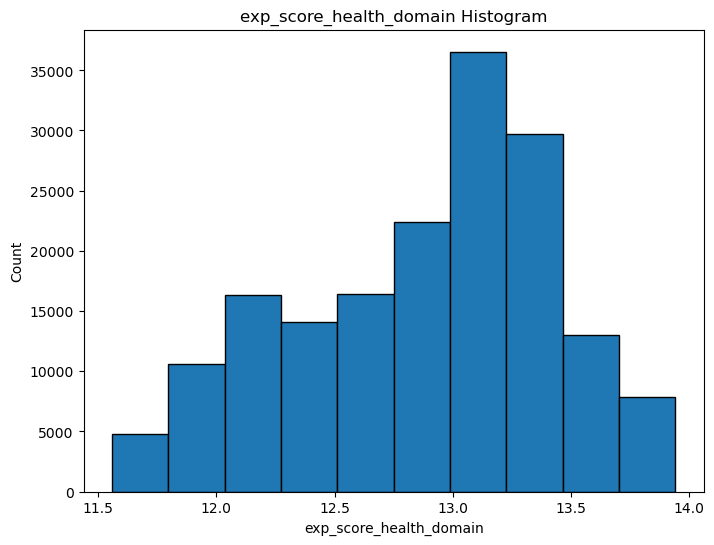

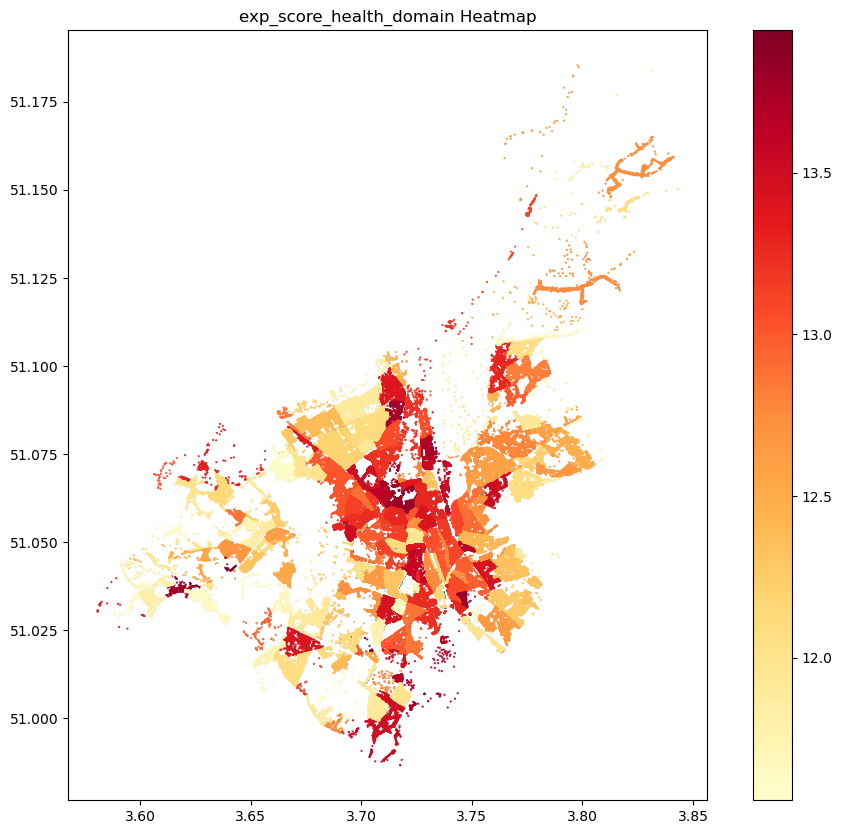

exp_score_health_domain Summary Statistics:
count    171703.000000
mean         12.862656
std           0.536433
min          11.558303
25%          12.407732
50%          12.996221
75%          13.263880
max          13.941435
Name: exp_score_health_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
rank_health_domain Summary Statistics:
**************************************************



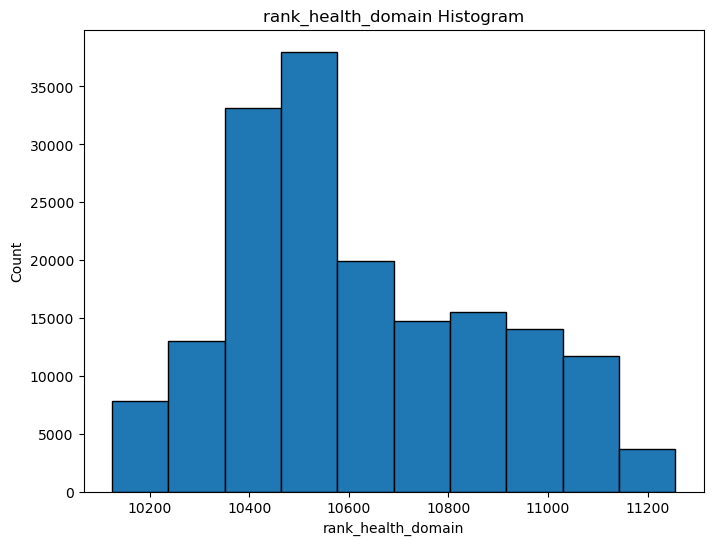

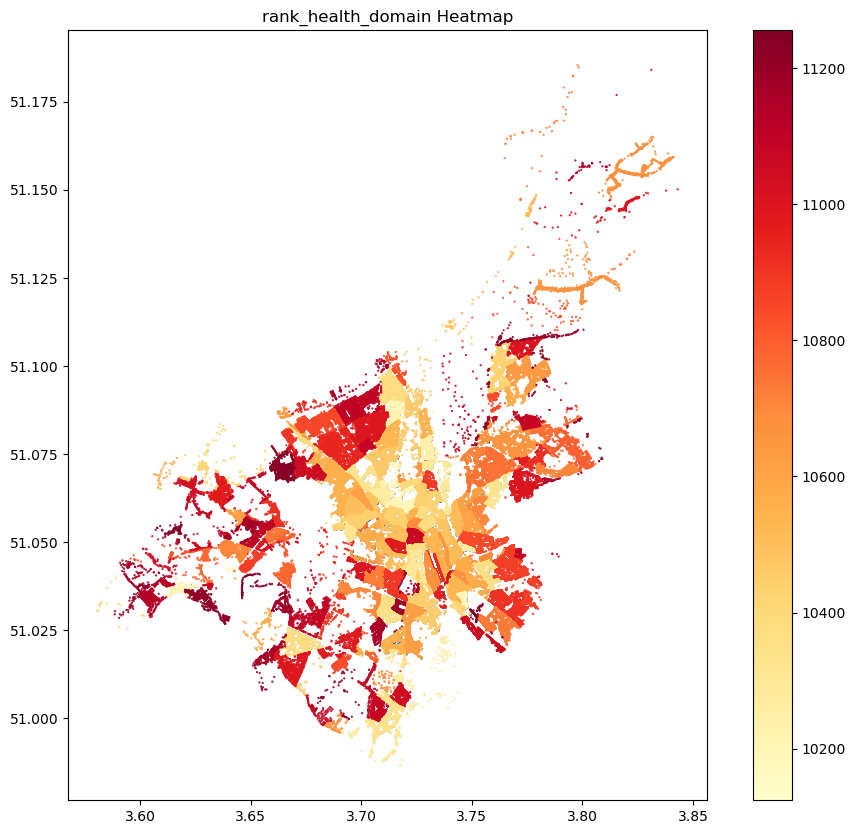

rank_health_domain Summary Statistics:
count    171703.000000
mean      10624.893572
std         254.702922
min       10124.000000
25%       10434.000000
50%       10559.000000
75%       10839.000000
max       11256.000000
Name: rank_health_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
BIMD2011_score Summary Statistics:
**************************************************



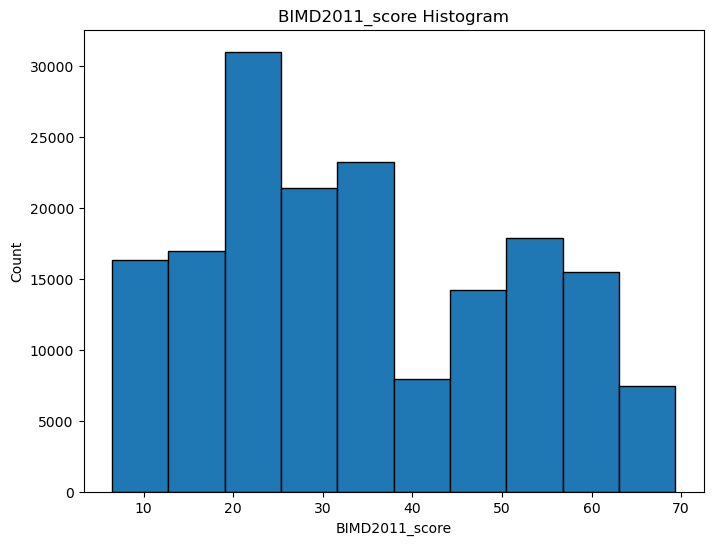

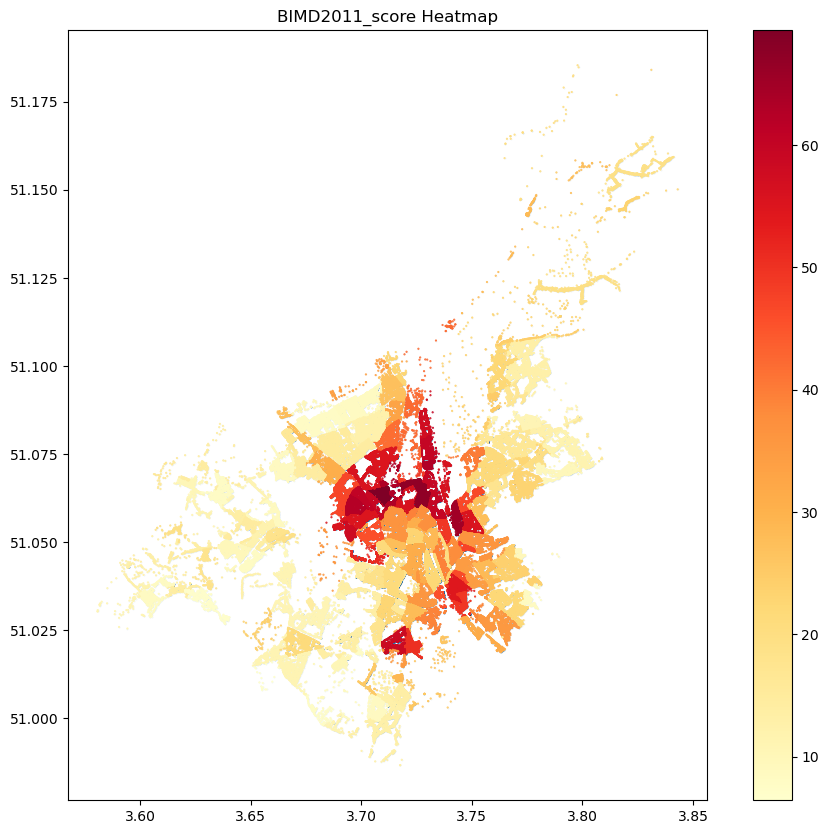

BIMD2011_score Summary Statistics:
count    171703.000000
mean         34.768642
std          16.978861
min           6.438670
25%          21.092109
50%          32.818807
75%          49.418457
max          69.375847
Name: BIMD2011_score, dtype: float64
Frac Null Values: 0.0
**************************************************
BIMD2011_rank Summary Statistics:
**************************************************



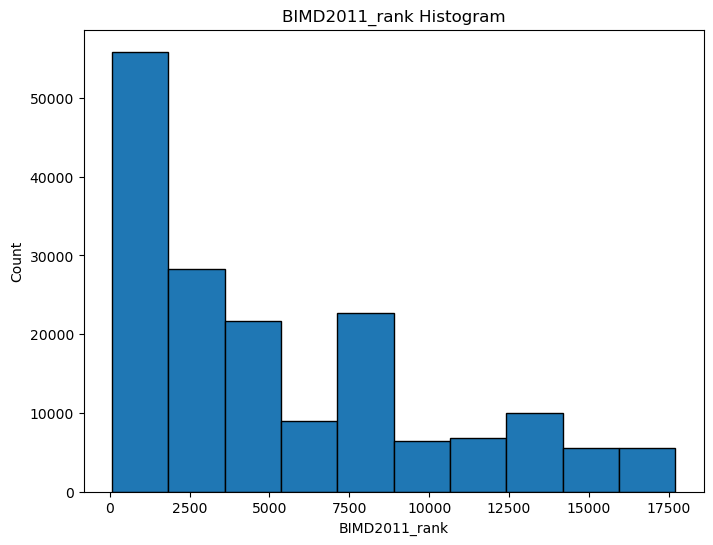

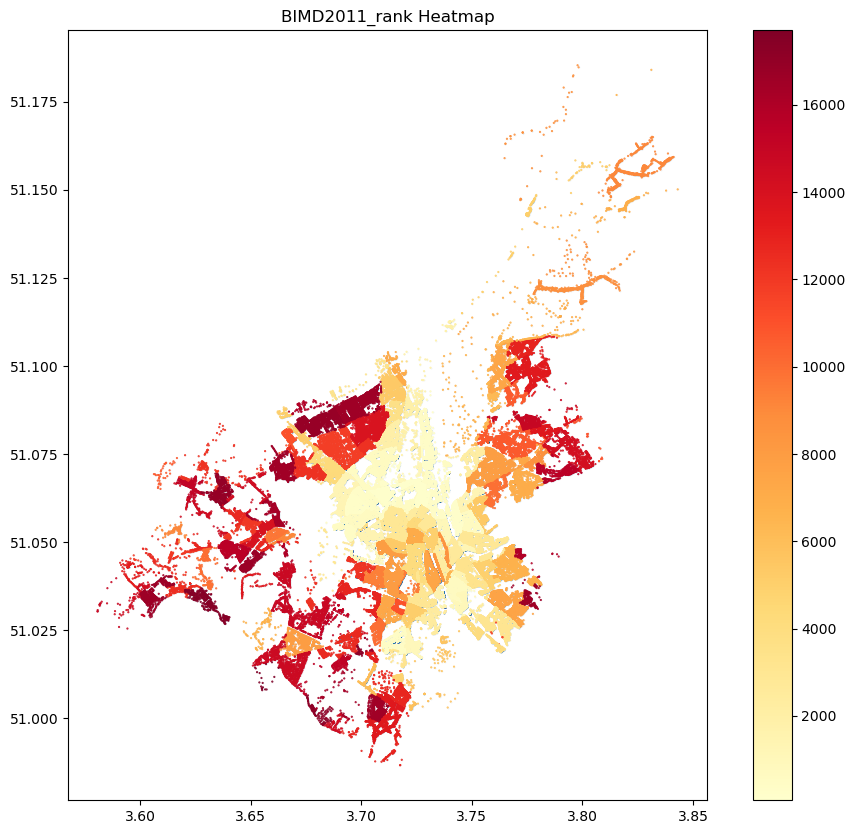

BIMD2011_rank Summary Statistics:
count    171703.000000
mean       5195.676747
std        4736.447445
min          66.000000
25%        1008.000000
50%        3653.000000
75%        7988.000000
max       17710.000000
Name: BIMD2011_rank, dtype: float64
Frac Null Values: 0.0
**************************************************
BIMD2011_deciles_domain Summary Statistics:
**************************************************



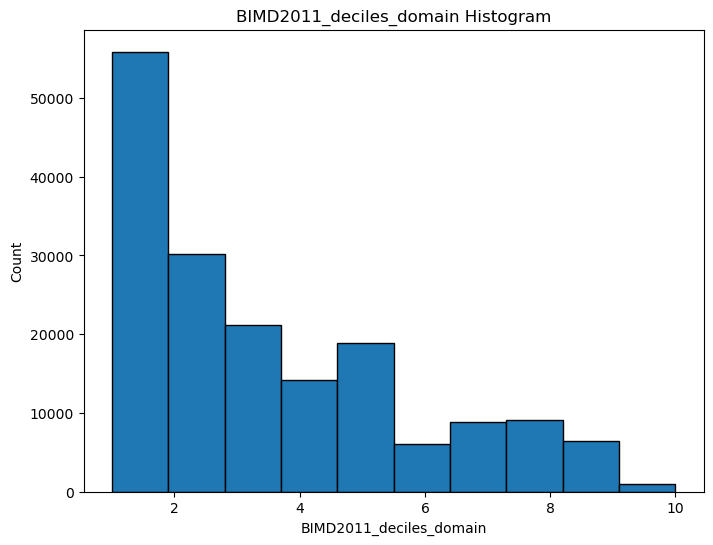

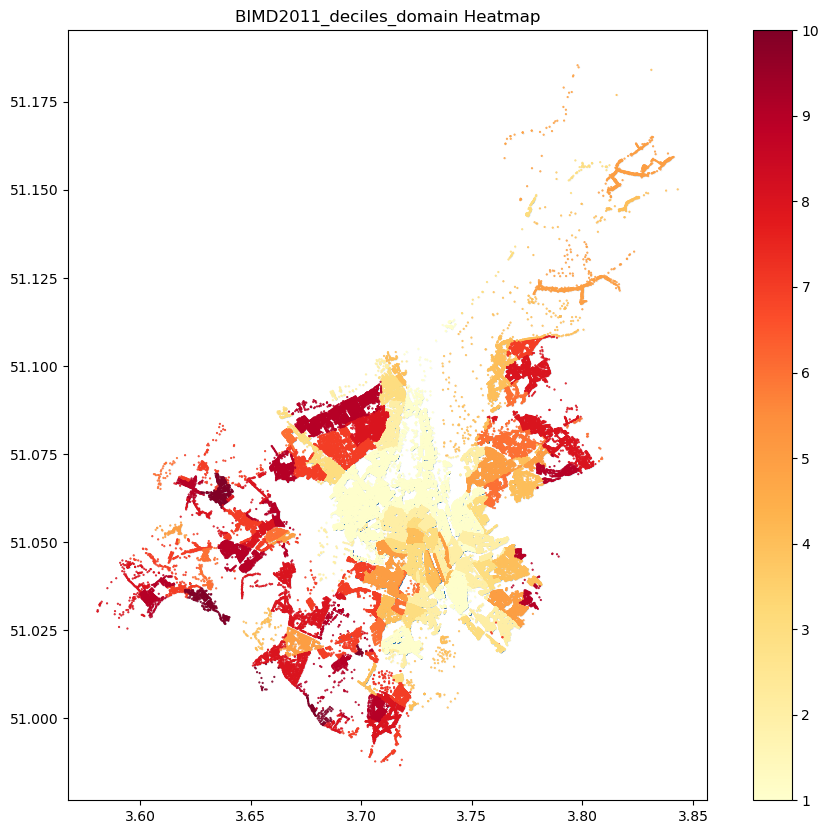

BIMD2011_deciles_domain Summary Statistics:
count    171703.000000
mean          3.314393
std           2.445537
min           1.000000
25%           1.000000
50%           2.000000
75%           5.000000
max          10.000000
Name: BIMD2011_deciles_domain, dtype: float64
Frac Null Values: 0.0
**************************************************
avg_net_tax_income Summary Statistics:
**************************************************



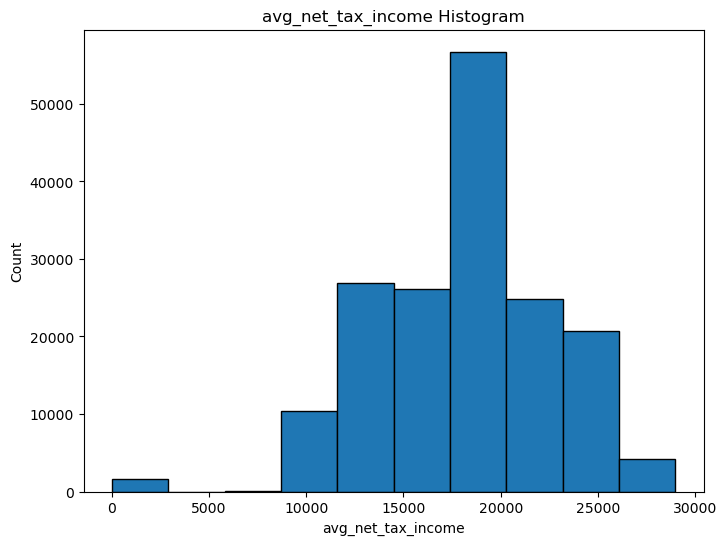

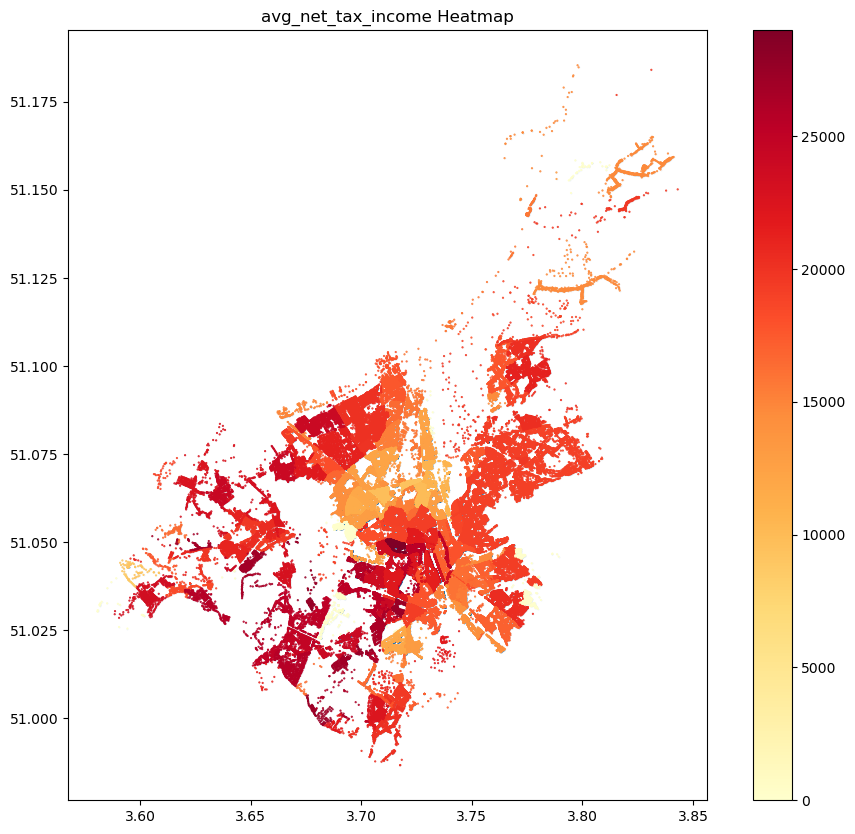

avg_net_tax_income Summary Statistics:
count    171703.000000
mean      18072.166247
std        4611.135502
min           0.000000
25%       15210.000000
50%       18935.000000
75%       20993.000000
max       28988.000000
Name: avg_net_tax_income, dtype: float64
Frac Null Values: 0.0
**************************************************
installation_max_power Summary Statistics:
**************************************************



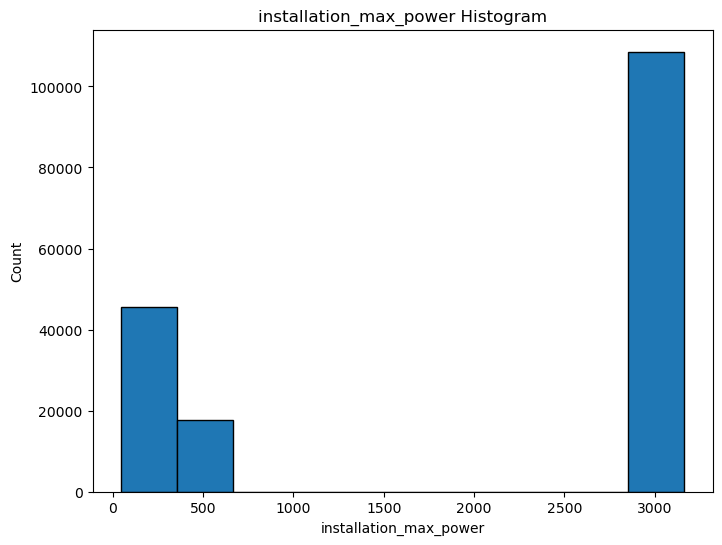

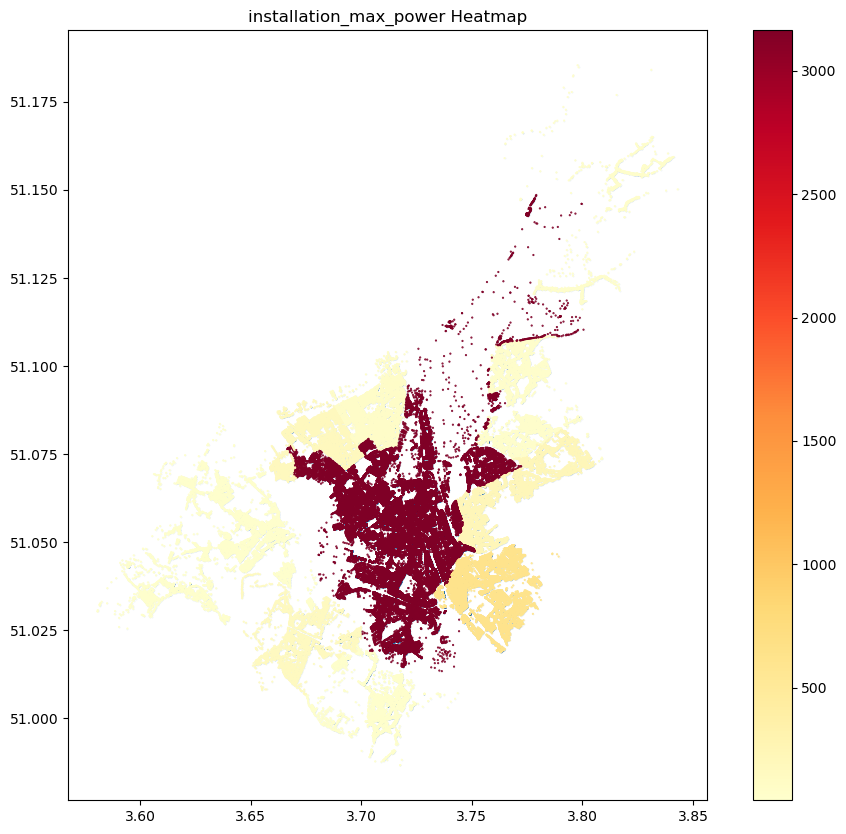

installation_max_power Summary Statistics:
count    171703.000000
mean       2097.184420
std        1405.949284
min          44.400000
25%         222.000000
50%        3163.460000
75%        3163.460000
max        3163.460000
Name: installation_max_power, dtype: float64
Frac Null Values: 0.0
**************************************************
technology_type Summary Statistics:
**************************************************



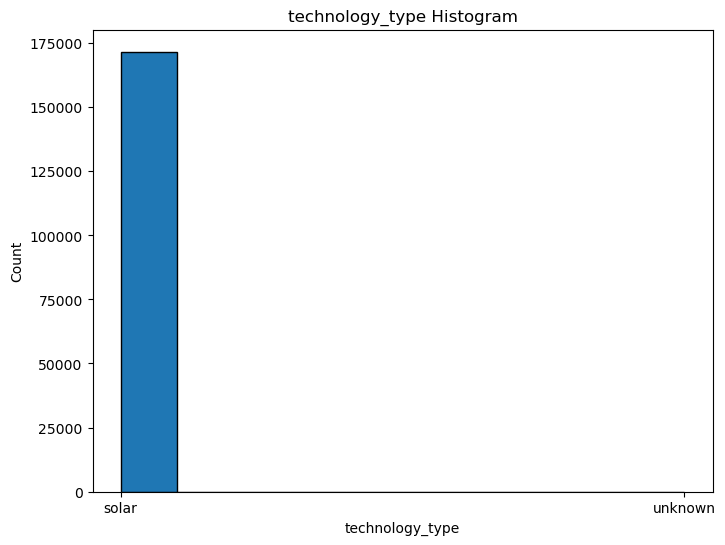

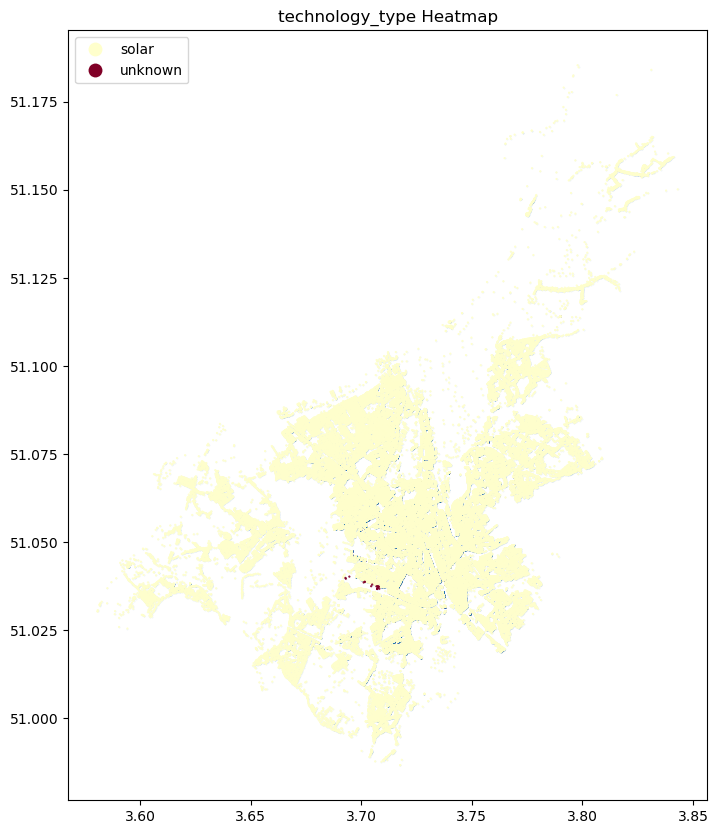

technology_type Summary Statistics:
count     171703
unique         2
top        solar
freq      171684
Name: technology_type, dtype: object
Frac Null Values: 0.0
**************************************************
power_capacity Summary Statistics:
**************************************************



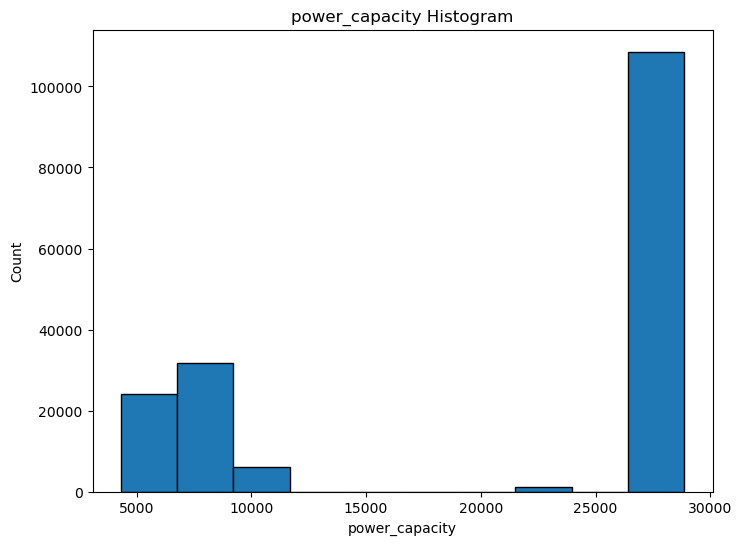

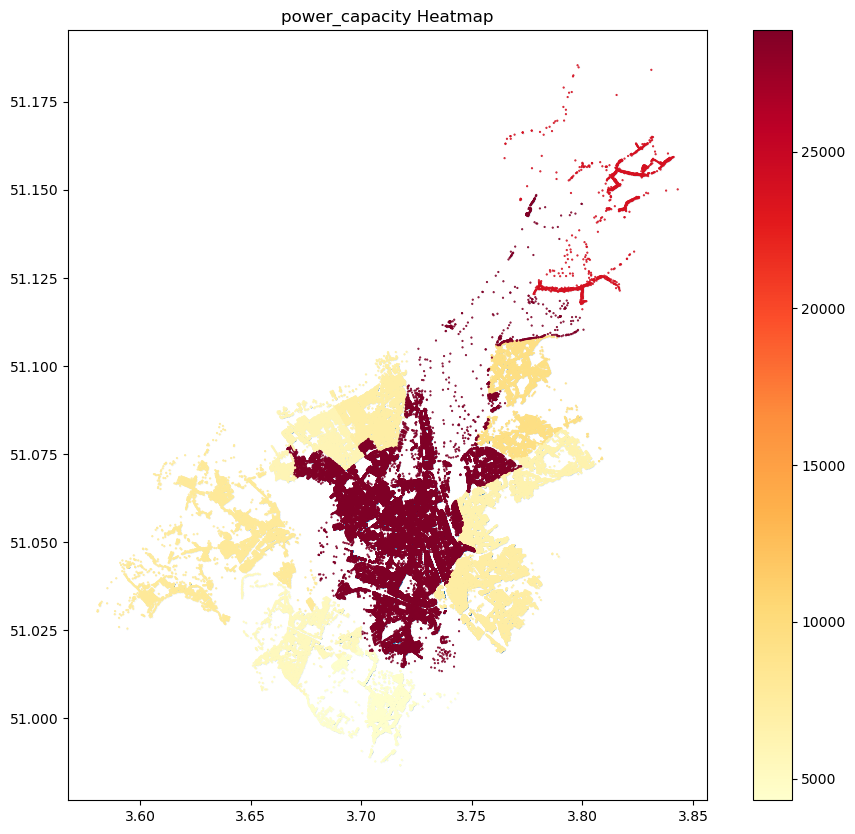

power_capacity Summary Statistics:
count    171703.000000
mean      20932.215172
std       10536.077643
min        4311.825000
25%        7214.831000
50%       28869.420000
75%       28869.420000
max       28869.420000
Name: power_capacity, dtype: float64
Frac Null Values: 0.0
**************************************************
annual_energy_use_electricity_offtake Summary Statistics:
**************************************************



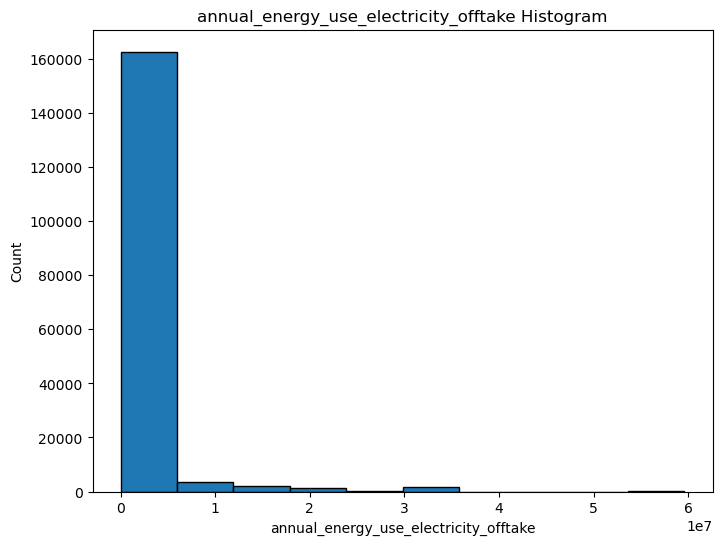

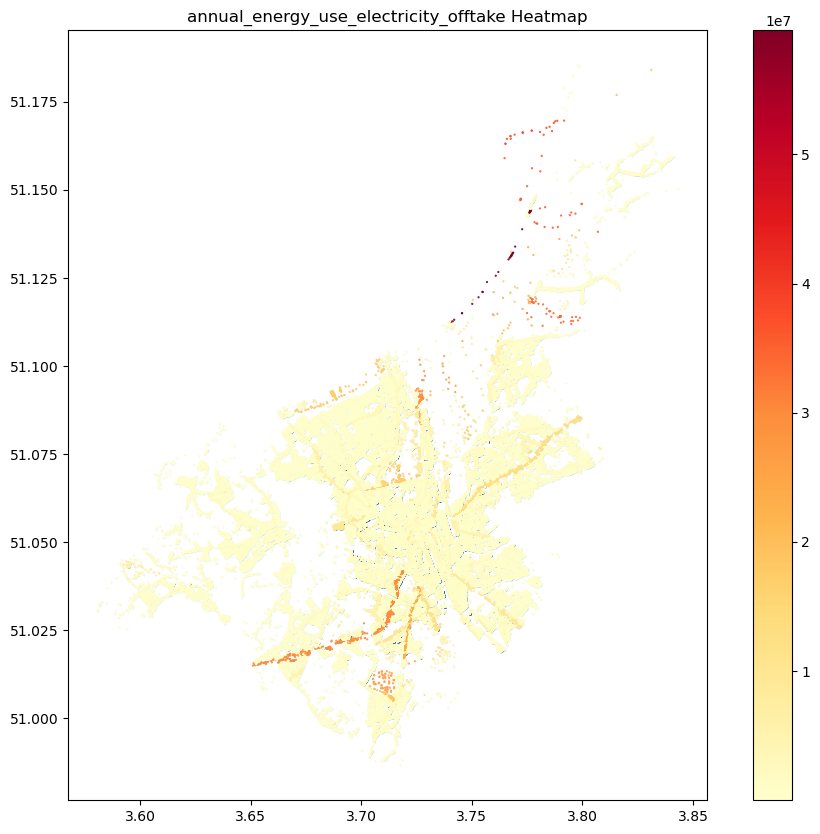

annual_energy_use_electricity_offtake Summary Statistics:
count    1.717030e+05
mean     1.767578e+06
std      4.260318e+06
min      1.204289e+03
25%      2.212027e+05
50%      5.336415e+05
75%      1.445940e+06
max      5.960233e+07
Name: annual_energy_use_electricity_offtake, dtype: float64
Frac Null Values: 0.0
**************************************************
annual_energy_use_natural_gas_offtake Summary Statistics:
**************************************************



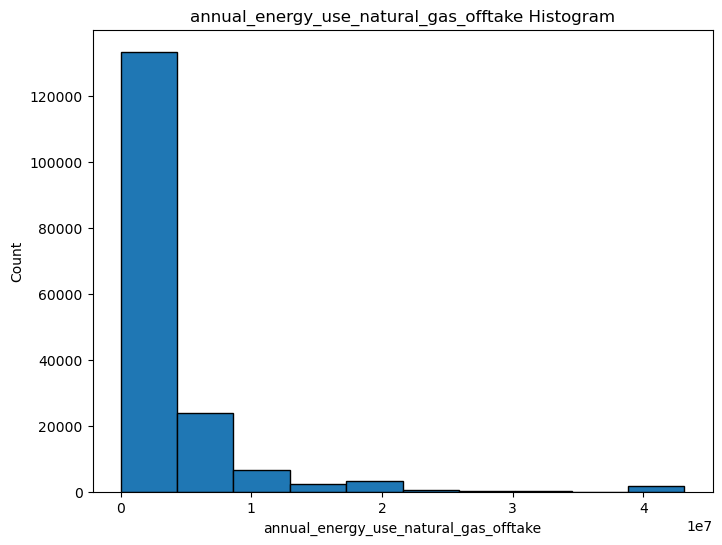

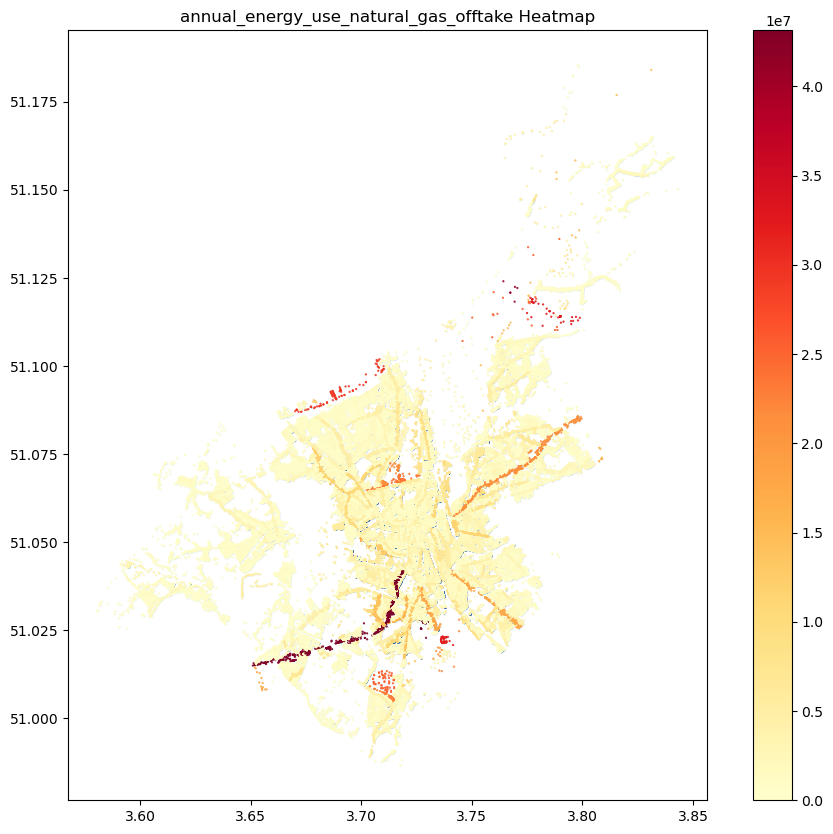

annual_energy_use_natural_gas_offtake Summary Statistics:
count    1.717030e+05
mean     3.459744e+06
std      5.581423e+06
min      0.000000e+00
25%      7.818301e+05
50%      1.687578e+06
75%      3.844985e+06
max      4.314038e+07
Name: annual_energy_use_natural_gas_offtake, dtype: float64
Frac Null Values: 0.0
**************************************************
number_access_points_electricity_offtake Summary Statistics:
**************************************************



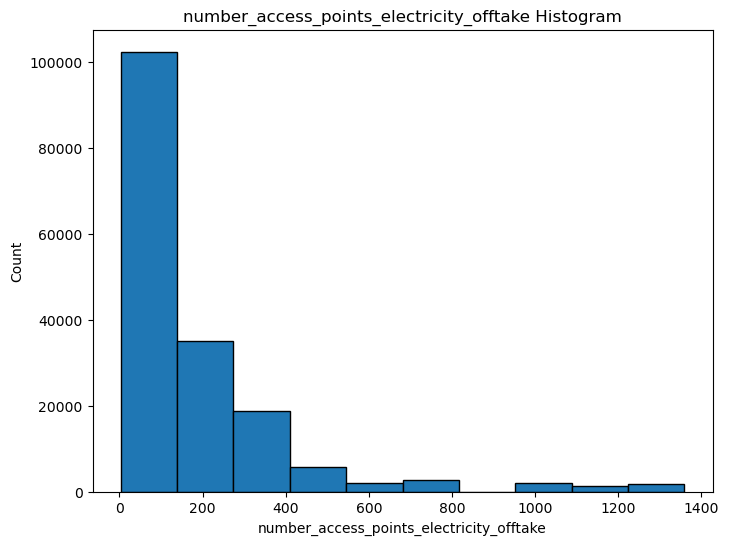

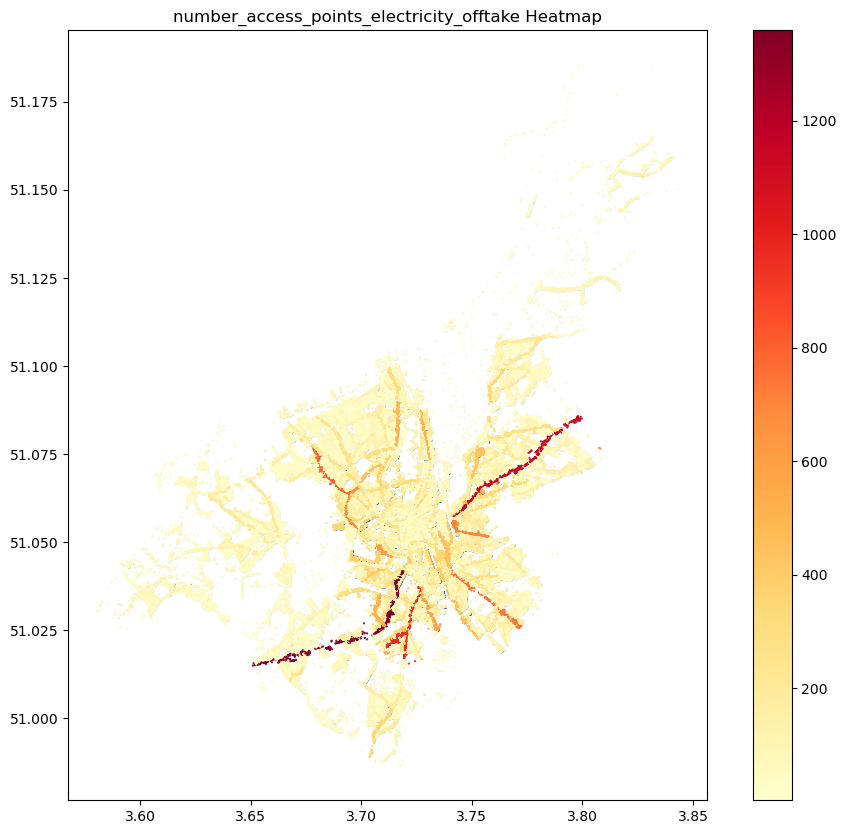

number_access_points_electricity_offtake Summary Statistics:
count    171703.00000
mean        184.24781
std         225.54755
min           3.00000
25%          54.00000
50%         107.00000
75%         223.00000
max        1359.00000
Name: number_access_points_electricity_offtake, dtype: float64
Frac Null Values: 0.0
**************************************************
number_access_points_natural_gas_offtake Summary Statistics:
**************************************************



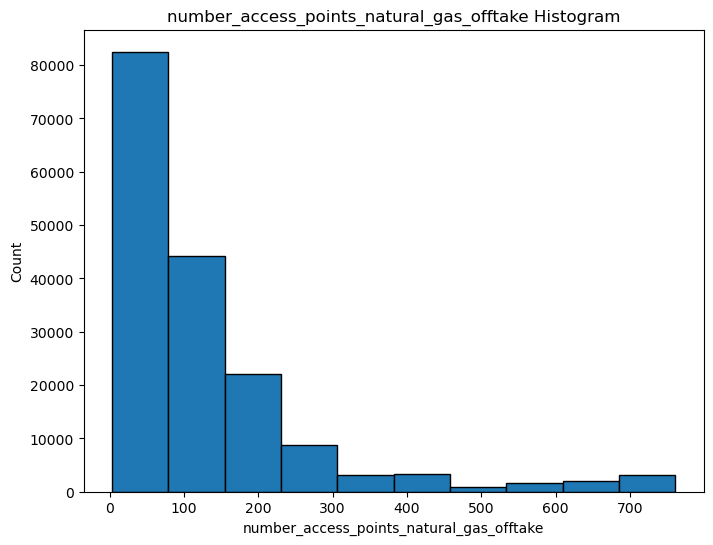

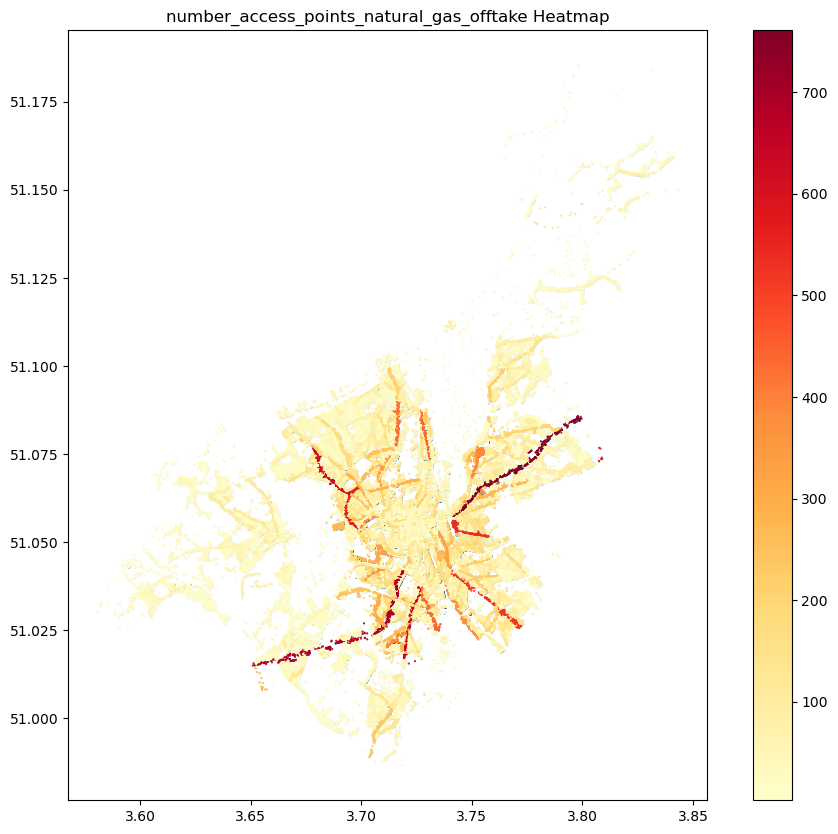

number_access_points_natural_gas_offtake Summary Statistics:
count    171703.000000
mean        127.553463
std         141.980163
min           3.000000
25%          39.000000
50%          82.000000
75%         160.000000
max         761.000000
Name: number_access_points_natural_gas_offtake, dtype: float64
Frac Null Values: 0.0


In [ ]:
#Features
 for column in info_columns:
     plot_summary(df,column)

**************************************************
building_type Summary Statistics:
**************************************************



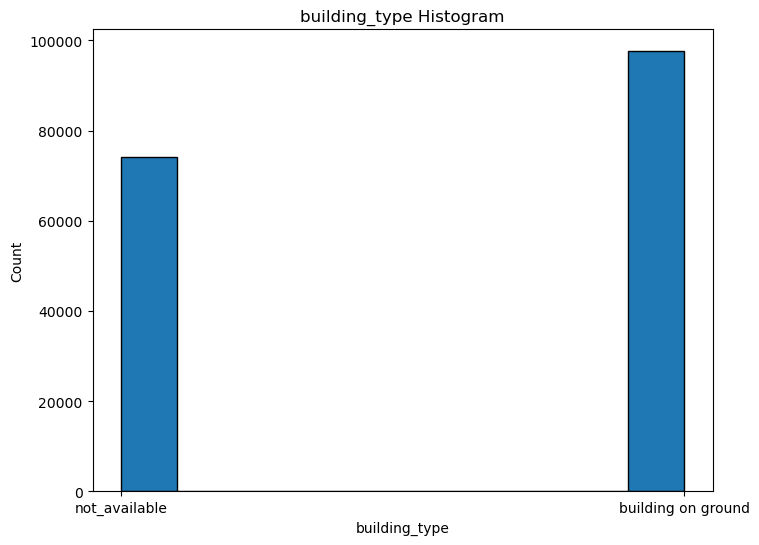

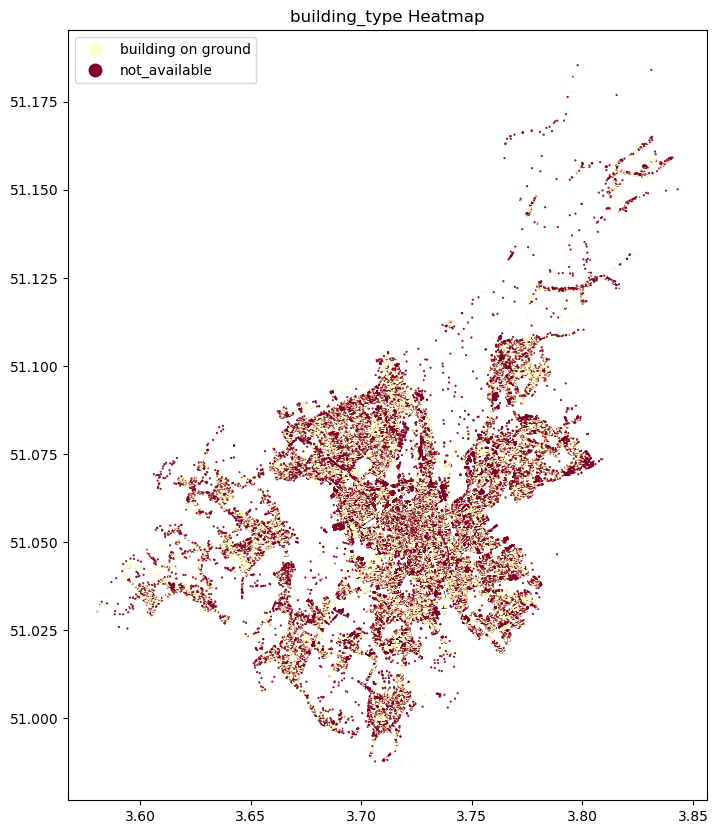

building_type Summary Statistics:
count                 171703
unique                     2
top       building on ground
freq                   97559
Name: building_type, dtype: object
Frac Null Values: 0.0
**************************************************
building_cat Summary Statistics:
**************************************************



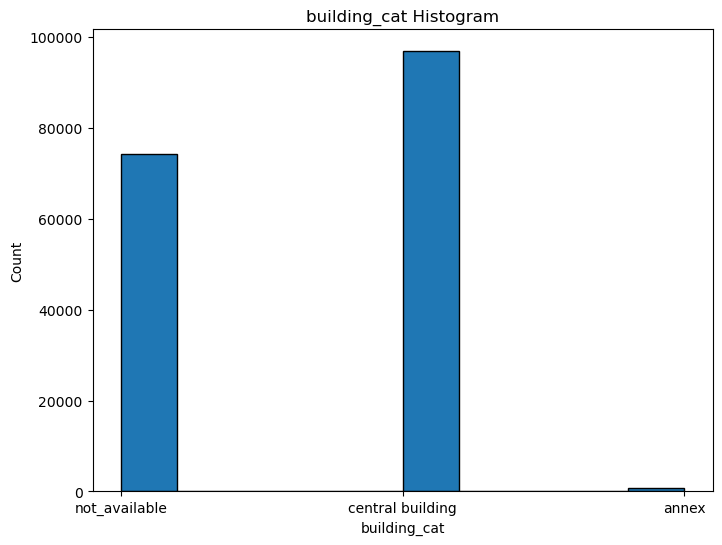

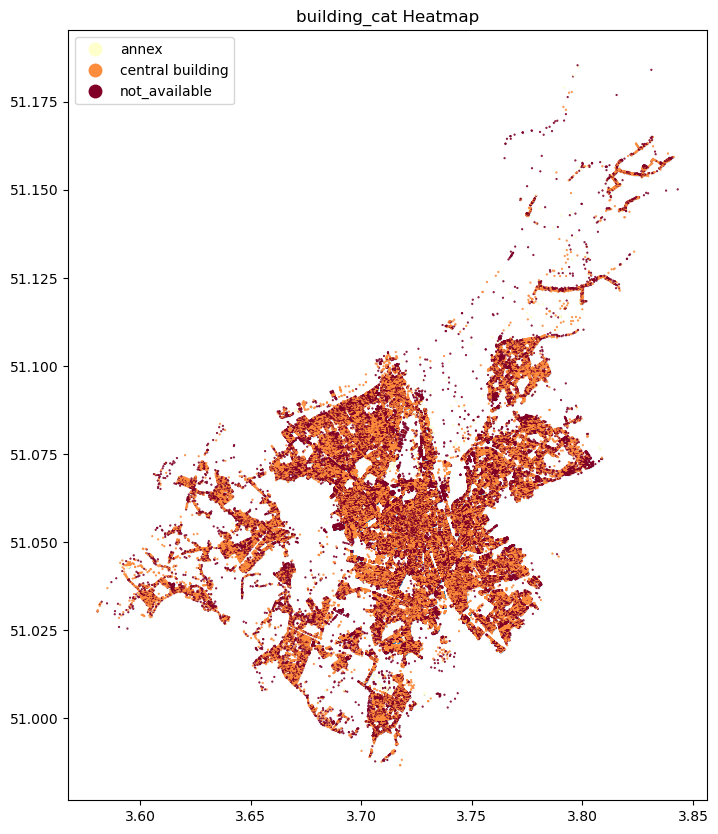

building_cat Summary Statistics:
count               171703
unique                   3
top       central building
freq                 96772
Name: building_cat, dtype: object
Frac Null Values: 0.0
**************************************************
building_surface_area Summary Statistics:
**************************************************



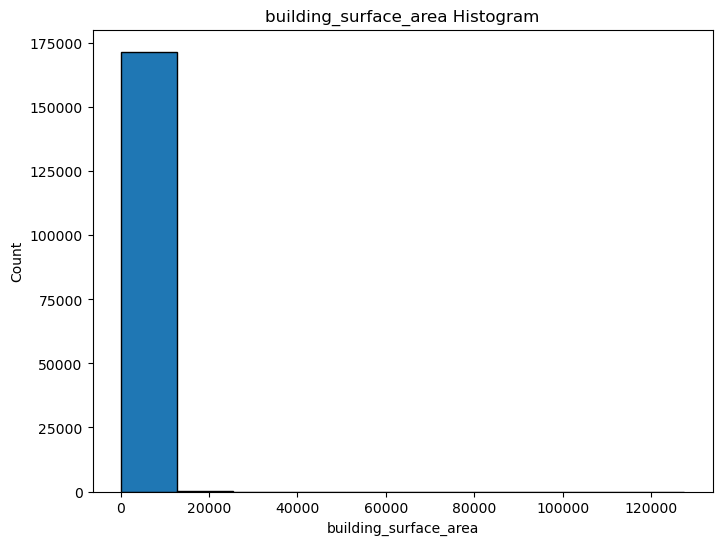

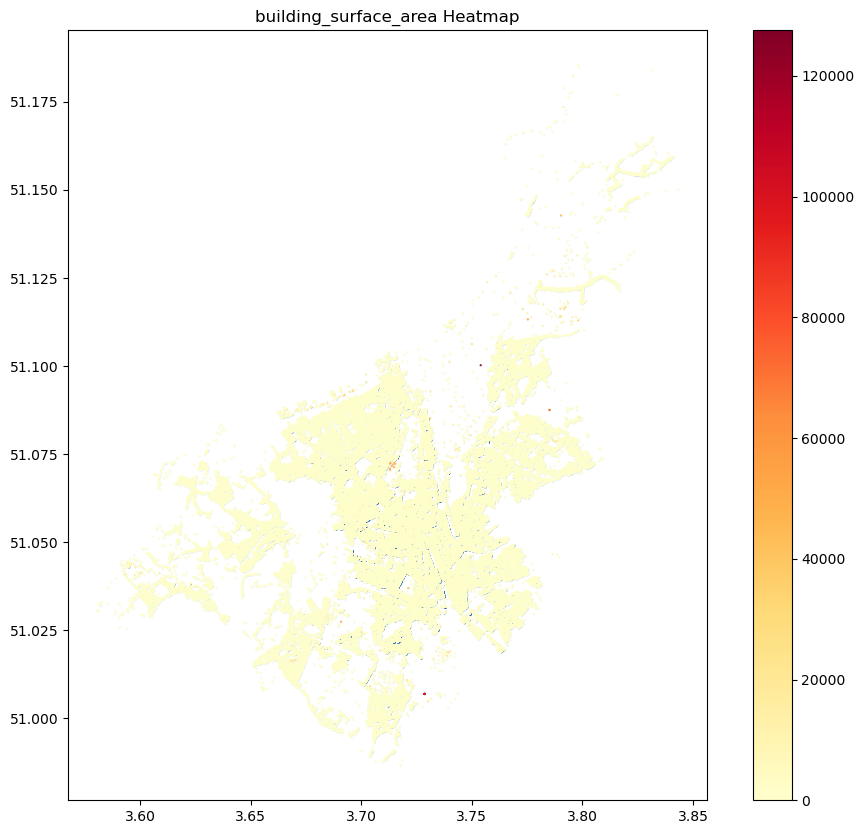

building_surface_area Summary Statistics:
count    171703.000000
mean        225.635079
std        1165.223726
min           0.000000
25%           0.000000
50%          60.010000
75%         146.610000
max      127531.280000
Name: building_surface_area, dtype: float64
Frac Null Values: 0.0
**************************************************
building_length Summary Statistics:
**************************************************



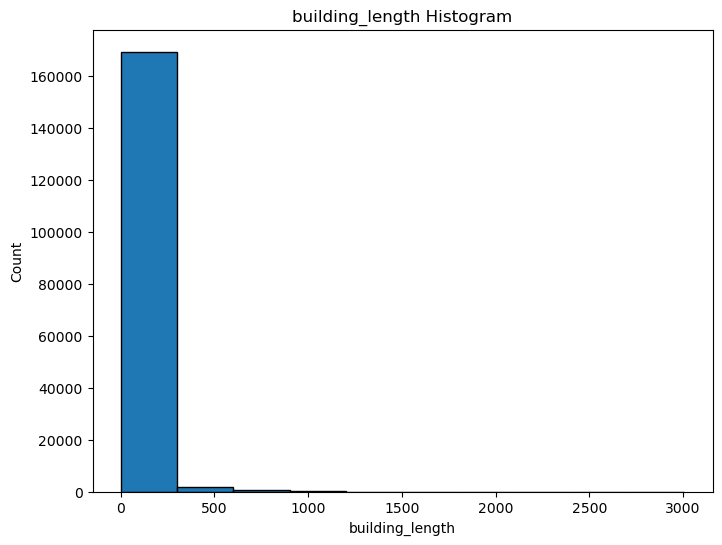

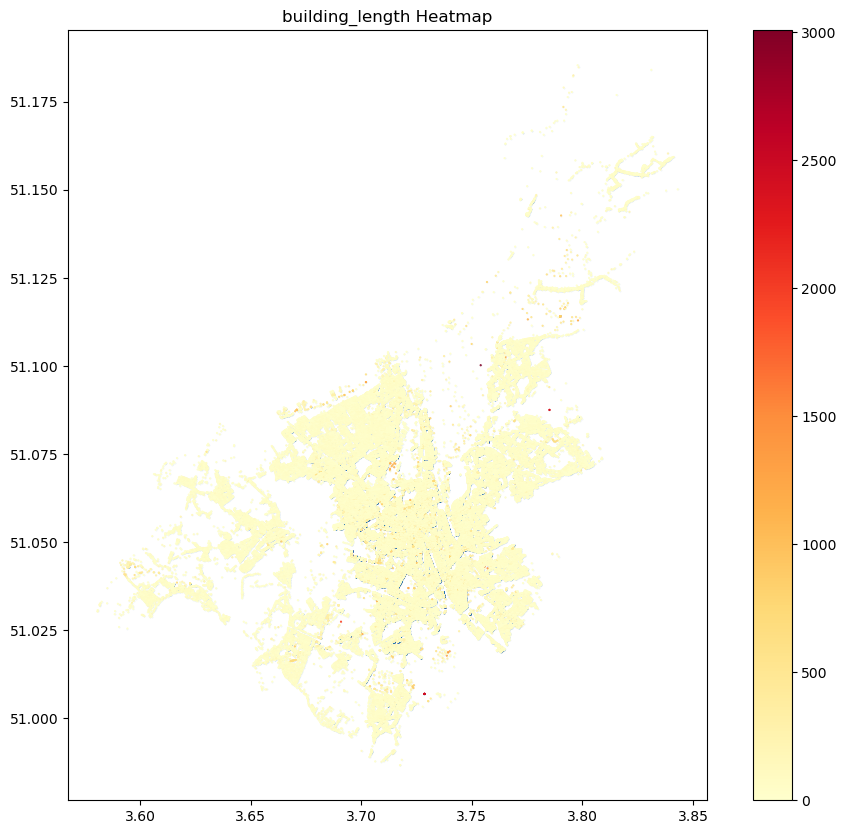

building_length Summary Statistics:
count    171703.000000
mean         45.158387
std          77.144941
min           0.000000
25%           0.000000
50%          35.620000
75%          56.080000
max        3007.090000
Name: building_length, dtype: float64
Frac Null Values: 0.0
**************************************************
solar_opportunity_area Summary Statistics:
**************************************************



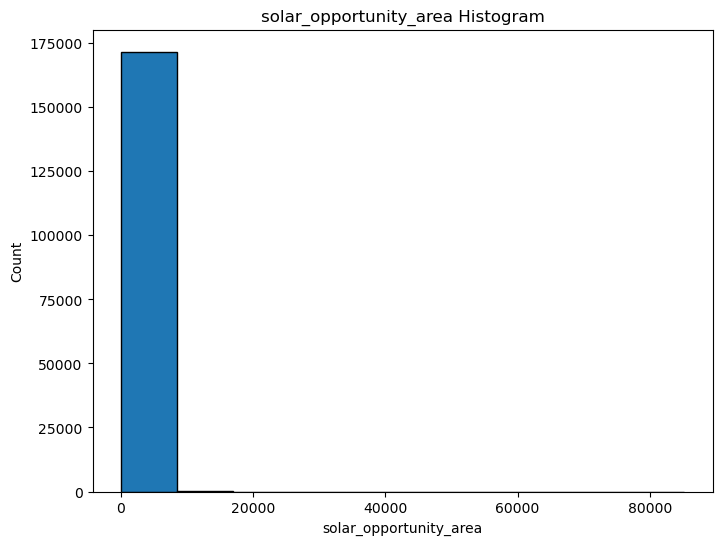

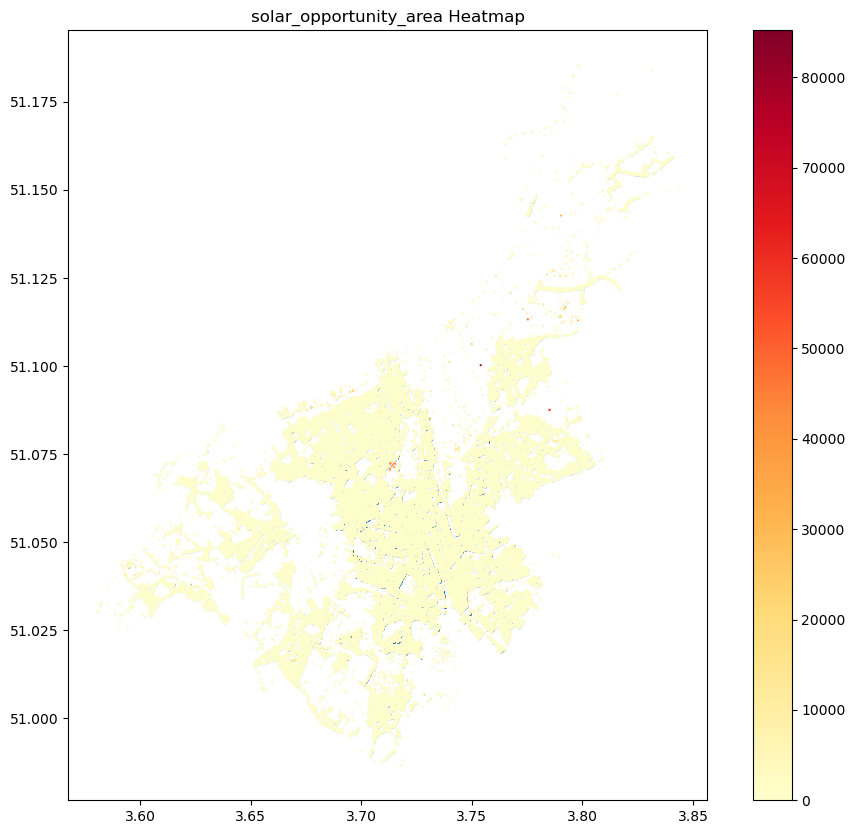

solar_opportunity_area Summary Statistics:
count    171703.000000
mean         96.968265
std         631.993812
min           0.000000
25%           0.000000
50%          17.000000
75%          57.000000
max       85204.000000
Name: solar_opportunity_area, dtype: float64
Frac Null Values: 0.0
**************************************************
solar_opportunity_3d Summary Statistics:
**************************************************



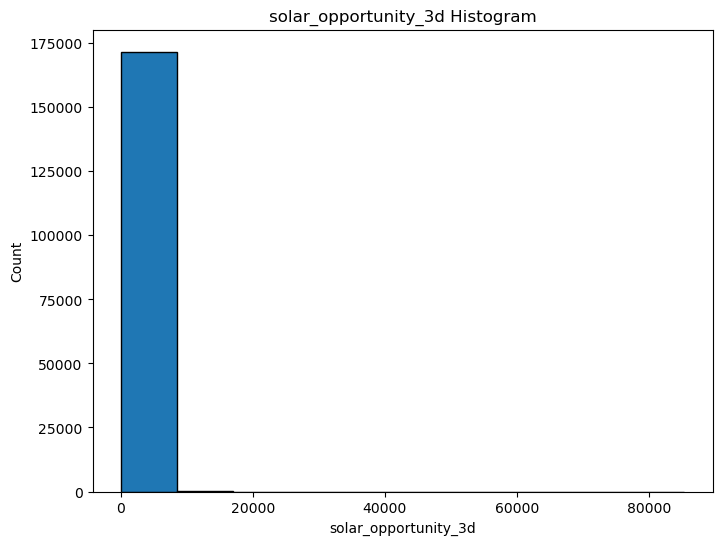

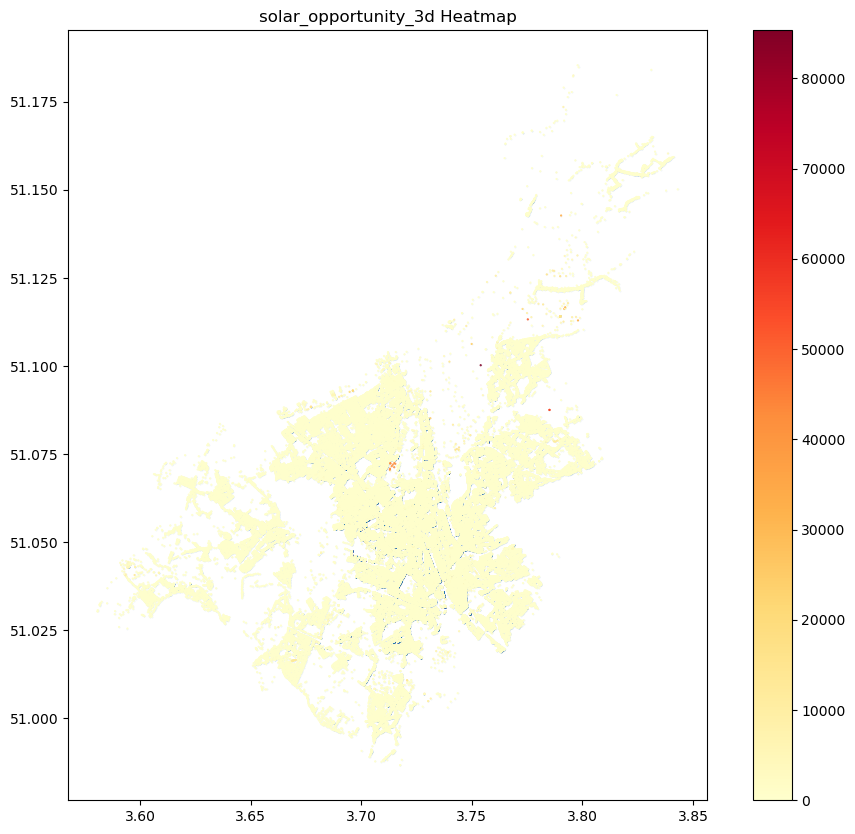

solar_opportunity_3d Summary Statistics:
count    171703.000000
mean        101.721176
std         636.171949
min           0.000000
25%           0.000000
50%          23.000000
75%          66.000000
max       85321.000000
Name: solar_opportunity_3d, dtype: float64
Frac Null Values: 0.0
**************************************************
roof_slope Summary Statistics:
**************************************************



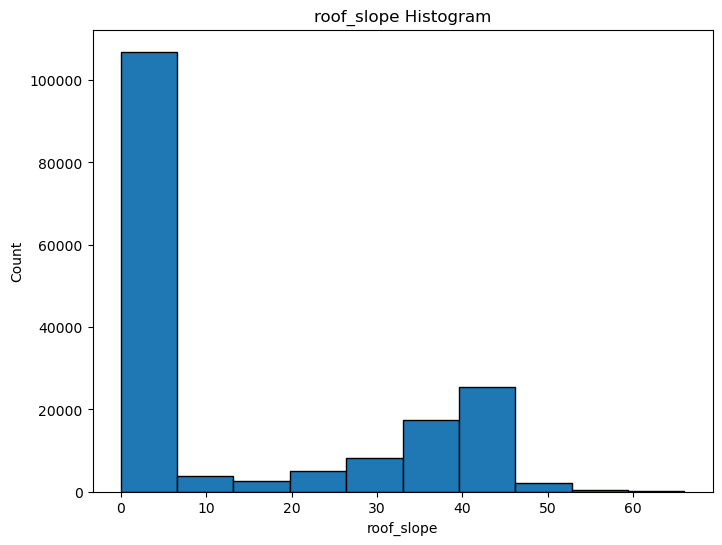

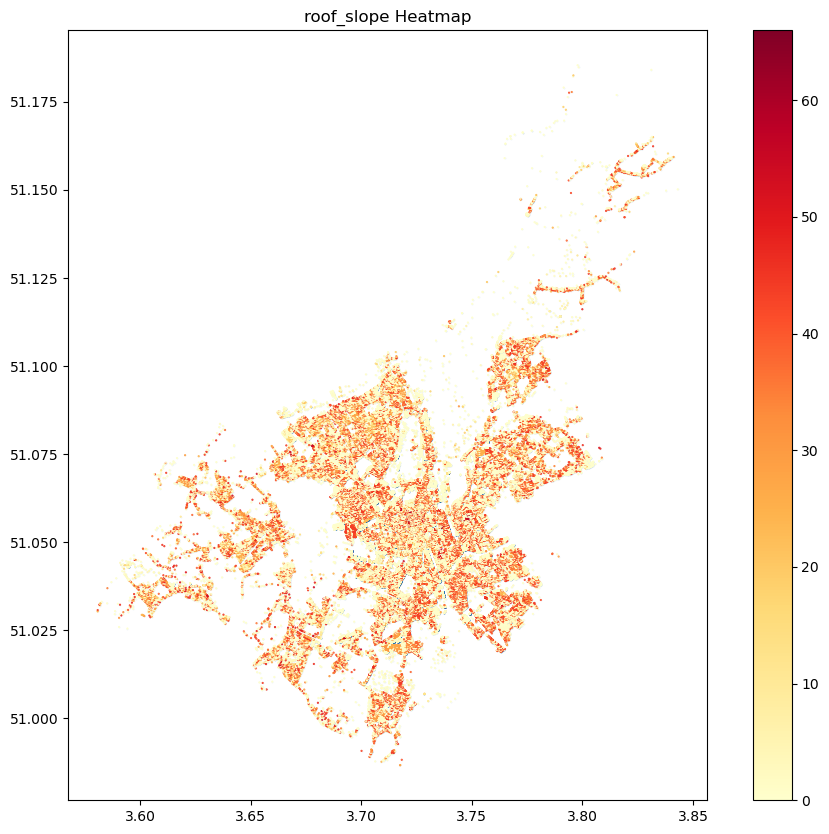

roof_slope Summary Statistics:
count    171703.000000
mean         13.604922
std          17.936065
min           0.000000
25%           0.000000
50%           1.000000
75%          34.000000
max          66.000000
Name: roof_slope, dtype: float64
Frac Null Values: 0.0
**************************************************
roof_aspect Summary Statistics:
**************************************************



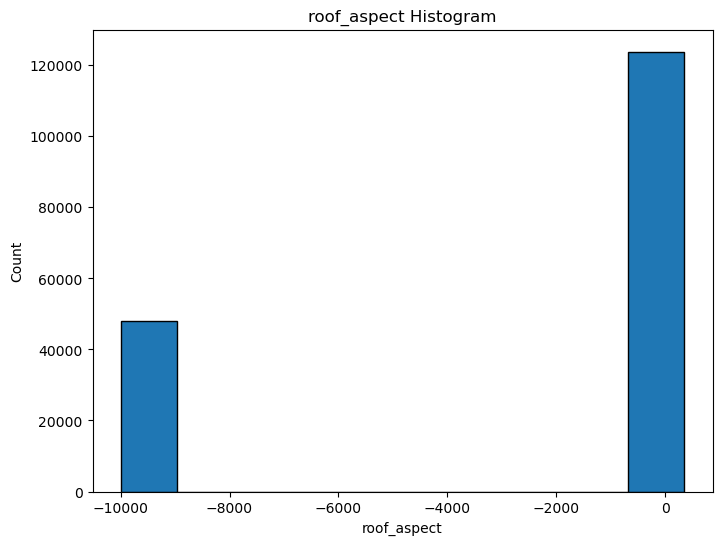

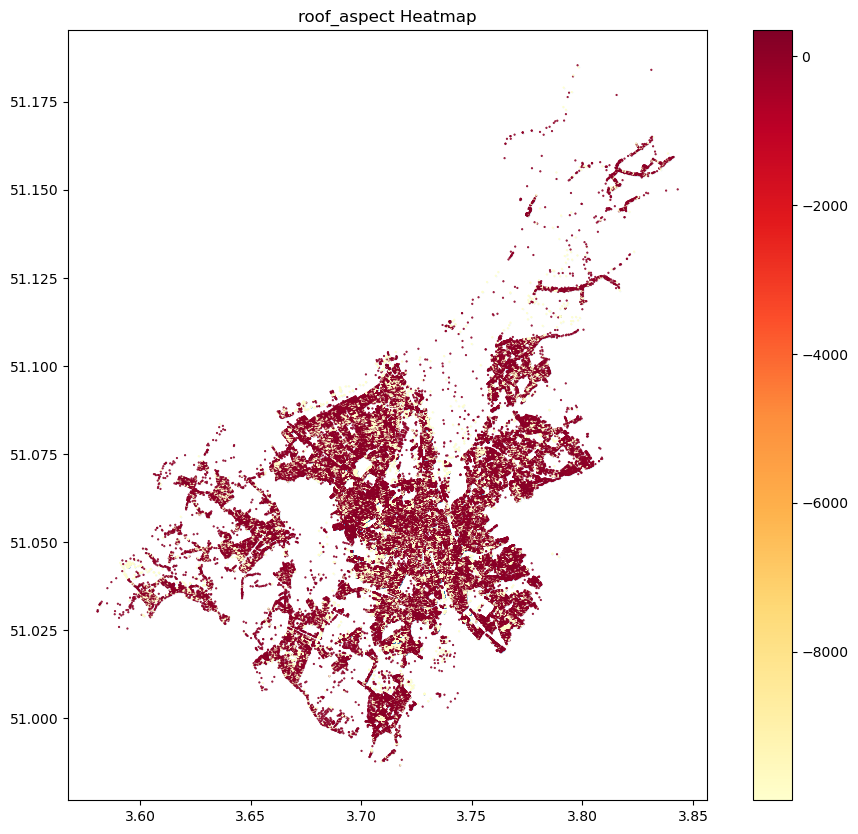

roof_aspect Summary Statistics:
count    171703.000000
mean      -2739.306139
std        4518.780223
min       -9999.000000
25%       -9999.000000
50%           0.000000
75%         130.000000
max         352.000000
Name: roof_aspect, dtype: float64
Frac Null Values: 0.0
**************************************************
solar_irradiation Summary Statistics:
**************************************************



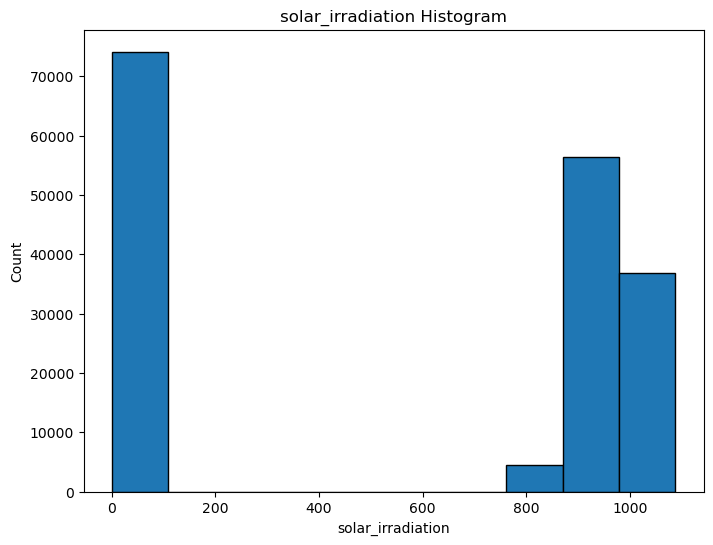

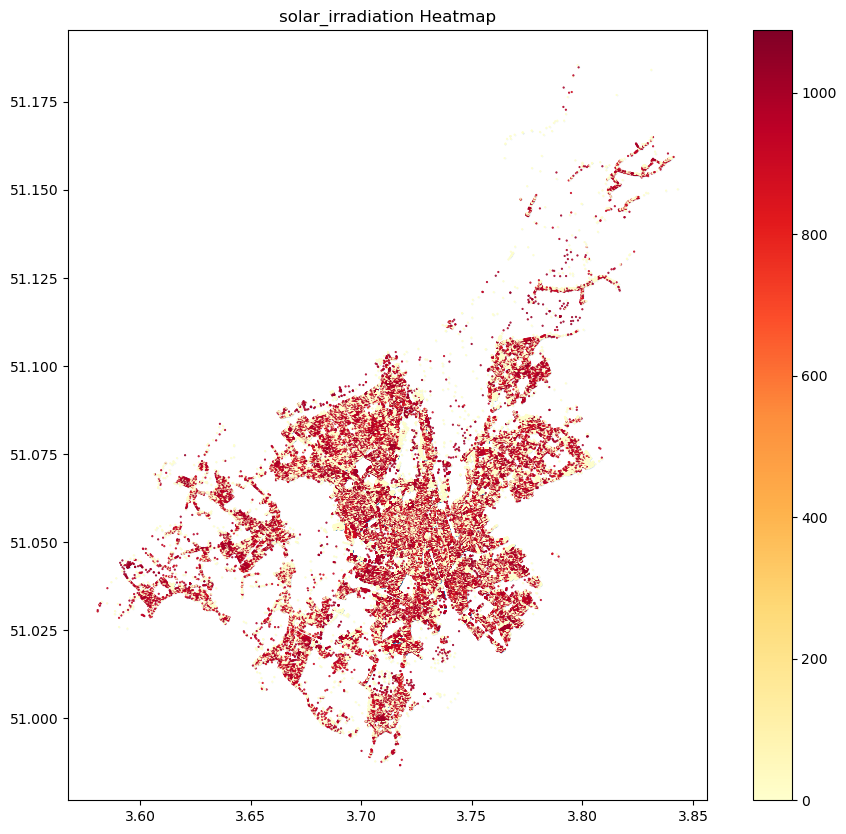

solar_irradiation Summary Statistics:
count    171703.000000
mean        544.170579
std         475.617375
min           0.000000
25%           0.000000
50%         896.000000
75%         973.000000
max        1088.000000
Name: solar_irradiation, dtype: float64
Frac Null Values: 0.0
**************************************************
total_solar_irradiation Summary Statistics:
**************************************************



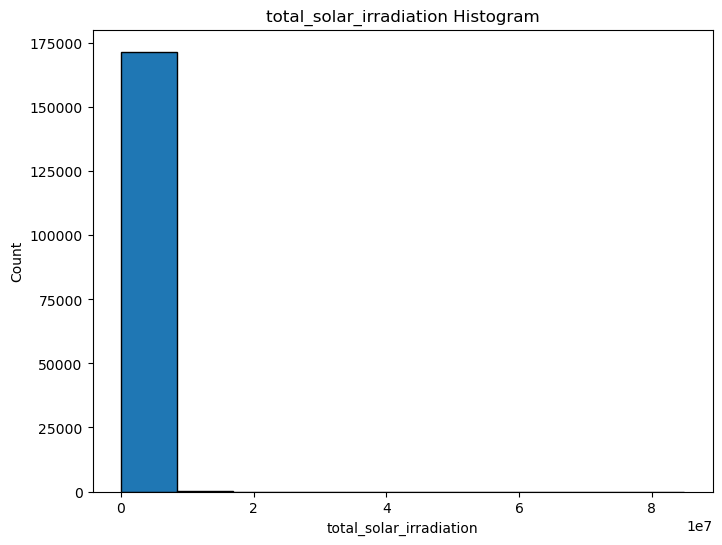

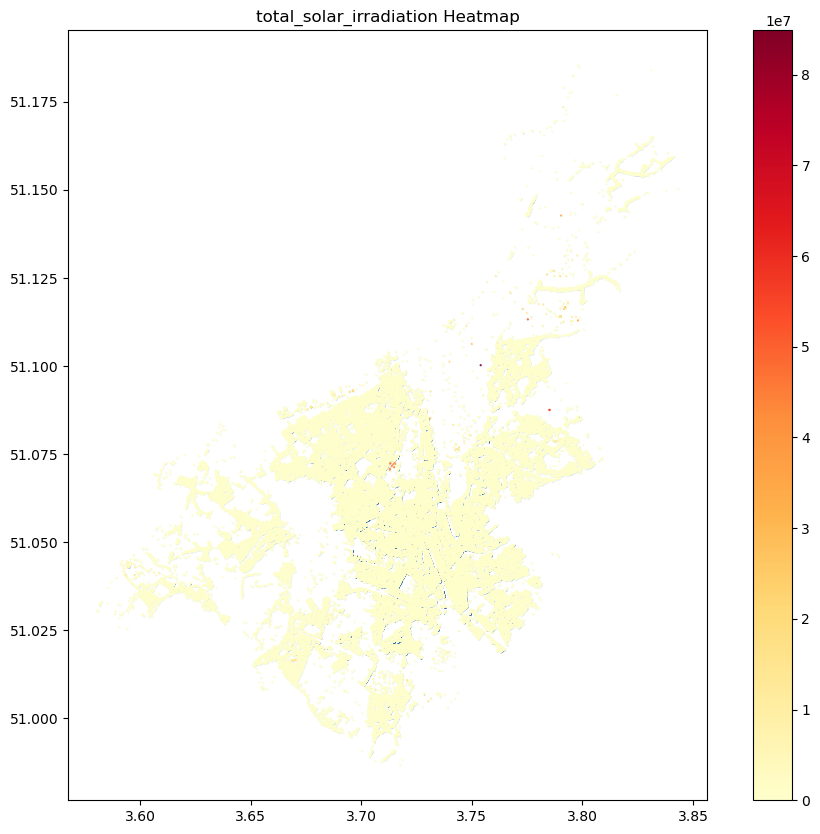

total_solar_irradiation Summary Statistics:
count    1.717030e+05
mean     9.550524e+04
std      6.337414e+05
min      0.000000e+00
25%      0.000000e+00
50%      1.705500e+04
75%      5.491400e+04
max      8.489058e+07
Name: total_solar_irradiation, dtype: float64
Frac Null Values: 0.0
**************************************************
roof_type Summary Statistics:
**************************************************



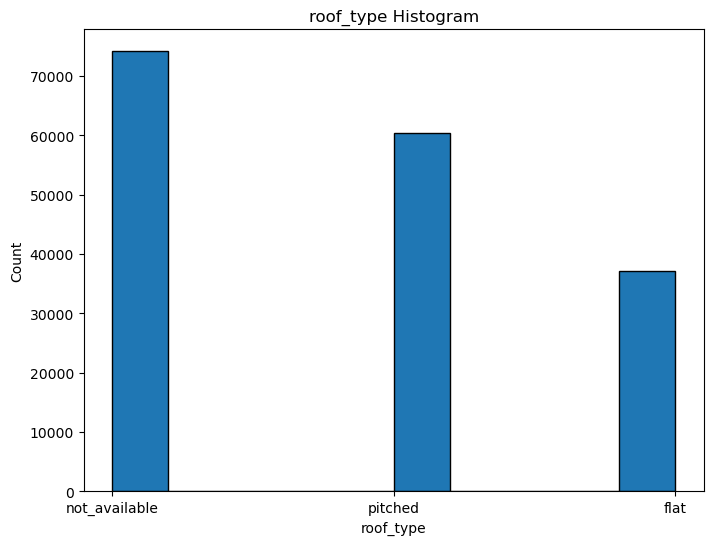

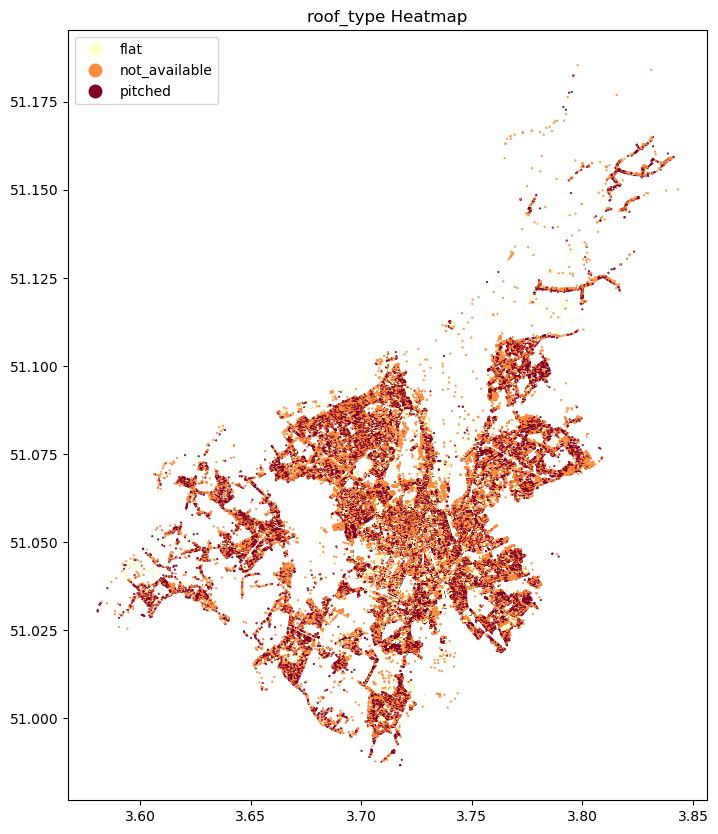

roof_type Summary Statistics:
count            171703
unique                3
top       not_available
freq              74144
Name: roof_type, dtype: object
Frac Null Values: 0.0
**************************************************
energy_production Summary Statistics:
**************************************************



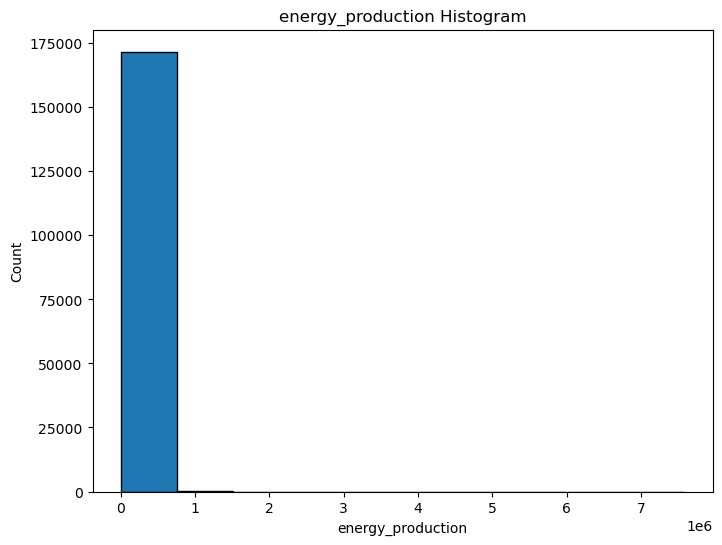

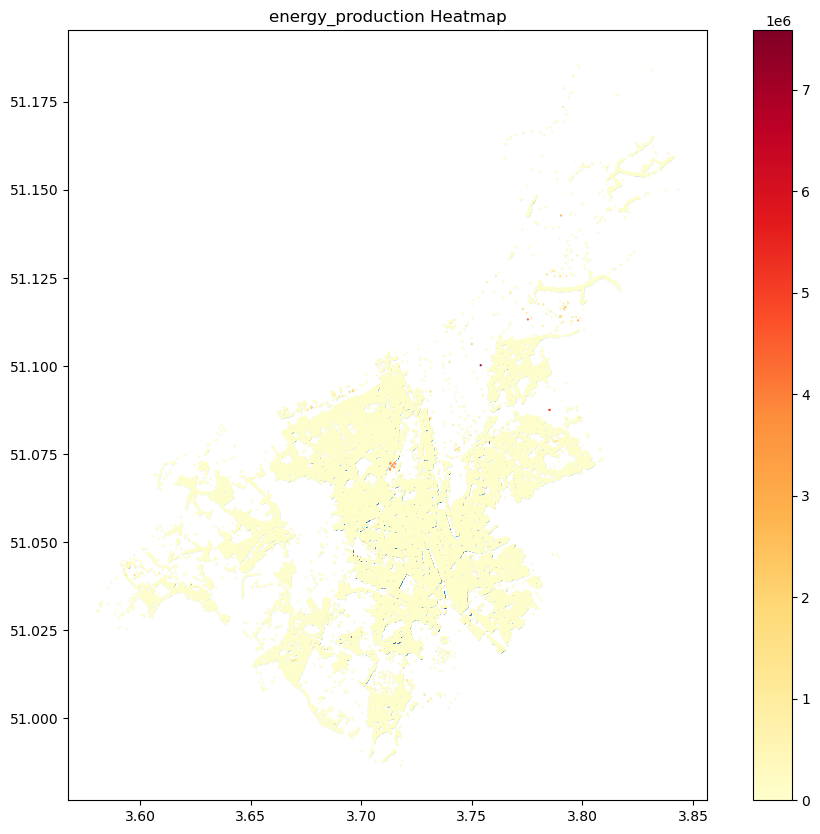

energy_production Summary Statistics:
count    1.717030e+05
mean     9.897417e+03
std      5.826980e+04
min      0.000000e+00
25%      0.000000e+00
50%      2.627000e+03
75%      7.190500e+03
max      7.584440e+06
Name: energy_production, dtype: float64
Frac Null Values: 0.0


In [ ]:
#solar features
 for column in solar_colums:
     plot_summary(df,column)

### Spatial optimisation
(did not run on the full dataset due to compute constraint)
<a name ='spatial_appendix'></a>

In [ ]:
import pygeoda
import geopandas
import time
from scipy.stats import zscore

In [ ]:
# reduce features using PCA
feature_set = ["BIMD2011_score", "avg_net_tax_income"]
# convert and scale features to converge faster
feature_gpd["coordinates_metres"] = feature_gpd["coordinates"].to_crs(epsg=3857)
feature_scaled = feature_gpd[["coordinates_metres"]].join(feature_gpd[feature_set].apply(zscore))
feature_scaled_gdf = geopandas.GeoDataFrame(feature_scaled, geometry="coordinates_metres", crs="EPSG:3857")
sample1 = feature_scaled_gdf.iloc[:16873,:]
sample1_features = sample1[feature_set]
sample1.head()

,coordinates_metres,BIMD2011_score,avg_net_tax_income
0,POINT (415042.787 6630484.294),-0.252016,1.010459
1,POINT (414974.428 6630740.254),-0.252016,1.010459
2,POINT (414974.428 6630740.254),-0.252016,1.010459
3,POINT (414974.428 6630740.254),-0.252016,1.010459
4,POINT (414815.432 6630749.910),-0.252016,1.010459


In [ ]:
# create pygeoda object
feature_gd = pygeoda.open(sample1)

# create queen weights
queen_w = pygeoda.queen_weights(feature_gd)

# selects and features to optimise
income_vals = sample1_features["avg_net_tax_income"]
income_min_bound = sample1_features["avg_net_tax_income"].median()*16873

# spatial optimisation with max-p algorithm
start = time.time()

maxp_clusters = pygeoda.maxp_greedy(queen_w,
                                    sample1_features,
                                    income_vals,
                                    income_min_bound)

end = time.time()
print(f"run time: {(end - start)/60} minutes")

In [ ]:
maxp_clusters

In [ ]:
sample1_clusters  = sample1.copy()
sample1_clusters['cluster'] = list(list(maxp_clusters.values())[4])
sample1_clusters.head(10)

In [ ]:
# check constraints
sample1_clusters.groupby('cluster')['avg_net_tax_income'].sum()

In [ ]:
sample1_clusters.groupby('cluster').count()

In [ ]:
# skater algorithm (crashed)
start = time.time()

skater_clusters = pygeoda.skater(10, queen_w, sample1_features) # 10 clusters
skater_clusters

end = time.time()
print(f"run time: {(end - start)/60} minutes")